# Content:
1. Neural Machine Translation (NMT) with Attention
2. Transformers
3. Transfer Learning (ELMo, GPT, BERT, T5)
4. Hugging Face

# Neural Machine Translation (NMT) with Attention

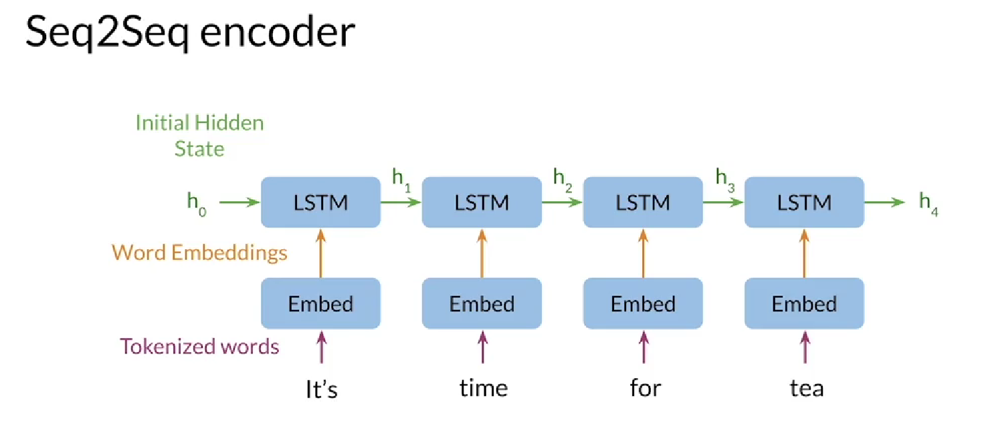

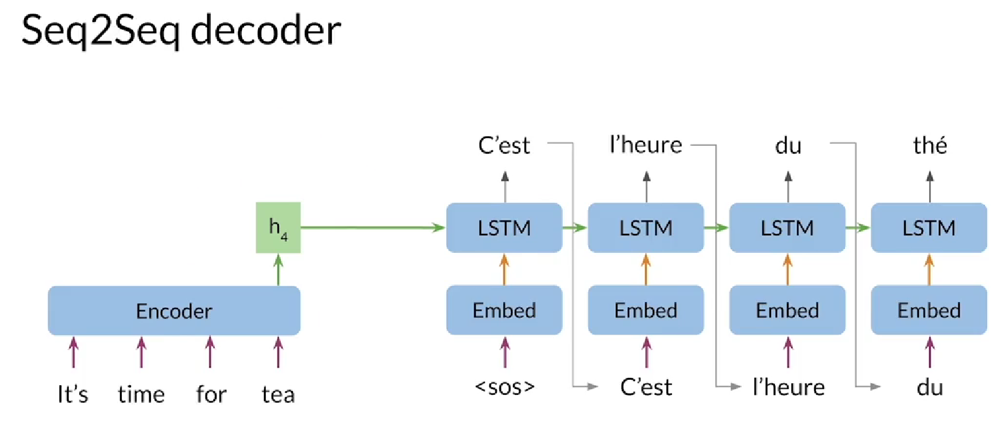

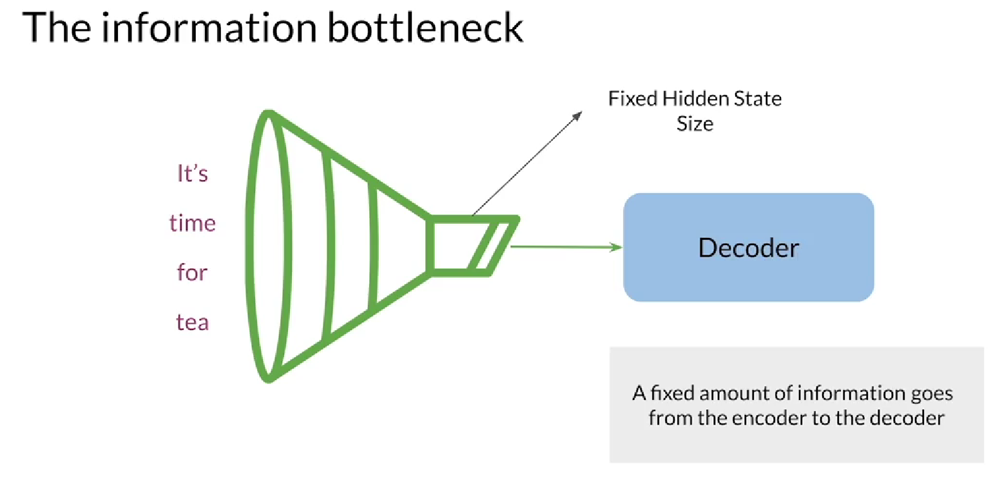

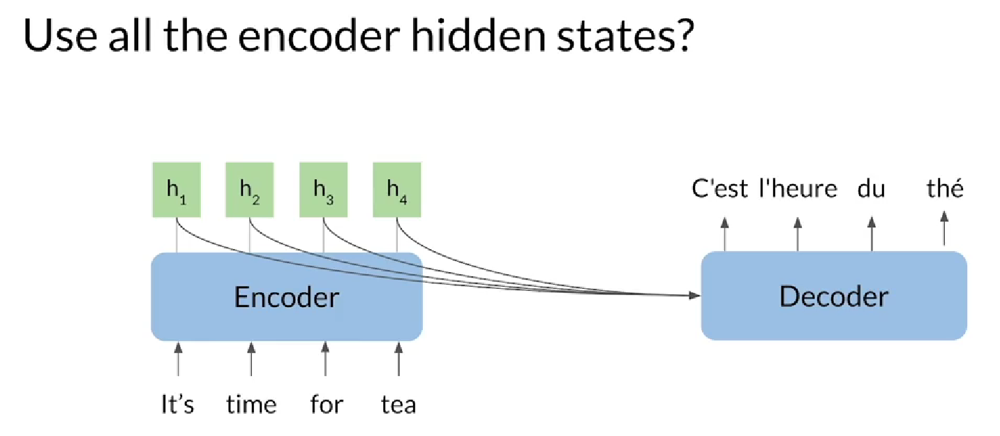

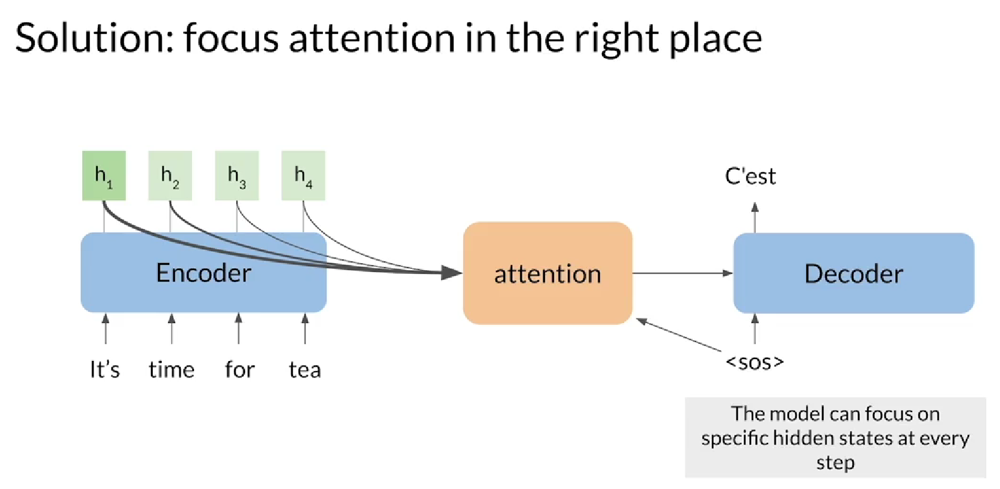

## Basic Attention

In [ ]:
def softmax(x, axis=0):
    """ Calculate softmax function for an array x along specified axis
    
        axis=0 calculates softmax across rows which means each column sums to 1 
        axis=1 calculates softmax across columns which means each row sums to 1
    """
    return np.exp(x) / np.expand_dims(np.sum(np.exp(x), axis=axis), axis)

def tanh(x):
    return (np.exp(x) - np.exp(-x)) / (np.exp(x) + np.exp(-x))


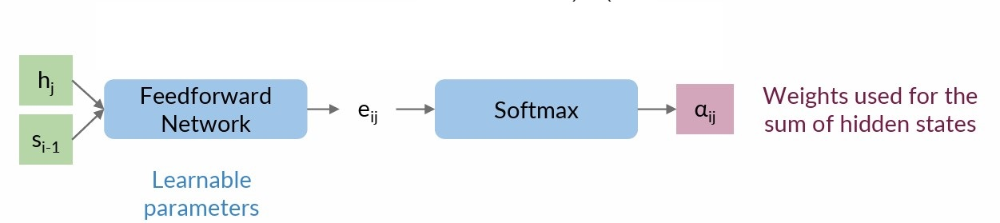

In [ ]:
hidden_size = 16
attention_size = 10
input_length = 5

np.random.seed(42)

# Synthetic vectors used to test
encoder_states = np.random.randn(input_length, hidden_size)
decoder_state = np.random.randn(1, hidden_size)

# Weights for the neural network, these are typically learned through training
# Use these in the alignment function below as the layer weights
layer_1 = np.random.randn(2 * hidden_size, attention_size)
layer_2 = np.random.randn(attention_size, 1)

# Calculating alignment scores
def alignment(encoder_states, decoder_state):
    # First, concatenate the encoder states and the decoder state
    inputs = np.concatenate((encoder_states, decoder_state.repeat(encoder_states.shape[0], axis=0)), axis=1)
    assert inputs.shape == (input_length, 2 * hidden_size)
    
    # Matrix multiplication of the concatenated inputs and layer_1, with tanh activation
    activations = tanh(np.dot(inputs, layer_1))
    assert activations.shape == (input_length, attention_size)
    
    # Matrix multiplication of the activations with layer_2. Remember that you don't need tanh here
    scores = np.dot(activations, layer_2)
    assert scores.shape == (input_length, 1)
    
    return scores

In [ ]:
# Turning alignment into weights + Weight the encoder output vectors and sum
def attention(encoder_states, decoder_state):
    """ Example function that calculates attention, returns the context vector 
    
        Arguments:
        encoder_vectors: NxM numpy array, where N is the number of vectors and M is the vector length
        decoder_vector: 1xM numpy array, M is the vector length, much be the same M as encoder_vectors
    """ 
    
    # First, calculate the alignment scores
    scores = alignment(encoder_states, decoder_state)
    
    # Then take the softmax of the alignment scores to get a weight distribution
    weights = softmax(scores)
    
    # Multiply each encoder state by its respective weight
    weighted_scores = encoder_states * weights.repeat(encoder_states.shape[1], axis=1)
    
    # Sum up weighted alignment vectors to get the context vector and return it
    context = np.sum(weighted_scores, axis=0)
    return context

context_vector = attention(encoder_states, decoder_state)
print(context_vector)

### The similarity between words is called **alignment**. 

The query and key vectors are used to calculate alignment scores that are measures of how well the query and keys match. These alignment scores are then turned into weights used for awaited, sum of the value vectors, this weighted sum of the value vectors is returned as the **attention vector**.

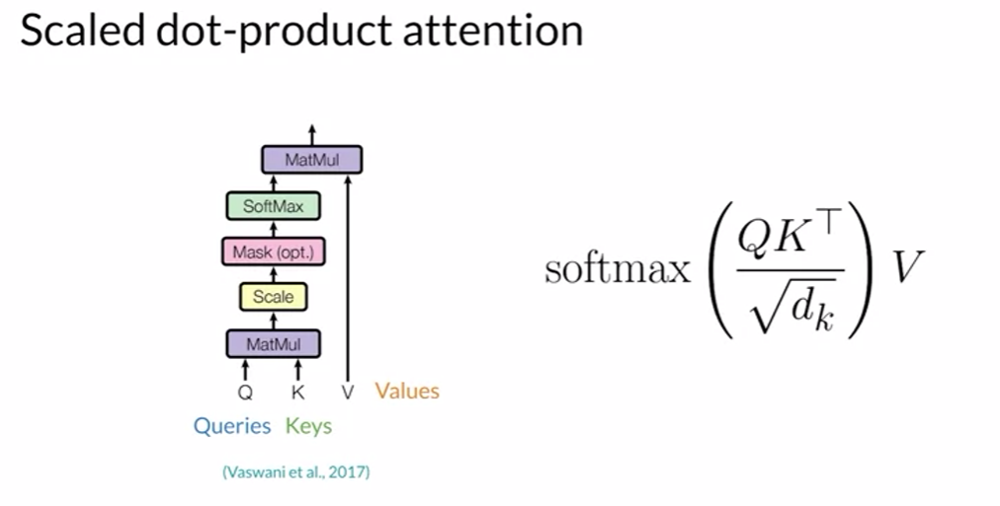

1. The queries and keys matrices are multiplied together to get a matrix of alignments course
2. These are then scaled by the square root of the key vector dimension, dk the scaling improves the model performance for larger model sizes and could be seen as a regularization constants.
3. Next the scale scores are converted to weights using the softmax function. Such that the weights for each query sum to one. 
4. Finally the weights and the value matrices are multiplied to get the attention vectors for each query, you can think of the keys and the values as being the same. So when you multiply the softmax output with V you are taking a linear combination of your initial input which is then being fed to the decoder. 

When the attention mechanism assigns a higher attention score to a certain word in the sequence - the next word in the decoder's output will be more strongly influenced by this word than by other words in the sequence.

## Scaled Dot-Product Attention (Queries, Keys, Values)

In [ ]:
# Load the word2int dictionaries
with open("./input_data/word2int_en.pkl", "rb") as f:
    en_words = pickle.load(f)
    
with open("./input_data/word2int_fr.pkl", "rb") as f:
    fr_words = pickle.load(f)

# Load the word embeddings
en_embeddings = np.load("./input_data/embeddings_en.npz")["embeddings"]
fr_embeddings = np.load("./input_data/embeddings_fr.npz")["embeddings"]

In [ ]:
def tokenize(sentence, token_mapping):
    tokenized = []
    
    for word in sentence.lower().split(" "):
        try:
            tokenized.append(token_mapping[word])
        except KeyError:
            # Using -1 to indicate an unknown word
            tokenized.append(-1)
        
    return tokenized


def embed(tokens, embeddings):
    embed_size = embeddings.shape[1]
    
    output = np.zeros((len(tokens), embed_size))
    for i, token in enumerate(tokens):
        if token == -1:
            output[i] = np.zeros((1, embed_size))
        else:
            output[i] = embeddings[token]
            
    return output

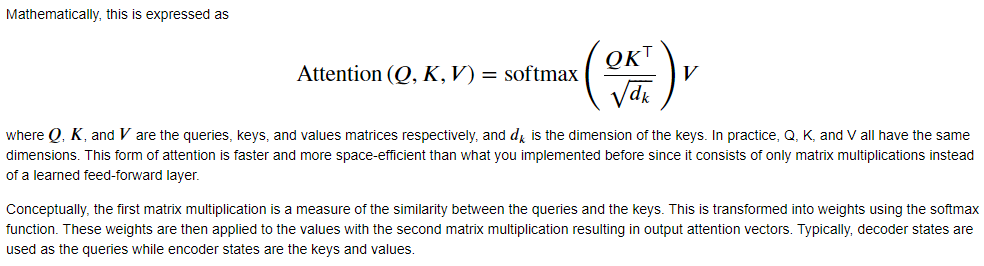

In [ ]:
def softmax(x, axis=0):    
    """ Calculate softmax function for an array x

        axis=0 calculates softmax across rows which means each column sums to 1 
        axis=1 calculates softmax across columns which means each row sums to 1
    """
    return np.exp(x) / np.expand_dims(np.sum(np.exp(x), axis=axis), axis=axis)

def calculate_weights(queries, keys):
    """ Calculate the weights for scaled dot-product attention"""
    dot = np.matmul(queries, keys.T) / np.sqrt(keys.shape[1])
    weights = softmax(dot, axis=1)
    
    assert weights.sum(axis=1)[0] == 1, "Each row in weights must sum to 1"
    
    return weights

In [ ]:
# Tokenize example sentences in English and French, then get their embeddings
sentence_en = "The agreement on the European Economic Area was signed in August 1992 ."
tokenized_en = tokenize(sentence_en, en_words)
embedded_en = embed(tokenized_en, en_embeddings)

sentence_fr = "L accord sur la zone économique européenne a été signé en août 1992 ."
tokenized_fr = tokenize(sentence_fr, fr_words)
embedded_fr = embed(tokenized_fr, fr_embeddings)

# These weights indicate alignment between words in English and French
alignment = calculate_weights(embedded_fr, embedded_en)

# Visualize weights to check for alignment
fig, ax = plt.subplots(figsize=(7,7))
ax.imshow(alignment, cmap='gray')
ax.xaxis.tick_top()
ax.set_xticks(np.arange(alignment.shape[1]))
ax.set_xticklabels(sentence_en.split(" "), rotation=90, size=16);
ax.set_yticks(np.arange(alignment.shape[0]));
ax.set_yticklabels(sentence_fr.split(" "), size=16);

In [ ]:
def attention_qkv(queries, keys, values):
    """ Calculate scaled dot-product attention from queries, keys, and values matrices """
    
    # Replace pass with your code.
    return np.matmul(calculate_weights(queries, keys), values)


attention_qkv_result = attention_qkv(embedded_fr, embedded_en, embedded_en)

print(f"The shape of the attention_qkv function is {attention_qkv_result.shape}")
print(f"Some elements of the attention_qkv function are \n{attention_qkv_result[0:2,:10]}")

## Teacher Forcing

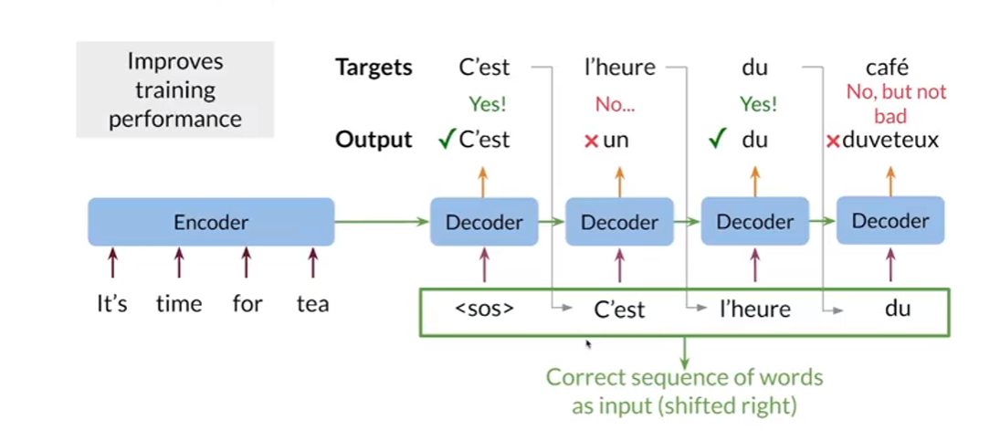

## Neural Machine Translation

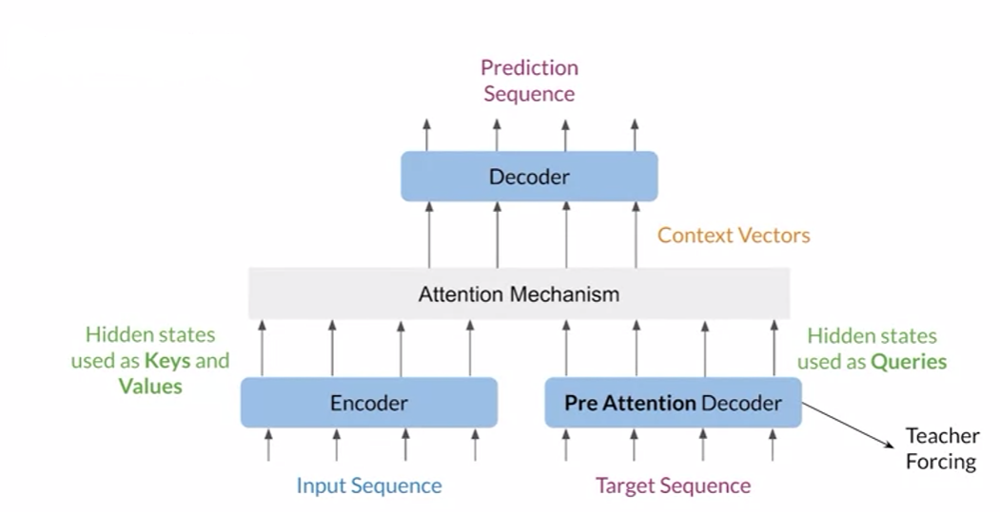

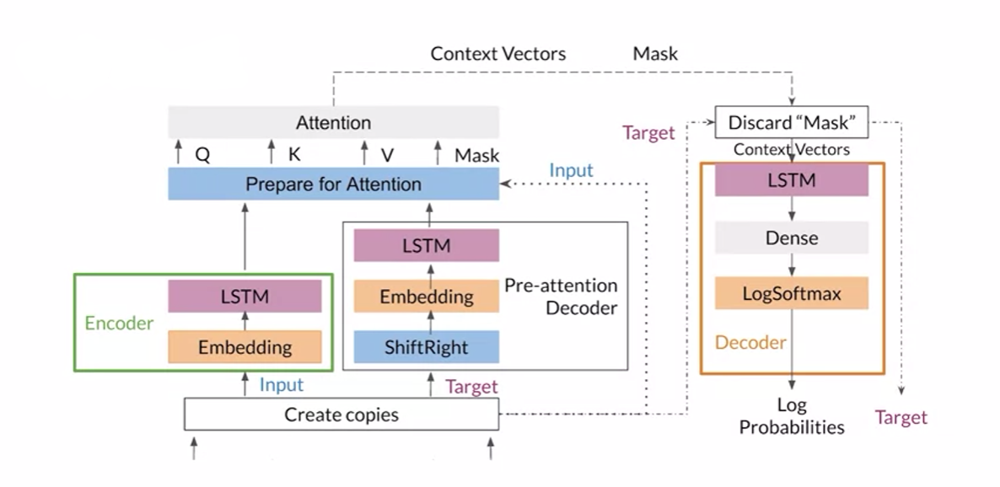

1. The initial step is to make two copies of the input tokens and the target tokens because you will need them in different places of the model. 
2. One copy of the input tokens is fed into the encoder, which is used to transform them into the key and value vectors, 
3. while a copy of the target tokens goes into the pre-attention decoder. Note that the computations done in the encoder and pre-attention decoder could be done in parallel, since they don't depend on each other. Within the pre-attention decoder, you shift each sequence to the right and add a start of sentence token. 
* In the encoder and pre-attention decoder, the inputs and targets go through an embedding layer before going to LSTMs. 
4. After getting the query key and value vectors, you have to prepare them for the attention layer. You'll use a function to help you get a padding mask to help the attention layer determine the padding tokens. This step is where you will use the copy of the input tokens. 
5. Now, everything is ready for attention. You pass the queries, keys, values, and the mask to the attention layer that outputs the context vector and the mask. 
6. Before going through the decoder, you drop the mask. You then pass the context vectors through the decoder composed of an LSTM, a dense layer, and a LogSoftmax. 
7. In the end, your model returns log probabilities and the copy of the target tokens that you made at the beginning. 

There you have it, the model you'll be building and the intuition behind all the steps. 

## Bilingual Evaluation Understudy (BLEU) Score

The BLEU score, a bilingual evaluation understudy, is an algorithm designed to evaluate some of the most challenging problems in NLP, including machine translation. It evaluates the quality of machine-translated text by comparing a candidate translation to one or more references, which are often human translations. 

The closer the BLEU score is to 1, the better your model is, the closer to 0, the worse it is. 

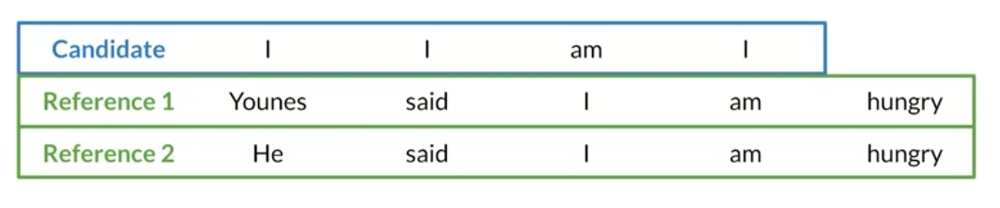

To get the BLEU score, you count how many words from the candidate appear in any of the references and divide that count by the total number of words in the candidate translation. You can view it as a precision metric. You have to go through all the words in the candidate translation.

1. First, you have the word I, which appears in both reference translations. You add one to your count. 
2. Then you have again the word I, which you already know appears on both references, and you add one to your count. 
3. After that, you have the word am which also appears in both references. You add that word to your count. 
4. At the end, you have the word I again, which appears on both references. You can add one to your count. 
5. Finally, you can get the BLEU score by dividing your count by the number of words in the candidate translation, which in this case is equal to 4. The whole process gives you a BLEU score equal to 1. 

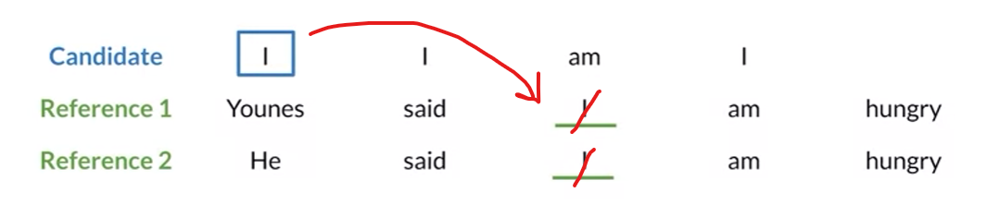

For the **modified version of the BLEU score**, after you find a word from the candidates in one or more of the references, you stop considering that word from the reference for the following words in the candidates. In other words, you exhaust the words in the references after you match them with a word in the candidates. Let's start from the beginning of the candidate translation. 

1. You have the word I that appears in both references. You add one to your count and exhaust the word I from both references. 
2. Then you have the word I again, but you don't have that word in the references because it was taken out for the previous word in the candidate. You don't add anything to your count. 
3. Then you have the word AM, which appears in both references. You add one to your counts and eliminate the word M from both references. 
4. After that, you have the word I again, but no left occurrences in the references. You don't add anything to your counts. 
5. Finally, you divide your count by the number of words in the candidate translation to get BLEU score of 2/4 or 0.5. 

As you can note, this version of the BLEU score makes more sense than the vanilla implementation. However, like anything in life, using the BLEU score as an evaluation metric has some caveats. For one, it doesn't consider the semantic meaning of the words. It also doesn't consider the structure of the sentence. Imagine getting this translation. Ate I was hungry because. If the reference sentence is I ate because I was hungry, this would get a perfect BLEU score. BLEU score is the most widely adopted evaluation metric for machine translation. But you should be aware of these drawbacks before using it. 

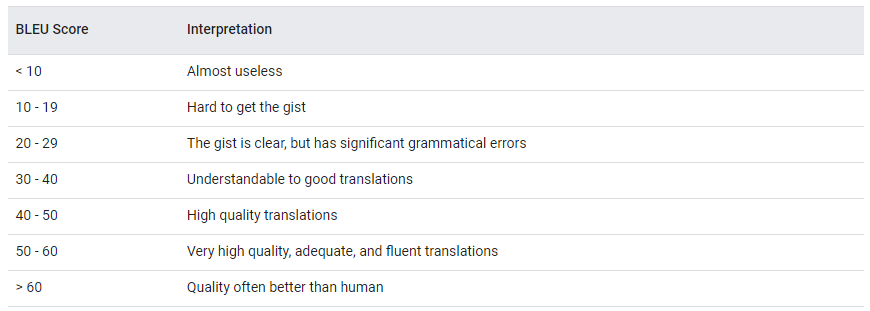

In [ ]:
import numpy as np                  # import numpy to make numerical computations.
import nltk                         # import NLTK to handle simple NL tasks like tokenization.
nltk.download("punkt")
from nltk.util import ngrams
from collections import Counter     # import a counter.
!pip3 install 'sacrebleu'           # install the sacrebleu package.
import sacrebleu                    # import sacrebleu in order compute the BLEU score.
import matplotlib.pyplot as plt     # import pyplot in order to make some illustrations.

### Brevity Penalty:
The brevity penalty penalizes generated translations that are shorter than the reference sentence. It compensates for the fact that the BLEU score has no recall term.

In [ ]:
reference_length = 1
candidate_length = np.linspace(1.5, 0.5, 100)

length_ratio = reference_length / candidate_length
BP = np.minimum(1, np.exp(1 - length_ratio))

# Plot the data
fig, ax = plt.subplots(1)
lines = ax.plot(length_ratio, BP)
ax.set(
    xlabel="Ratio of the length of the reference to the candidate text",
    ylabel="Brevity Penalty",
)
plt.show()

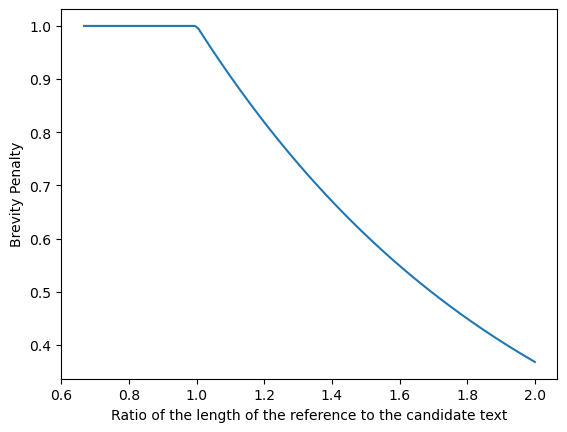

### N-Gram Precision:
The n-gram precision counts how many n-grams (in your case unigrams, bigrams, trigrams, and four-grams for i =1 , ... , 4) match their n-gram counterpart in the reference translations. This term acts as a precision metric. Unigrams account for adequacy while longer n-grams account for fluency of the translation. To avoid overcounting, the n-gram counts are clipped to the maximal n-gram count occurring in the reference. Typically precision shows exponential decay with the degree of the n-gram.

In [ ]:
# Mocked dataset showing the precision for different n-grams
data = {"1-gram": 0.8, "2-gram": 0.7, "3-gram": 0.6, "4-gram": 0.5}

# Plot the datapoints defined above
fig, ax = plt.subplots(1)
bars = ax.bar(*zip(*data.items()))
ax.set(ylabel="N-gram precision")
plt.show()

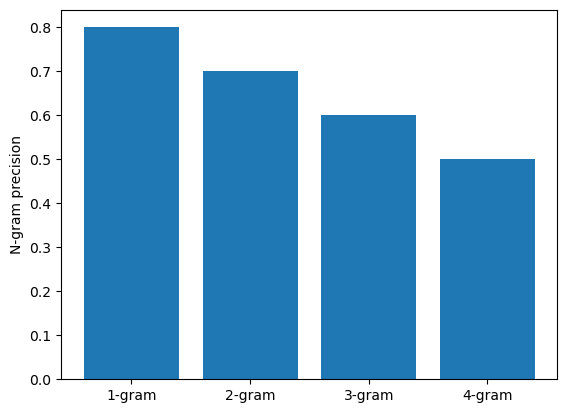

### N-gram BLEU score:
When the n-gram precision is normalized by the brevity penalty (BP), then the exponential decay of n-grams is almost fully compensated. The BLEU score corresponds to a geometric average of this modified n-gram precision.

In [ ]:
# Mocked dataset showing the precision multiplied by the BP for different n-grams
data = {"1-gram": 0.8, "2-gram": 0.77, "3-gram": 0.74, "4-gram": 0.71}

# Plot the datapoints defined above
fig, ax = plt.subplots(1)
bars = ax.bar(*zip(*data.items()))
ax.set(ylabel="Modified N-gram precision")
plt.show()

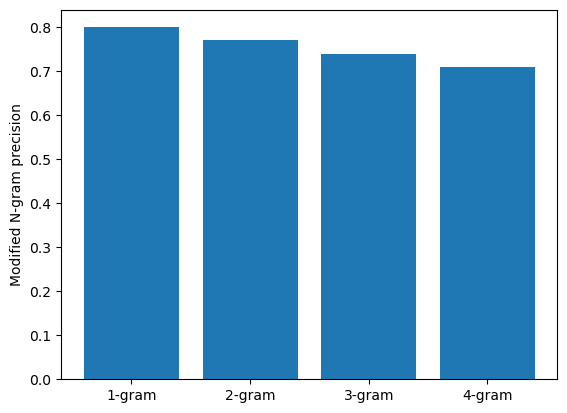

### Calculations of the BLEU score

In [ ]:
# Define and tokenize the sentences

reference = "The NASA Opportunity rover is battling a massive dust storm on planet Mars."
candidate_1 = "The Opportunity rover is combating a big sandstorm on planet Mars."
candidate_2 = "A NASA rover is fighting a massive storm on planet Mars."

tokenized_ref = nltk.word_tokenize(reference.lower())
tokenized_cand_1 = nltk.word_tokenize(candidate_1.lower())
tokenized_cand_2 = nltk.word_tokenize(candidate_2.lower())

print(f"{reference} -> {tokenized_ref}")
print("\n")
print(f"{candidate_1} -> {tokenized_cand_1}")
print("\n")
print(f"{candidate_2} -> {tokenized_cand_2}")

In [ ]:
# Computing the Brevity Penalty

def brevity_penalty(candidate, reference):
    """
    Calculates the brevity penalty given the candidate and reference sentences.
    """
    reference_length = len(reference)
    candidate_length = len(candidate)

    if reference_length < candidate_length:
        BP = 1
    else:
        penalty = 1 - (reference_length / candidate_length)
        BP = np.exp(penalty)

    return BP

In [ ]:
# Computing the clipped Precision

def average_clipped_precision(candidate, reference):
    """
    Calculates the precision given the candidate and reference sentences.

    The function calculates how many of the n-grams in the candidate sentence actually appear in the reference sentence. 
    The clipping takes care of overcounting. For example if a certain n-gram appears five times in the candidate sentence, 
    but only twice in the reference, the value is clipped to two.
    """

    clipped_precision_score = []
    
    # Loop through values 1, 2, 3, 4. This is the length of n-grams
    for n_gram_length in range(1, 5):
        reference_n_gram_counts = Counter(ngrams(reference, n_gram_length))        
        candidate_n_gram_counts = Counter(ngrams(candidate, n_gram_length))                

        total_candidate_ngrams = sum(candidate_n_gram_counts.values())       
        
        for ngram in candidate_n_gram_counts: 
            # check if it is in the reference n-gram
            if ngram in reference_n_gram_counts:
                # if the count of the candidate n-gram is bigger than the corresponding
                # count in the reference n-gram, then set the count of the candidate n-gram 
                # to be equal to the reference n-gram
                
                if candidate_n_gram_counts[ngram] > reference_n_gram_counts[ngram]: 
                    candidate_n_gram_counts[ngram] = reference_n_gram_counts[ngram] # t
                                                   
            else:
                candidate_n_gram_counts[ngram] = 0 # else set the candidate n-gram equal to zero

        clipped_candidate_ngrams = sum(candidate_n_gram_counts.values())
        
        clipped_precision_score.append(clipped_candidate_ngrams / total_candidate_ngrams)
    
    # Calculate the geometric average: take the mean of elemntwise log, then exponentiate
    # This is equivalent to taking the n-th root of the product as shown in equation (1) above
    s = np.exp(np.mean(np.log(clipped_precision_score)))
    
    return s


In [ ]:
# Computing the BLEU score

def bleu_score(candidate, reference):
    BP = brevity_penalty(candidate, reference)    
    geometric_average_precision = average_clipped_precision(candidate, reference)    
    return BP * geometric_average_precision

In [ ]:
# Testing the functions

result_candidate_1 = round(bleu_score(tokenized_cand_1, tokenized_ref) * 100, 1)
print(f"BLEU score of reference versus candidate 1: {result_candidate_1}")
result_candidate_2 = round(bleu_score(tokenized_cand_2, tokenized_ref) * 100, 1)
print(f"BLEU score of reference versus candidate 2: {result_candidate_2}")

# the same calculation, but using the sacrebleu library. Compare them with your implementation above.

# result_candidate_1 = round(sacrebleu.sentence_bleu(candidate_1, [reference]).score, 1)
# print(f"BLEU score of reference versus candidate 1: {result_candidate_1}")
# result_candidate_2 = round(sacrebleu.sentence_bleu(candidate_2, [reference]).score, 1)
# print(f"BLEU score of reference versus candidate 2: {result_candidate_2}")

## Recall-Oriented Understudy for Gisting Evaluation (ROUGE-N) Score

Performance metric that tends to estimate the quality of machine translation systems. 

It's more recall-oriented by default. That means that ROUGE cares about how much of the human created references appear in the candidate translation. In contrast, BLEU is precision oriented. Since you have to determine how many words from the candidates appear on the references. 

ROUGE was initially developed to evaluate the quality of the machine summarized texts, but is also helpful in assessing the quality of machine translation. It works by comparing the machine candidates against reference translations provided by humans. There are many versions of the ROUGE score, but also the one called ROUGE-N. For the ROUGE-N score, You have to get the counts of the n-gram overlaps between the candidates and the reference translations, which is somewhat similar to what you have to do for the BLEU score. 


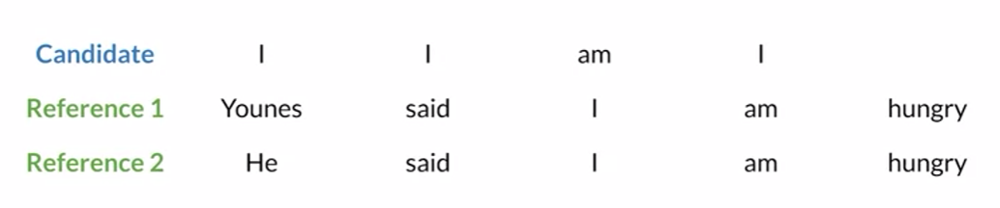

How ROUGE-N works with uni-grams. To get the basic version of the ROUGE-N score based only on recall so you must count word matches between the reference and the candidates, and divide by the number of words in the reference. If you had multiple references, you would need to get a ROUGE-N score using each reference and get the maximum. 

* Your candidate has the words I two times, the word AM, and the word I again, for a total of four words. 

* You also have a reference translation. "Younes said I am hungry" and another slightly different reference. "He said I am hungry." Each reference has five words in total. You have to count matches between the references and the candidate translations, similar to what you did for the BLEU score. 



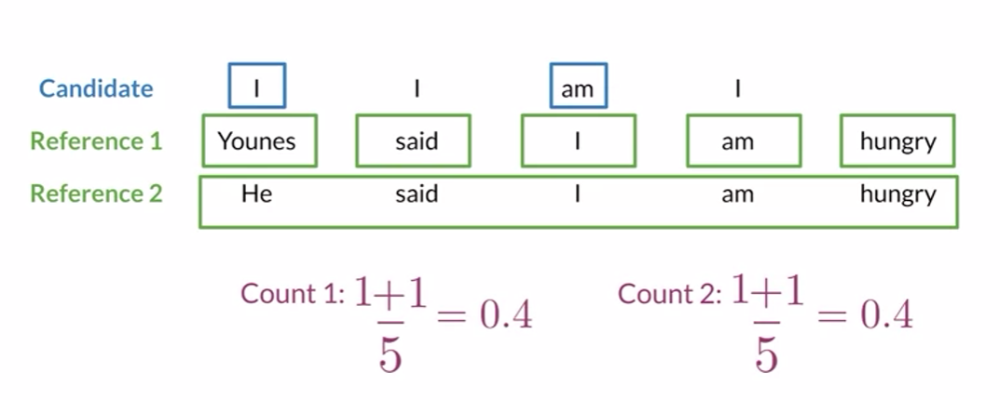

0. Let's start with the first reference. 
1. The word Younes, doesn't match any of the uni-grams in the candidates, so you don't add anything to the counts. 
2. The word said doesn't match any word and the candidates either. 
3. The word I, has multiple matches, but you need the first one. For this match, you add only one to your counts. 
4. The word AM has a match in the candidates so your increment your counts. 
5. Now, the final word of the first reference, hungry, doesn't match any of the words from the candidates. You don't add anything to your counts. 
6. If you repeat this process for the second reference, you get a counts equal to 2. 
7. Finally, you divide these counts by the number of words in each reference and get the maximum value, which for this example is equal to 0.4. 

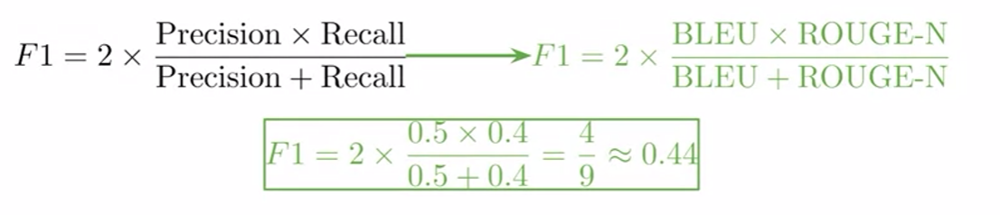

This basic version of the ROUGE-N score is based on recall while the BLEU score you saw in the previous lectures is precision. But why not combine both to get a metric like an F1 score. You can use an F1 score that's could better assess the performance of your machine translation model. However, you must note that's all the evaluation metrics you have seen so far, don't consider the sentence structure and semantics, only accounts for matching n-grams between candidates and the reference translations. 

## Sampling and Decoding

Two ways that will allow you to construct a sentence. 
* greedy decoding 
* random sampling 

### *First, a quick reminder on how a seq2seq model predicts words. The output of the decoder is produced from a dense layer and a softmax or log softmax operation. The output at each step then is the probability distribution over all the words and symbols in the target vocabulary. The final output of the model depends on how you choose the words using these probability distributions at each step.*

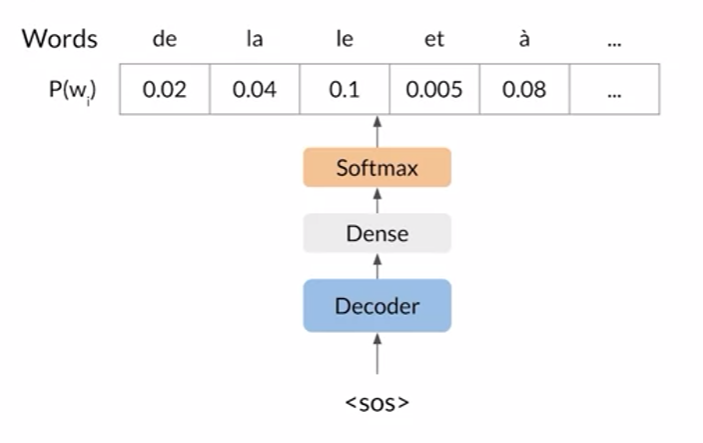

**Greedy decoding** is the simplest way to decode the model's predictions as it selects the most probable word at every step. However, this approach has limitations. When you consider the highest probability for each prediction and concatenate all predicted tokens for the output sequence. As the greedy decoder does, you can end up with a situation where the output instead of, "I am hungry," gives you "I am, am, am" and so forth. You can see how this could be a problem, but not in all cases. For shorter sequences, it's going to be fine. But if you have many other words to consider, then knowing what's coming up next might help you better predict the next sequence. 

Another option is known as **random sampling**. What random sampling does is it provides probabilities for each word and sample accordingly for the next outputs. One of the problems with this is that it could be a little bit too random. A solution for this is to assign more weight to the words with higher probabilities and less weight to the others. You will see a method for doing this in just a few moment. 

In sampling, **temperature** is a parameter you can adjust to allow for more or less randomness in your predictions. It's measured on a scale of 0-1, indicating low to high randomness. 
* Let's say you need your model to make careful, safe decisions about what to output. Then set you're parameter lower and get the prediction equivalent of a very confident but rather a boring person seated next to you at a dinner table. 
* If you feel like taking more of a gamble, set your temperature a bit higher. This has the effect of making your network more excited. You may get some pretty fun predictions. On the other hand, there will be probably a lot more mistakes.

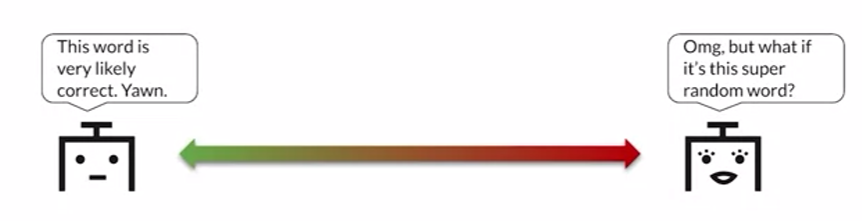

## Beam Search

**Beam search** is a technique that allows you to find the best sequences over a fixed window size known as the beam with. Since taking the output with the highest probability at each time step is not ideal. 

This method attempts to find the most likely outsports sentence by choosing some number of best sequences based on conditional probabilities at each time step.

Now at each time step with beam search you have to calculate the probability of potential sequences given the outputs of the previous time step.

To avoid computing the probability for every possible sequence you have armature B called the beam width. At each step, you only keep the most probable sequences and drop all others. You generate a new word until all B most probable sentences and with the < EOS > token. So beam search consumes a lot of memory and could be computationally costly depending on your choice for beam. 

### *As an interesting side note, greedy decoding is just a particular case of beam search where you set the beam with B to be equal to 1.*

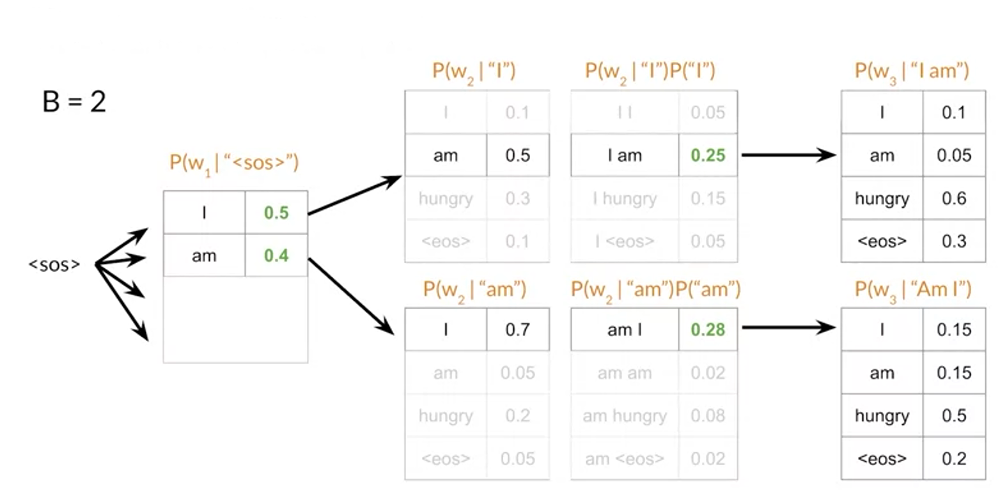

To illustrate this method, consider a small vocabulary consisting of the words I am hungry and an end of sentence token. And let's say the beam with B is equal to 2. As with the other methods beam search starts with the start of sentence token and gets the probabilities for the first word in the sequence. Here I has a probability of 0.5, am has a probability of 0.4 and hungry has a probability of 0.1 and in the eos is at 0. Since the beam with is 2 you keep the two highest probabilities I and am. Then you calculate the conditional probability of all other words Given the two sequences that you have kept so far I and am. Given the word I, the model returns am with a probability of 0.5 and hungry with 0.3. Given the words am, the model returns the probability of word I with a probability of 0.7 and hungry with a probability of 0.2. These are the two conditional probabilities given the two previous sequences of B of word 2 given word 1. Next you calculate the probability by multiplying the conditional probability for 2 given the word I with the probability of words I. For instance if the sequence of II has a probability of 0.5 times 0.1 this is equal to 0.05. The sequence I am has a probability of 0.5 times 0.5 which is equal to 0.25.

You have to do the same with the sequences starting with the word am. Here the sequence MI has a probability of 0.4 times 0.7 which is equal to 0.28. At this point there is possible sequences but with the beam width B=2 you only keep the two sequences with the highest probabilities. So you keep the sequence I am and am I and drop all others.

Then for the next step you use am as the inputs were to get the conditional probabilities for the I am sequence and I for the am I sequence. You repeat the process to calculate the joints probabilities and again choose the best sequence. This process stops with the model predicts an end of sentence token for all, be most probable sequences. At the end, the sequence with the largest probability is chosen as the outputs. 

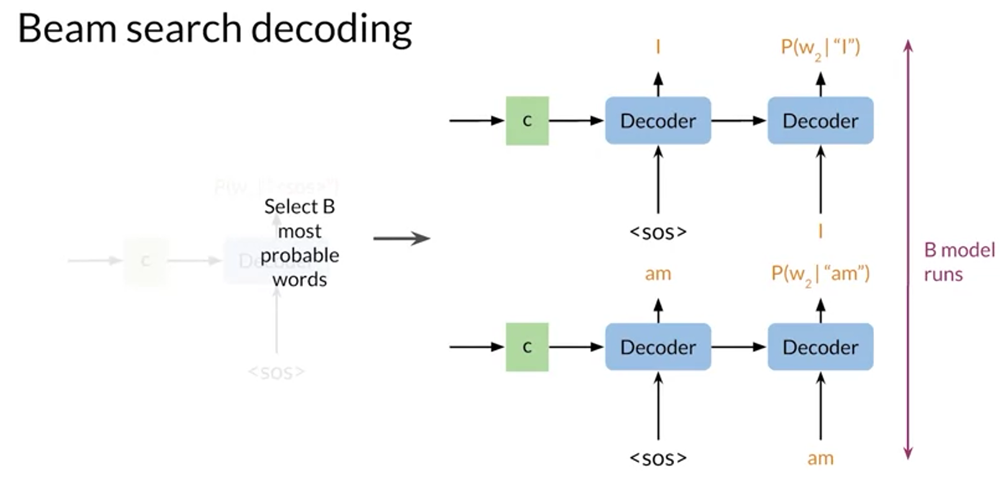

To get the conditional probabilities at each step you have to use your model. For now let's focus on the decoder parts of the model ignoring the encoder and attention mechanism. At the start of the sequence you will use your decoder to as a vector of probabilities for each of the words and the vocabulary. This is equivalent to computing the conditional probability of every word given the start of sequence token. Then you select the most probable B outputs from the model and discard all other possibilities. After that you use your model B times to find the conditional probabilities of all the words in the vocabulary given the sequences that you kept in the previous step. Then you compute the sequence probability and keep the B most probable sequences. And you keep doing this until the B most probable sequences gets to the end of the sequence token. Notes that at each step after the one where your sequence is only composed by the SOS token you have to run your model B times. 

The vanilla version of beam search has some disadvantages. For instance, it penalizes the choice of long wear sequences because the probability of a sequence is computed as the product of multiple conditional probabilities. However, you could normalize the probability of each sequence by its number four is to avoid this problem. Beam search also requires you to store the b most probable sequences and computes conditional probabilities given all of those sequences. Therefore, this method could be computationally expensive and consumes lots of memory. 

## Minimum Bayes Risk

It is very simple and works surprisingly well when compared to the other techniques, let's get started. Earlier, you encountered random sampling to choose a probable token and the issues with that decoding method. 
1. But if you go a little further with that, say by generating 30 samples and comparing them all against one another. You'll see quite a bit of improvements in your decoding. You'll have to compare multiple candidate translations for the minimum bayes risk decoding method, MBR for shorts. Implementing MBR is pretty straightforward. 
2. Begin by generating several random samples, then compare each sample against each other using a similarity score or a loss function. ROUGE would be a good choice that you may recall from a bit earlier.
3. Finally, choose the sample with the highest average similarity or the lowest loss. The translation that you get using this method is the closest to all candidate translations. This process can be viewed as some authors suggest, as finding a consensus between all candidate translations. 

If you decide to use ROUGE score as a similarity metric for comparing every pair of candidate translations, you would have MBR summarized in the formula presented here:

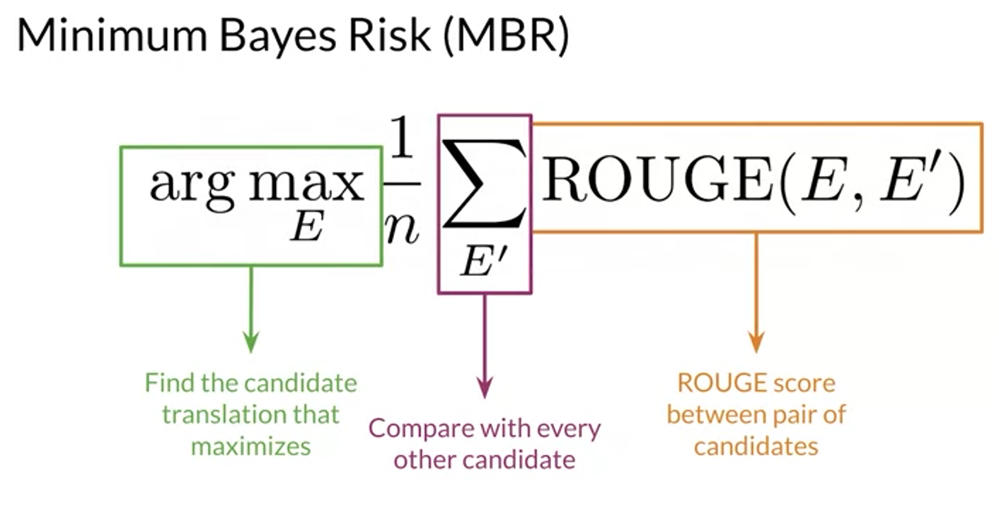


Your goal is to find the candidate translation E that maximizes the average ROUGE score with every other candidates E prime. So MBR is relatively easy to implement. You need to have multiple candidate translations and select a way to compare them. 

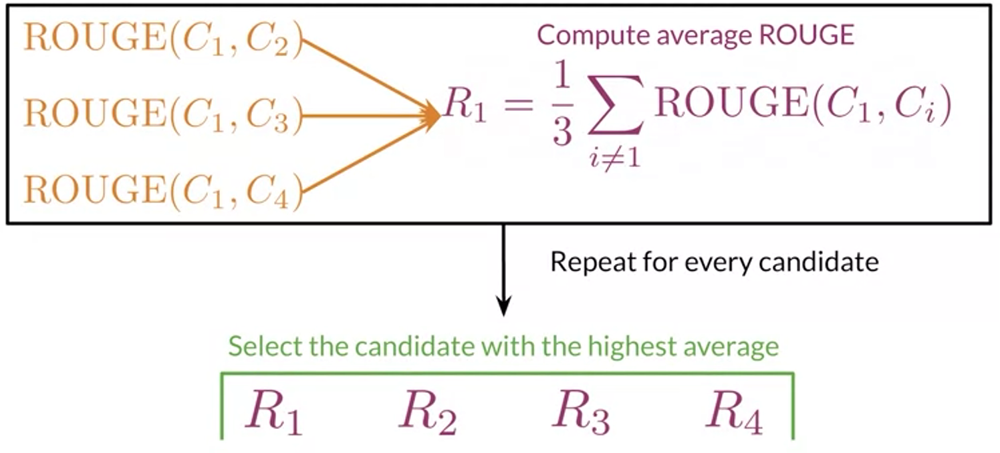

An implementation process in more detail. Here are the steps for implementing MVR with ROUGE on a small set of four candidate translations. 
1. First, calculate the ROUGE score between the first C subscript 1 and the second C subscript 2 candidate translations. 
2. For the 1st and 3rd and for the 1st and 4th, then compute the average R subscript 1 using those three rules scores. 
3. Then you repeat this process for the other three candidates in your sets to average ROUGE scores for each one of them. 
4. Finally, you select the candidate with the highest average ROUGE score and that's it for MBR. 

In summary, MBR:
* takes several translation candidates and compares them against each other
* chooses the one with the highest average similarity as the beam search case
* this method can give you a more contextually accurate translation than random sampling and greedy decoding

# NMT with Attention (implementation)

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' # Setting this env variable prevents TF warnings from showing up

import numpy as np
import tensorflow as tf
from collections import Counter
from utils3 import (sentences, train_data, val_data, english_vectorizer, portuguese_vectorizer, 
                   masked_loss, masked_acc, tokens_to_text)

### Data Preparation
The text pre-processing bits have already been taken care of (if you are interested in this be sure to check the utils.py file). The steps performed can be summarized as:

* Reading the raw data from the text files
* Cleaning the data (using lowercase, adding space around punctuation, trimming whitespaces, etc)
* Splitting it into training and validation sets
* Adding the start-of-sentence and end-of-sentence tokens to every sentence
* Tokenizing the sentences
* Creating a Tensorflow dataset out of the tokenized sentences

In [ ]:
portuguese_sentences, english_sentences = sentences

print(f"English (to translate) sentence:\n\n{english_sentences[-5]}\n")
print(f"Portuguese (translation) sentence:\n\n{portuguese_sentences[-5]}")

# Size of the vocabulary
vocab_size_por = portuguese_vectorizer.vocabulary_size()
vocab_size_eng = english_vectorizer.vocabulary_size()

print(f"Portuguese vocabulary is made up of {vocab_size_por} words")
print(f"English vocabulary is made up of {vocab_size_eng} words")

In [ ]:
# This helps you convert from words to ids
word_to_id = tf.keras.layers.StringLookup(
    vocabulary=portuguese_vectorizer.get_vocabulary(), 
    mask_token="", 
    oov_token="[UNK]"
)

# This helps you convert from ids to words
id_to_word = tf.keras.layers.StringLookup(
    vocabulary=portuguese_vectorizer.get_vocabulary(),
    mask_token="",
    oov_token="[UNK]",
    invert=True,
)

In [ ]:
unk_id = word_to_id("[UNK]")
sos_id = word_to_id("[SOS]")
eos_id = word_to_id("[EOS]")
baunilha_id = word_to_id("baunilha")

print(f"The id for the [UNK] token is {unk_id}")
print(f"The id for the [SOS] token is {sos_id}")
print(f"The id for the [EOS] token is {eos_id}")
print(f"The id for baunilha (vanilla) is {baunilha_id}")

### Encoder

In [ ]:
VOCAB_SIZE = 12000
UNITS = 256

class Encoder(tf.keras.layers.Layer):
    def __init__(self, vocab_size, units):
        """Initializes an instance of this class

        Args:
            vocab_size (int): Size of the vocabulary
            units (int): Number of units in the LSTM layer
        """
        super(Encoder, self).__init__()

        self.embedding = tf.keras.layers.Embedding(  
            input_dim=vocab_size,
            output_dim=units,
            mask_zero=True
        )  

        self.rnn = tf.keras.layers.Bidirectional(  
            merge_mode="sum",  
            layer=tf.keras.layers.LSTM(
                units=units,
                return_sequences=True
            ),  
        )  

    def call(self, context):
        """Forward pass of this layer

        Args:
            context (tf.Tensor): The sentence to translate

        Returns:
            tf.Tensor: Encoded sentence to translate
        """

        # Pass the context through the embedding layer
        x = self.embedding(context)

        # Pass the output of the embedding through the RNN
        x = self.rnn(x)

        return x

In [ ]:
# Do a quick check of your implementation

# Create an instance of your class
encoder = Encoder(VOCAB_SIZE, UNITS)

# Pass a batch of sentences to translate from english to portuguese
encoder_output = encoder(to_translate)

print(f'Tensor of sentences in english has shape: {to_translate.shape}\n')
print(f'Encoder output has shape: {encoder_output.shape}')

### CrossAttention

In [ ]:
class CrossAttention(tf.keras.layers.Layer):
    def __init__(self, units):
        """Initializes an instance of this class

        Args:
            units (int): Number of units in the LSTM layer
        """
        super().__init__()

        self.mha = ( 
            tf.keras.layers.MultiHeadAttention(
                key_dim=units,
                num_heads=1
            ) 
        )  

        self.layernorm = tf.keras.layers.LayerNormalization()
        self.add = tf.keras.layers.Add()

    def call(self, context, target):
        """Forward pass of this layer

        Args:
            context (tf.Tensor): Encoded sentence to translate
            target (tf.Tensor): The embedded shifted-to-the-right translation

        Returns:
            tf.Tensor: Cross attention between context and target
        """

        # Call the MH attention by passing in the query and value
        # For this case the query should be the translation and the value the encoded sentence to translate
        # Hint: Check the call arguments of MultiHeadAttention in the docs
        attn_output = self.mha(
            query=target,
            value=context
        )  

        x = self.add([target, attn_output])

        x = self.layernorm(x)

        return x

In [ ]:
# Do a quick check of your implementation

# Create an instance of your class
attention_layer = CrossAttention(UNITS)

# The attention layer expects the embedded sr-translation and the context
# The context (encoder_output) is already embedded so you need to do this for sr_translation:
sr_translation_embed = tf.keras.layers.Embedding(VOCAB_SIZE, output_dim=UNITS, mask_zero=True)(sr_translation)

# Compute the cross attention
attention_result = attention_layer(encoder_output, sr_translation_embed)

print(f'Tensor of contexts has shape: {encoder_output.shape}')
print(f'Tensor of translations has shape: {sr_translation_embed.shape}')
print(f'Tensor of attention scores has shape: {attention_result.shape}')

### Decoder

In [ ]:
class Decoder(tf.keras.layers.Layer):
    def __init__(self, vocab_size, units):
        """Initializes an instance of this class

        Args:
            vocab_size (int): Size of the vocabulary
            units (int): Number of units in the LSTM layer
        """
        super(Decoder, self).__init__()

        # The embedding layer
        self.embedding = tf.keras.layers.Embedding(
            input_dim=vocab_size,
            output_dim=units,
            mask_zero=True
        )  

        # The RNN before attention
        self.pre_attention_rnn = tf.keras.layers.LSTM(
            units=units,
            return_sequences=True,
            return_state=True
        )  

        # The attention layer
        self.attention = CrossAttention(units)

        # The RNN after attention
        self.post_attention_rnn = tf.keras.layers.LSTM(
            units=units,
            return_sequences=True
        )  

        # The dense layer with logsoftmax activation
        self.output_layer = tf.keras.layers.Dense(
            units=vocab_size,
            activation=tf.nn.log_softmax
        )  

    def call(self, context, target, state=None, return_state=False):
        """Forward pass of this layer

        Args:
            context (tf.Tensor): Encoded sentence to translate
            target (tf.Tensor): The shifted-to-the-right translation
            state (list[tf.Tensor, tf.Tensor], optional): Hidden state of the pre-attention LSTM. Defaults to None.
            return_state (bool, optional): If set to true return the hidden states of the LSTM. Defaults to False.

        Returns:
            tf.Tensor: The log_softmax probabilities of predicting a particular token
        """

        # Get the embedding of the input
        x = self.embedding(target)

        # Pass the embedded input into the pre attention LSTM
        # Hints:
        # - The LSTM you defined earlier should return the output alongside the state (made up of two tensors)
        # - Pass in the state to the LSTM (needed for inference)
        x, hidden_state, cell_state = self.pre_attention_rnn(x, initial_state=state)

        # Perform cross attention between the context and the output of the LSTM (in that order)
        x = self.attention(context, x)

        # Do a pass through the post attention LSTM
        x = self.post_attention_rnn(x)

        # Compute the logits
        logits = self.output_layer(x)

        if return_state:
            return logits, [hidden_state, cell_state]

        return logits

In [ ]:
# Do a quick check of your implementation

# Create an instance of your class
decoder = Decoder(VOCAB_SIZE, UNITS)

# Notice that you don't need the embedded version of sr_translation since this is done inside the class
logits = decoder(encoder_output, sr_translation)

print(f'Tensor of contexts has shape: {encoder_output.shape}')
print(f'Tensor of right-shifted translations has shape: {sr_translation.shape}')
print(f'Tensor of logits has shape: {logits.shape}')

### Translator

In [ ]:
class Translator(tf.keras.Model):
    def __init__(self, vocab_size, units):
        """Initializes an instance of this class

        Args:
            vocab_size (int): Size of the vocabulary
            units (int): Number of units in the LSTM layer
        """
        super().__init__()

        # Define the encoder with the appropriate vocab_size and number of units
        self.encoder = Encoder(vocab_size, units)

        # Define the decoder with the appropriate vocab_size and number of units
        self.decoder = Decoder(vocab_size, units)

    def call(self, inputs):
        """Forward pass of this layer

        Args:
            inputs (tuple(tf.Tensor, tf.Tensor)): Tuple containing the context (sentence to translate) and the target (shifted-to-the-right translation)

        Returns:
            tf.Tensor: The log_softmax probabilities of predicting a particular token
        """

        # In this case inputs is a tuple consisting of the context and the target, unpack it into single variables
        context, target = inputs

        # Pass the context through the encoder
        encoded_context = self.encoder(context)

        # Compute the logits by passing the encoded context and the target to the decoder
        logits = self.decoder(encoded_context, target)

        return logits

In [ ]:
# Do a quick check of your implementation

# Create an instance of your class
translator = Translator(VOCAB_SIZE, UNITS)

# Compute the logits for every word in the vocabulary
logits = translator((to_translate, sr_translation))

print(f'Tensor of sentences to translate has shape: {to_translate.shape}')
print(f'Tensor of right-shifted translations has shape: {sr_translation.shape}')
print(f'Tensor of logits has shape: {logits.shape}')

### Training

In [ ]:
def compile_and_train(model, epochs=20, steps_per_epoch=500):
    model.compile(optimizer="adam", loss=masked_loss, metrics=[masked_acc, masked_loss])

    history = model.fit(
        train_data.repeat(),
        epochs=epochs,
        steps_per_epoch=steps_per_epoch,
        validation_data=val_data,
        validation_steps=50,
        callbacks=[tf.keras.callbacks.EarlyStopping(patience=3)],
    )

    return model, history

trained_translator, history = compile_and_train(translator)

### Using the model for inference

In [ ]:
def generate_next_token(decoder, context, next_token, done, state, temperature=0.0):
    """Generates the next token in the sequence

    Args:
        decoder (Decoder): The decoder
        context (tf.Tensor): Encoded sentence to translate
        next_token (tf.Tensor): The predicted next token
        done (bool): True if the translation is complete
        state (list[tf.Tensor, tf.Tensor]): Hidden states of the pre-attention LSTM layer
        temperature (float, optional): The temperature that controls the randomness of the predicted tokens. Defaults to 0.0.

    Returns:
        tuple(tf.Tensor, np.float, list[tf.Tensor, tf.Tensor], bool): The next token, log prob of said token, hidden state of LSTM and if translation is done
    """
    # Get the logits and state from the decoder
    logits, state = decoder(context, next_token, state=state, return_state=True)
    
    # Trim the intermediate dimension 
    logits = logits[:, -1, :]
        
    # If temp is 0 then next_token is the argmax of logits
    if temperature == 0.0:
        next_token = tf.argmax(logits, axis=-1)
        
    # If temp is not 0 then next_token is sampled out of logits
    else:
        logits = logits / temperature
        next_token = tf.random.categorical(logits, num_samples=1)
    
    # Trim dimensions of size 1
    logits = tf.squeeze(logits)
    next_token = tf.squeeze(next_token)
    
    # Get the logit of the selected next_token
    logit = logits[next_token].numpy()
    
    # Reshape to (1,1) since this is the expected shape for text encoded as TF tensors
    next_token = tf.reshape(next_token, shape=(1,1))
    
    # If next_token is End-of-Sentence token you are done
    if next_token == eos_id:
        done = True
    
    return next_token, logit, state, done

In [ ]:
# PROCESS SENTENCE TO TRANSLATE AND ENCODE

# A sentence you wish to translate
eng_sentence = "I love languages"

# Convert it to a tensor
texts = tf.convert_to_tensor(eng_sentence)[tf.newaxis]

# Vectorize it and pass it through the encoder
context = english_vectorizer(texts).to_tensor()
context = encoder(context)

# SET STATE OF THE DECODER

# Next token is Start-of-Sentence since you are starting fresh
next_token = tf.fill((1,1), sos_id)

# Hidden and Cell states of the LSTM can be mocked using uniform samples
state = [tf.random.uniform((1, UNITS)), tf.random.uniform((1, UNITS))]

# You are not done until next token is EOS token
done = False

# Generate next token
next_token, logit, state, done = generate_next_token(decoder, context, next_token, done, state, temperature=0.5)
print(f"Next token: {next_token}\nLogit: {logit:.4f}\nDone? {done}")

### Translate

Now you can put everything together to translate a given sentence. For this, complete the translate function below. This function will take care of the following steps:

Process the sentence to translate and encode it
Set the initial state of the decoder
Get predictions of the next token (starting with the < SOS > token) for a maximum of iterations (in case the < EOS > token is never returned)
Return the translated text (as a string), the logit of the last iteration (this helps measure how certain was that the sequence was translated in its totality) and the translation in token format.

In [ ]:
def translate(model, text, max_length=50, temperature=0.0):
    """Translate a given sentence from English to Portuguese

    Args:
        model (tf.keras.Model): The trained translator
        text (string): The sentence to translate
        max_length (int, optional): The maximum length of the translation. Defaults to 50.
        temperature (float, optional): The temperature that controls the randomness of the predicted tokens. Defaults to 0.0.

    Returns:
        tuple(str, np.float, tf.Tensor): The translation, logit that predicted <EOS> token and the tokenized translation
    """
    # Lists to save tokens and logits
    tokens, logits = [], []
    
    # PROCESS THE SENTENCE TO TRANSLATE
    
    # Convert the original string into a tensor
    text = tf.convert_to_tensor(text)[tf.newaxis]
    
    # Vectorize the text using the correct vectorizer
    context = english_vectorizer(text).to_tensor()
    
    # Get the encoded context (pass the context through the encoder)
    # Hint: Remember you can get the encoder by using model.encoder
    context = model.encoder(context)
    
    # INITIAL STATE OF THE DECODER
    
    # First token should be SOS token with shape (1,1)
    next_token = tf.fill((1, 1), sos_id)
    
    # Initial hidden and cell states should be tensors of zeros with shape (1, UNITS)
    state = [tf.zeros((1, UNITS)), tf.zeros((1, UNITS))]
    
    # You are done when you draw a EOS token as next token (initial state is False)
    done = False

    # Iterate for max_length iterations
    for i in range(max_length):
        # Generate the next token
        try:
            next_token, logit, state, done = generate_next_token(
                decoder=model.decoder,
                context=context,
                next_token=next_token,
                done=done,
                state=state,
                temperature=temperature
            )
        except:
             raise Exception("Problem generating the next token")
        
        # If done then break out of the loop
        if done:
            break
        
        # Add next_token to the list of tokens
        tokens.append(next_token)
        
        # Add logit to the list of logits
        logits.append(logit)
        
    # Concatenate all tokens into a tensor
    tokens = tf.concat(tokens, axis=-1)
    
    # Convert the translated tokens into text
    translation = tf.squeeze(tokens_to_text(tokens, id_to_word))
    translation = translation.numpy().decode()
    
    return translation, logits[-1], tokens

In [ ]:
# Try your function with temperature of 0, which will yield a deterministic output and is equivalent to a greedy decoding

temp = 0.0 
original_sentence = "I love languages"

translation, logit, tokens = translate(trained_translator, original_sentence, temperature=temp)

print(f"Temperature: {temp}\n\nOriginal sentence: {original_sentence}\nTranslation: {translation}\nTranslation tokens:{tokens}\nLogit: {logit:.3f}")

In [ ]:
# Try your function with temperature of 0.7 (stochastic output)

temp = 0.7
original_sentence = "I love languages"

translation, logit, tokens = translate(trained_translator, original_sentence, temperature=temp)

print(f"Temperature: {temp}\n\nOriginal sentence: {original_sentence}\nTranslation: {translation}\nTranslation tokens:{tokens}\nLogit: {logit:.3f}")

### Minimum Bayes-Risk Decoding

As mentioned in the lectures, getting the most probable token at each step may not necessarily produce the best results. Another approach is to do Minimum Bayes Risk Decoding or MBR. The general steps to implement this are:

* Take several random samples
* Score each sample against all other samples
* Select the one with the highest score

In [ ]:
def generate_samples(model, text, n_samples=4, temperature=0.6):
    
    samples, log_probs = [], []

    # Iterate for n_samples iterations
    for _ in range(n_samples):
        
        # Save the logit and the translated tensor
        _, logp, sample = translate(model, text, temperature=temperature)
        
        # Save the translated tensors
        samples.append(np.squeeze(sample.numpy()).tolist())
        
        # Save the logits
        log_probs.append(logp)
                
    return samples, log_probs

In [ ]:
samples, log_probs = generate_samples(trained_translator, 'I love languages')

for s, l in zip(samples, log_probs):
    print(f"Translated tensor: {s} has logit: {l:.3f}")

### Comparing overlaps

Now that you can generate multiple translations it is time to come up with a method to measure the goodness of each one. As you saw in the lectures, one way to achieve this is by comparing each sample against the others.

There are several metrics you can use for this purpose, as shown in the lectures and you can try experimenting with any one of these. For this assignment, you will be calculating scores for unigram overlaps.

One of these metrics is the widely used yet simple Jaccard similarity which gets the intersection over union of two sets. The jaccard_similarity function returns this metric for any pair of candidate and reference translations:

In [ ]:
def jaccard_similarity(candidate, reference):
        
    # Convert the lists to sets to get the unique tokens
    candidate_set = set(candidate)
    reference_set = set(reference)
    
    # Get the set of tokens common to both candidate and reference
    common_tokens = candidate_set.intersection(reference_set)
    
    # Get the set of all tokens found in either candidate or reference
    all_tokens = candidate_set.union(reference_set)
    
    # Compute the percentage of overlap (divide the number of common tokens by the number of all tokens)
    overlap = len(common_tokens) / len(all_tokens)
        
    return overlap

In [ ]:
l1 = [1, 2, 3]
l2 = [1, 2, 3, 4]

js = jaccard_similarity(l1, l2)

print(f"jaccard similarity between lists: {l1} and {l2} is {js:.3f}")

### Rouge Similarity

Jaccard similarity is good but a more commonly used metric in machine translation is the ROUGE score. For unigrams, this is called ROUGE-1 and as shown in the lectures, you can output the scores for both precision and recall when comparing two samples. To get the final score, you will want to compute the F1-score

In [ ]:
def rouge1_similarity(candidate, reference):
    """Computes the ROUGE 1 score between two token lists

    Args:
        candidate (list[int]): Tokenized candidate translation
        reference (list[int]): Tokenized reference translation

    Returns:
        float: Overlap between the two token lists
    """

    # Make a frequency table of the candidate and reference tokens
    # Hint: use the Counter class (already imported)
    candidate_word_counts = Counter(candidate)
    reference_word_counts = Counter(reference)
    
    # Initialize overlap at 0
    overlap = 0
    
    # Iterate over the tokens in the candidate frequency table
    # Hint: Counter is a subclass of dict and you can get the keys 
    #       out of a dict using the keys method like this: dict.keys()
    for token in candidate_word_counts.keys():
        
        # Get the count of the current token in the candidate frequency table
        # Hint: You can access the counts of a token as you would access values of a dictionary
        token_count_candidate = candidate_word_counts[token]
        
        # Get the count of the current token in the reference frequency table
        # Hint: You can access the counts of a token as you would access values of a dictionary
        token_count_reference = reference_word_counts[token]
        
        # Update the overlap by getting the minimum between the two token counts above
        overlap += np.min([token_count_candidate, token_count_reference])
    
    # Compute the precision
    # Hint: precision = overlap / (number of tokens in candidate list) 
    precision = overlap / len(candidate)
    
    # Compute the recall
    # Hint: recall = overlap / (number of tokens in reference list) 
    recall = overlap / len(reference)
    
    if precision + recall != 0:
        # Compute the Rouge1 Score
        # Hint: This is equivalent to the F1 score
        f1_score = 2*precision*recall / (precision + recall)
        
        return f1_score
            
    return 0 # If precision + recall = 0 then return 0

In [ ]:
l1 = [1, 2, 3]
l2 = [1, 2, 3, 4]

r1s = rouge1_similarity(l1, l2)

print(f"rouge 1 similarity between lists: {l1} and {l2} is {r1s:.3f}")

### Computing the Overall Score

You will now build a function to generate the overall score for a particular sample. As mentioned in the lectures, you need to compare each sample with all other samples. For instance, if we generated 30 sentences, we will need to compare sentence 1 to sentences 2 through 30. Then, we compare sentence 2 to sentences 1 and 3 through 30, and so forth. At each step, we get the average score of all comparisons to get the overall score for a particular sample. To illustrate, these will be the steps to generate the scores of a 4-sample list.

* Get similarity score between sample 1 and sample 2
* Get similarity score between sample 1 and sample 3
* Get similarity score between sample 1 and sample 4
* Get average score of the first 3 steps. This will be the overall score of sample 1
* Iterate and repeat until samples 1 to 4 have overall scores.

The results will be stored in a dictionary for easy lookups.

In [ ]:
def average_overlap(samples, similarity_fn):
    """Computes the arithmetic mean of each candidate sentence in the samples

    Args:
        samples (list[list[int]]): Tokenized version of translated sentences
        similarity_fn (Function): Similarity function used to compute the overlap

    Returns:
        dict[int, float]: A dictionary mapping the index of each translation to its score
    """
    # Initialize dictionary
    scores = {}
    
    # Iterate through all samples (enumerate helps keep track of indexes)
    for index_candidate, candidate in enumerate(samples):    
                        
        # Initially overlap is zero
        overlap = 0
        
        # Iterate through all samples (enumerate helps keep track of indexes)
        for index_sample, sample in enumerate(samples):

            # Skip if the candidate index is the same as the sample index
            if index_sample == index_candidate:
                continue
                
            # Get the overlap between candidate and sample using the similarity function
            sample_overlap = similarity_fn(candidate, sample)
            
            # Add the sample overlap to the total overlap
            overlap += sample_overlap
        
        # Get the score for the candidate by computing the average
        score = overlap / (len(samples) - 1)

        # Only use 3 decimal points
        score = round(score, 3)
        
        # Save the score in the dictionary. use index as the key.
        scores[index_candidate] = score
        
    return scores

In [ ]:
# Test with Jaccard similarity

l1 = [1, 2, 3]
l2 = [1, 2, 4]
l3 = [1, 2, 4, 5]

avg_ovlp = average_overlap([l1, l2, l3], jaccard_similarity)

print(f"average overlap between lists: {l1}, {l2} and {l3} using Jaccard similarity is:\n\n{avg_ovlp}")

In [ ]:
# Test with Rouge1 similarity

l1 = [1, 2, 3]
l2 = [1, 4]
l3 = [1, 2, 4, 5]
l4 = [5,6]

avg_ovlp = average_overlap([l1, l2, l3, l4], rouge1_similarity)

print(f"average overlap between lists: {l1}, {l2}, {l3} and {l4} using Rouge1 similarity is:\n\n{avg_ovlp}")

In practice, it is also common to see the weighted mean being used to calculate the overall score instead of just the arithmetic mean. This is implemented in the weighted_avg_overlap function below and you can use it in your experiments to see which one will give better results:

In [ ]:
def weighted_avg_overlap(samples, log_probs, similarity_fn):
    
    # Scores dictionary
    scores = {}
    
    # Iterate over the samples
    for index_candidate, candidate in enumerate(samples):    
        
        # Initialize overlap and weighted sum
        overlap, weight_sum = 0.0, 0.0
        
        # Iterate over all samples and log probabilities
        for index_sample, (sample, logp) in enumerate(zip(samples, log_probs)):

            # Skip if the candidate index is the same as the sample index            
            if index_candidate == index_sample:
                continue
                
            # Convert log probability to linear scale
            sample_p = float(np.exp(logp))

            # Update the weighted sum
            weight_sum += sample_p

            # Get the unigram overlap between candidate and sample
            sample_overlap = similarity_fn(candidate, sample)
            
            # Update the overlap
            overlap += sample_p * sample_overlap
            
        # Compute the score for the candidate
        score = overlap / weight_sum

        # Only use 3 decimal points
        score = round(score, 3)
        
        # Save the score in the dictionary. use index as the key.
        scores[index_candidate] = score
    
    return scores

###  MBR decode

You will now put everything together in the the mbr_decode function below. This final step is not graded as this function is just a wrapper around all the cool stuff you have coded so far!

You can use it to play around, trying different numbers of samples, temperatures and similarity functions!

In [ ]:
def mbr_decode(model, text, n_samples=5, temperature=0.6, similarity_fn=jaccard_similarity):
    
    # Generate samples
    samples, log_probs = generate_samples(model, text, n_samples=n_samples, temperature=temperature)
    
    # Compute the overlap scores
    scores = weighted_avg_overlap(samples, log_probs, similarity_fn)

    # Decode samples
    decoded_translations = [tokens_to_text(s, id_to_word).numpy().decode('utf-8') for s in samples]
    
    # Find the key with the highest score
    max_score_key = max(scores, key=lambda k: scores[k])
    
    # Get the translation 
    translation = decoded_translations[max_score_key]
    
    return translation, decoded_translations

In [ ]:
english_sentence = "I love languages"

translation, candidates = mbr_decode(trained_translator, english_sentence, n_samples=10, temperature=0.6)

print("Translation candidates:")
for c in candidates:
    print(c)

print(f"\nSelected translation: {translation}")

# TRANSFORMERS

Transformers are based on attention and don't require any sequential computation per layer, only a single step is needed. Additionally, the gradient steps that need to be taken from the last output to the first input in a transformer is just one. For RNNs, the number of steps increases with longer sequences. Finally, transformers don't suffer from vanishing gradients problems that are related to the length of the sequences. 

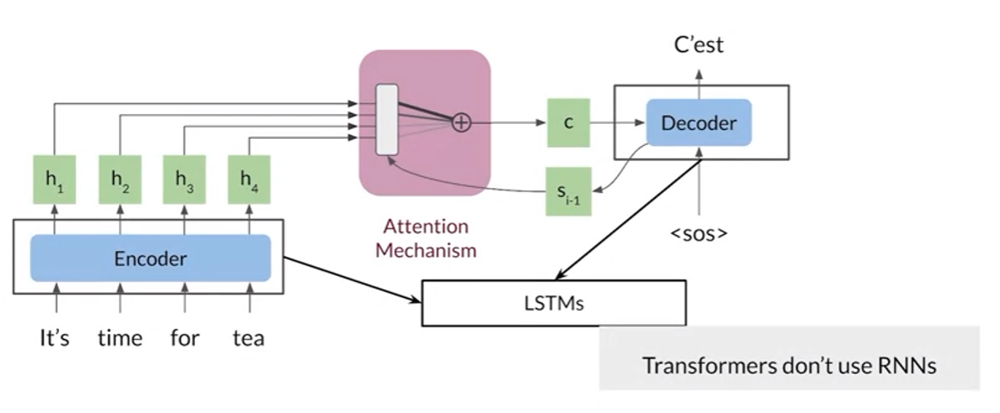

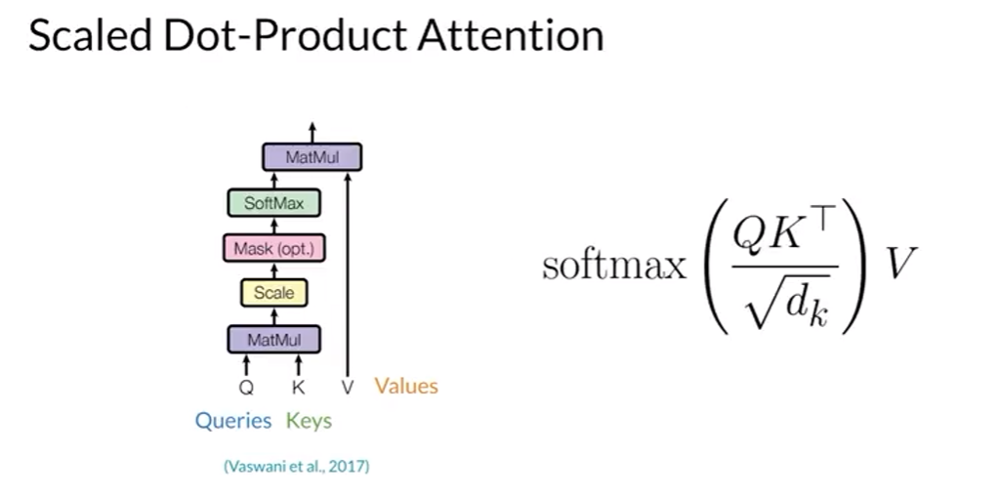

The Transformer model uses scale dot-product attention. The form of attention is very efficient in terms of computation and memory due to it consisting of just matrix multiplication operations. This mechanism is the core of the model and it allows the transformer to grow larger and more complex while being faster and using less memory than other comparable model architectures. 



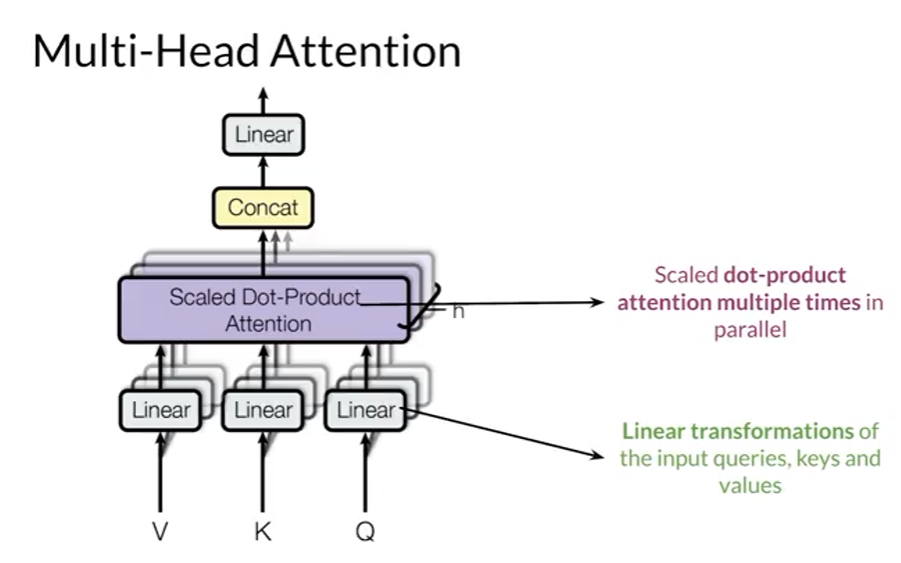

In the transformer model, you will use the multi-head attention layer. This layer runs in parallel and it has a number of scale dot-product attention mechanisms and multiple linear transformations of the input queries, keys, and values. In this layer, the linear transformations are learnable parameters. 

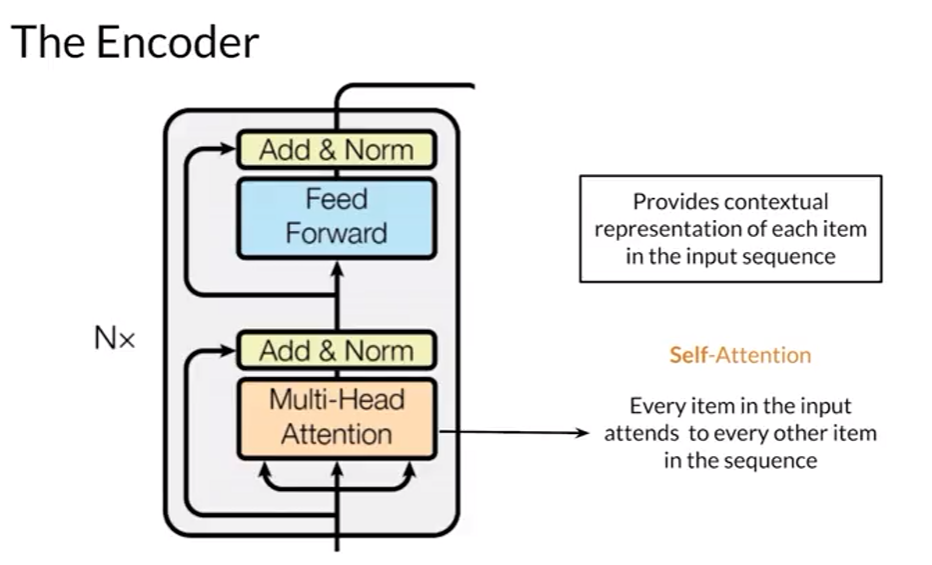

The transformer encoder starts with a multi-head attention module that performed self attention on the input sequence. That is, each word in the input attends to every other word in the input. This is followed by a residual connection and normalization, a feed forward layer, and another residual connection and normalization. This entire block is one encoder layer and is repeated N number of times. Thanks to self attention layer, the encoder will give you a contextual representation of each one of your inputs. 



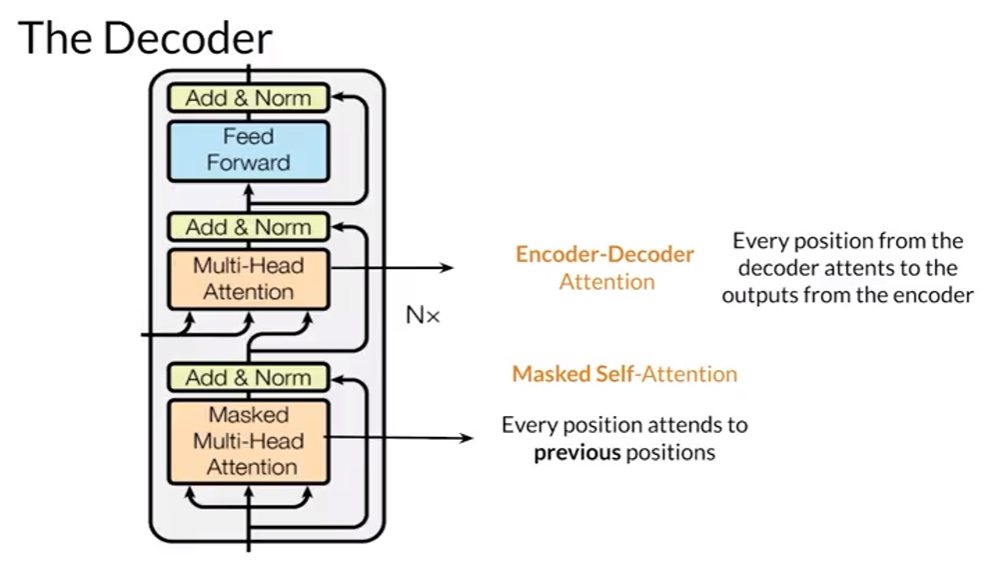

The decoder is constructed similarly to the encoder with multi-headed attention modules, residual connections, and normalization. The first attention module is masked such that each position attends only to previous positions. It blocks leftward flowing information. The second attention module takes the encoder output and allows the decoder to attend to all items. This whole decoder layer is also repeated some number of times, one after another. 



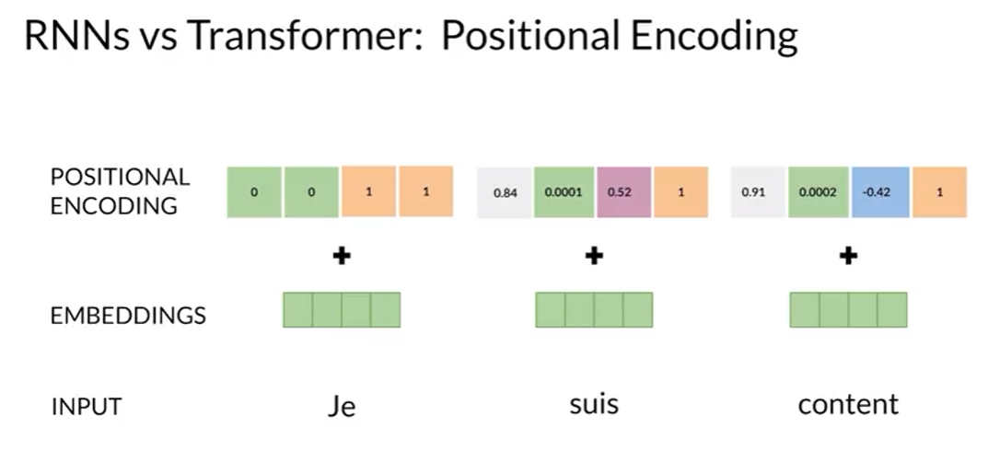

Transformers also incorporates a positional encoding stage which encodes each input's position in the sequence. This is necessary because transformers don't use recurrent neural networks, but the word order is relevant for any language. Positional encoding can be learned or fixed, just as with word embeddings. For instance, let's suppose you want to translate from the French phrase. Over here you have and then you want to capture the sequential information. The transformers uses a positional encoding to retain the position of the input sequence. The positional encoding has values that are added to the embeddings so that for every input word you have information about its order and position. In this case, a positional encoding vector for each word. 



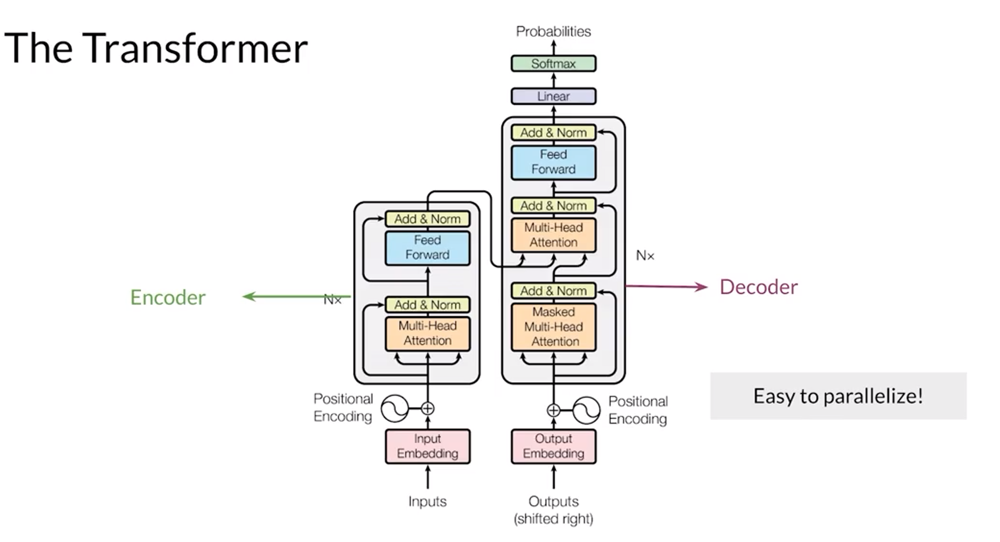

Putting these parts together, here's the full model architecture. Briefly on the left, the input sentence is first embedded and the positional encodings are applied. This goes to the encoder, which consists of multiple layers of multi-head attention modules. On the right is the decoder, which takes the output sentence, shifts it over one step to the right, and the outputs from the encoder. The decoder output is turned into output probabilities using a linear layer with a softmax activation. This architecture is easy to parallelize compared to RNN models, and as such, can be trained much more efficiently on multiple GPUs. It can also scale up to learn multiple tasks on larger and larger datasets. I went through this quickly but don't worry, I'll go in-depth on each part in later videos. In summary, RNNs have some problems that come from their sequential structure. With RNNs, it is hard to fully exploit the advantages of parallel computing. And for long sequences, important information might get lost within the network and vanishing gradient problems arise. But fortunately, recent research has found ways to solve for the shortcomings of RNNs by using transformers. Transformers are a great alternative to RNNs that help overcome these problems in NLP and in many fields that process sequential data. 

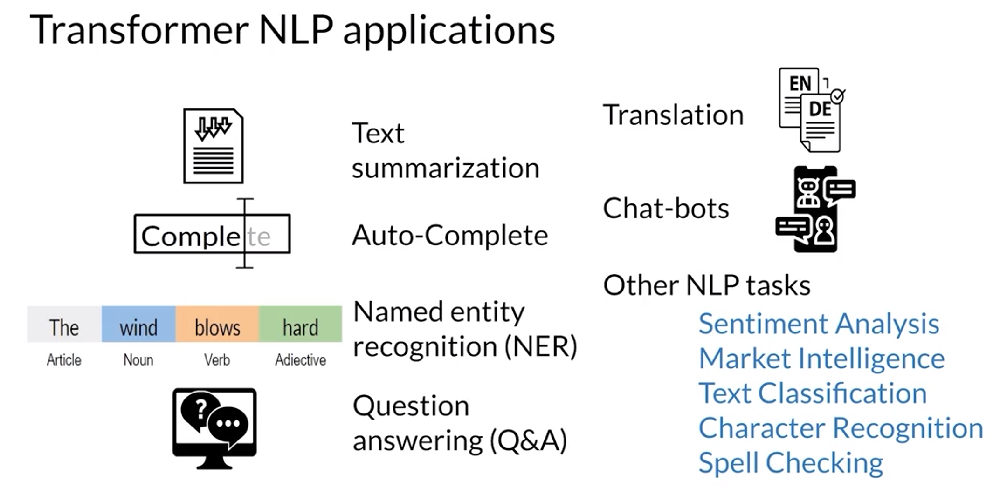

### Transformers application:
* can be generally applied to any sequential task just like RNNs, it has been widely used throughout NLP
* automatic text summarization
* autocompletion
* named entity recognition 
* automatic question answering
* machine translation
* chatbots 
* sentiment analysis 
* market intelligence
* others



### Variants of transformers used in NLP:
* GPT-2 which stands for generative pre-training for transformer
* Bert, which stands for bidirectional encoder representations from transformers 
* T5, which stands for text-to-text transfer transformer 



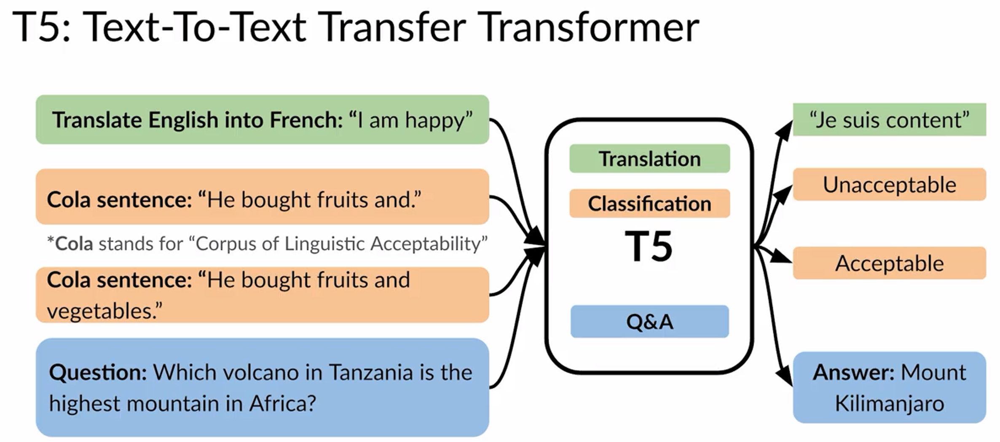

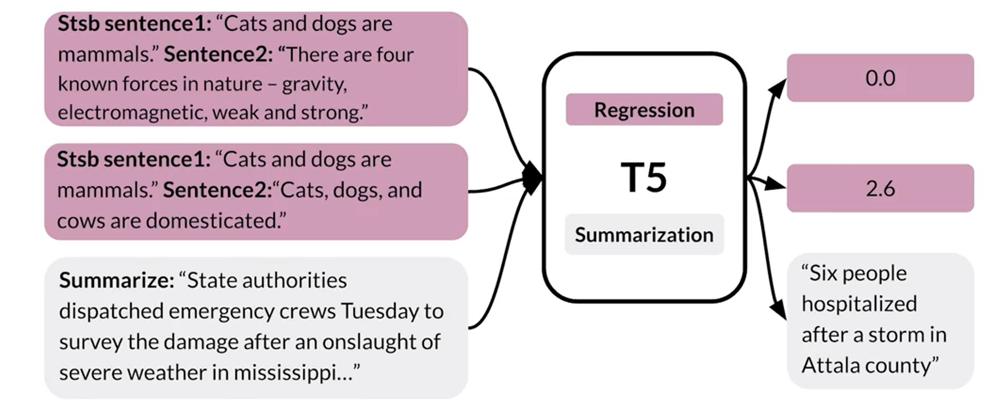

## Ways of attention:
* Encoder-Decoder Attention
* Self-Attention
* Masked Self-Attention
* **Multi-Head Attention**

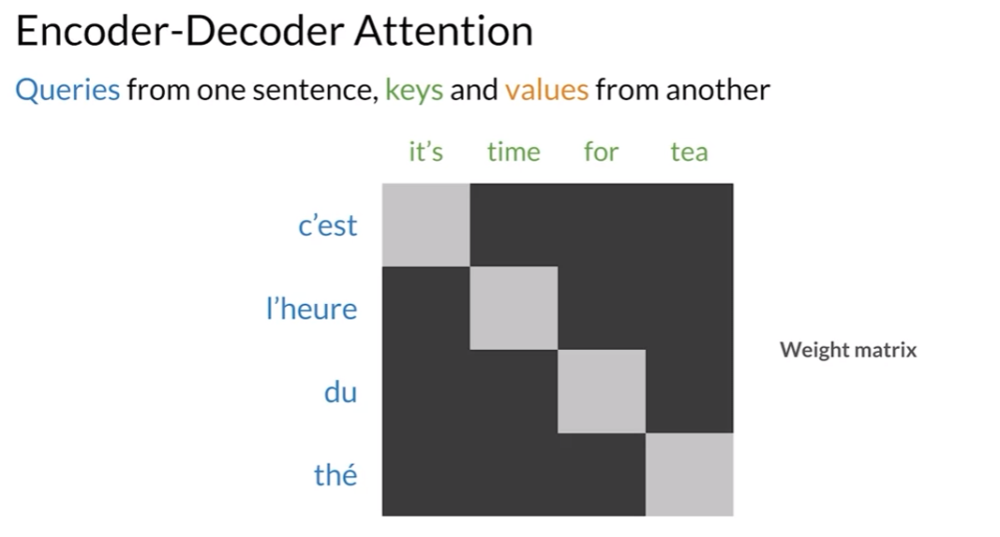

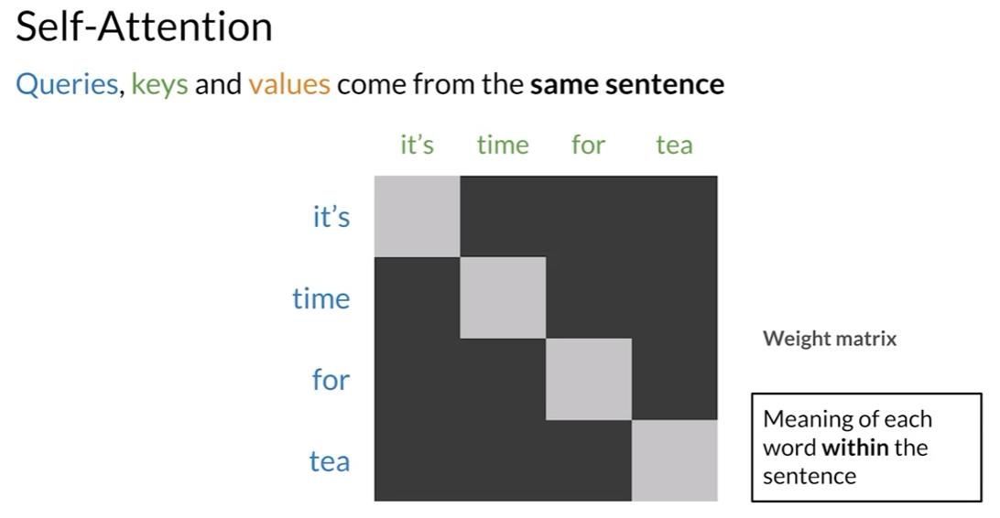

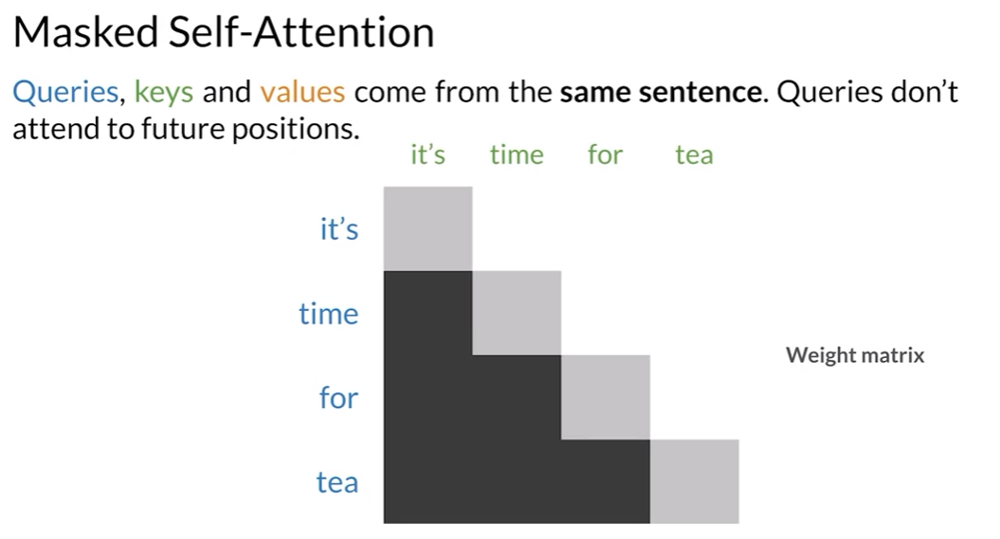

## Multi-Head Attention

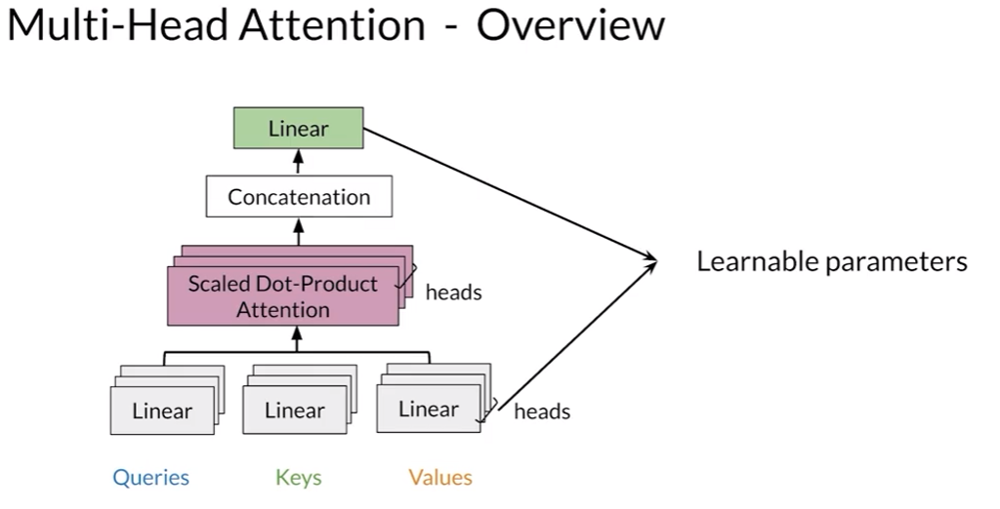

Multi-headed attention:
* Each head learns a different linear transformation to represent words. 
* Those linear transformations are combined and run through a linear layer to give you the final representation of words. 
* Multi-Headed models attend to information from different representations at different positions

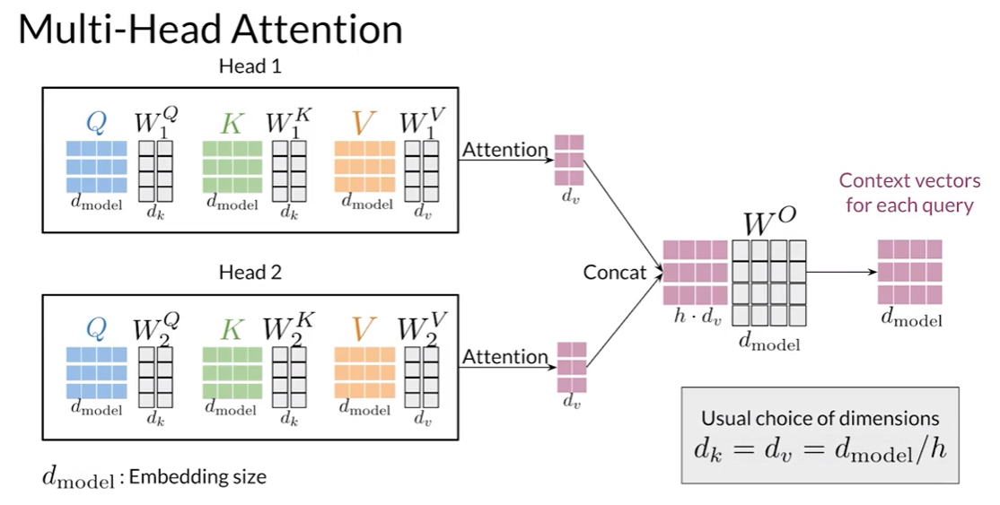

Say that you have two heads in your model. The inputs to the multi-head attention layer are the queries, keys, and values matrices. The number of columns in those matrices is equal to d sub model, which is the embedding size, and the number of rows is given by the number of words the sequences used to construct each matrix. 
1. The first step is to transform the queries, keys and values using a set of matrices W superscripts, Q K and V per head of the model. This step will give you the different sets of representations that you use for the parallel attention mechanisms. The number of rows and the transformation matrices is equal to d sub model. The number of columns d sub K for the queries and keys transformation matrices, and the number of columns d sub V for W superscript V are hyperparameters that you can choose. In the original transformer model, the author advises setting d sub K and d sub V equals to the dimension of the embeddings divided by the number of heads in the model. This choice of sizes would ensure that the computational cost of multi head attention doesn't exceed by much the one for a single head attention. 
2. After getting the transformed values for the query key and value matrices per head, you can apply in parallel the attention mechanism. As a result, you get a matrix per head with the column dimensions equal to d sub V, and the number of rows in those matrices is the same as the number of rows in the query matrix. 
3. Then you concatenate horizontally the matrices outputted by each attention head in the model. So you will get a matrix that has d sub V times the number of heads columns. 
4. Then you apply a linear transformation W superscript O to the concatenated matrix. This linear transformation has columns equal to d sub model, and if you choose d sub V to be equal to the embedding size divided by the number of heads, the number of rows in this matrix would also be d sub model. Just as with single head attention, you will get a matrix with the context vectors of size d sub model for each of your original queries. 

That's it for multi-head attention, you just need to apply the attention mechanism to multiple sets of representations for the queries, keys, and values. Then you concatenate the results from each attention computation to get a matrix that you linearly transform to get the context vectors for each original query. 

## Attention

In [ ]:
def dot_product_attention(q, k, v, mask, scale=True):
    """
    Calculate the attention weights.
      q, k, v must have matching leading dimensions.
      k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
      The mask has different shapes depending on its type(padding or look ahead) 
      but it must be broadcastable for addition.

    Arguments:
        q (tf.Tensor): query of shape (..., seq_len_q, depth)
        k (tf.Tensor): key of shape (..., seq_len_k, depth)
        v (tf.Tensor): value of shape (..., seq_len_v, depth_v)
        mask (tf.Tensor): mask with shape broadcastable 
              to (..., seq_len_q, seq_len_k). Defaults to None.
        scale (boolean): if True, the result is a scaled dot-product attention. Defaults to True.

    Returns:
        attention_output (tf.Tensor): the result of the attention function
    """
    
    # Multiply q and k transposed.
    matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)

    # scale matmul_qk with the square root of dk
    if scale:
        dk = tf.cast(tf.shape(k)[-1], tf.float32)
        matmul_qk = matmul_qk / tf.math.sqrt(dk)
    # add the mask to the scaled tensor.
    if mask is not None:
        matmul_qk = matmul_qk + (1. - mask) * -1e9 

    # softmax is normalized on the last axis (seq_len_k) so that the scores add up to 1.
    attention_weights = tf.keras.activations.softmax(matmul_qk)

    # Multiply the attention weights by v
    attention_output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

    return attention_output

In [ ]:
def causal_dot_product_attention(q, k, v, scale=True):
    """ Masked dot product self attention.
    Args:
        q (numpy.ndarray): queries.
        k (numpy.ndarray): keys.
        v (numpy.ndarray): values.
    Returns:
        numpy.ndarray: masked dot product self attention tensor.
    """
    
    # Size of the penultimate dimension of the query
    mask_size = q.shape[-2]

    # Creates a matrix with ones below the diagonal and 0s above. It should have shape (1, mask_size, mask_size)
    mask = tf.experimental.numpy.tril(tf.ones((mask_size, mask_size)))  
    
    return dot_product_attention(q, k, v, mask, scale=scale)

In [ ]:
result = causal_dot_product_attention(q, k, v)

## Masking

In [ ]:
def create_padding_mask(decoder_token_ids):
    """
    Creates a matrix mask for the padding cells
    
    Arguments:
        decoder_token_ids (matrix like): matrix of size (n, m)
    
    Returns:
        mask (tf.Tensor): binary tensor of size (n, 1, m)
    """    
    seq = 1 - tf.cast(tf.math.equal(decoder_token_ids, 0), tf.float32)
  
    # add extra dimensions to add the padding
    # to the attention logits. 
    # this will allow for broadcasting later when comparing sequences
    return seq[:, tf.newaxis, :] 

x = tf.constant([[7., 6., 0., 0., 0.], [1., 2., 3., 0., 0.], [3., 0., 0., 0., 0.]])

In [ ]:
# Create the mask for x
mask = create_padding_mask(x)

# Extend the dimension of x to match the dimension of the mask
x_extended = x[:, tf.newaxis, :]

print("Softmax of non-masked vectors:\n")
print(tf.keras.activations.softmax(x_extended))

print("\nSoftmax of masked vectors:\n")
print(tf.keras.activations.softmax(x_extended + (1 - mask) * -1.0e9))

The look-ahead mask helps your model pretend that it correctly predicted a part of the output and see if, without looking ahead, it can correctly predict the next output.

In [ ]:
def create_look_ahead_mask(sequence_length):
    """
    Returns a lower triangular matrix filled with ones
    
    Arguments:
        sequence_length (int): matrix size
    
    Returns:
        mask (tf.Tensor): binary tensor of size (sequence_length, sequence_length)
    """
    mask = tf.linalg.band_part(tf.ones((1, sequence_length, sequence_length)), -1, 0)
    return mask 

In [ ]:
x = tf.random.uniform((1, 3))
temp = create_look_ahead_mask(x.shape[1])

## Positional Encoding

In [ ]:
def get_angles(position, k, d_model):
    """
    Computes a positional encoding for a word 
    
    Arguments:
        position (int): position of the word
        k (int): refers to each of the different dimensions in the positional encodings, with i equal to k//2
        d_model(int): the dimension of the word embedding and positional encoding
    
    Returns:
        _ (float): positional embedding value for the word
    """
    i = k // 2
    angle_rates = 1 / np.power(10000, (2 * i) / np.float32(d_model))
    return position * angle_rates

In [ ]:
def positional_encoding(positions, d):
    """
    Precomputes a matrix with all the positional encodings 
    
    Arguments:
        positions (int): Maximum number of positions to be encoded 
        d (int): Encoding size 
    
    Returns:
        pos_encoding (tf.Tensor): A matrix of shape (1, position, d_model) with the positional encodings
    """
    # initialize a matrix angle_rads of all the angles 
    angle_rads = get_angles(np.arange(positions)[:, np.newaxis],
                          np.arange(d)[np.newaxis, :],
                          d)
  
    # apply sin to even indices in the array; 2i
    angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
    # apply cos to odd indices in the array; 2i+1
    angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
    pos_encoding = angle_rads[np.newaxis, ...]
    
    return tf.cast(pos_encoding, dtype=tf.float32)

In [ ]:
pos_encoding = positional_encoding(128, 256)

plt.pcolormesh(pos_encoding[0], cmap='RdBu')
plt.xlabel('d')
plt.xlim((0, 256))
plt.ylabel('Position')
plt.colorbar()
plt.show()

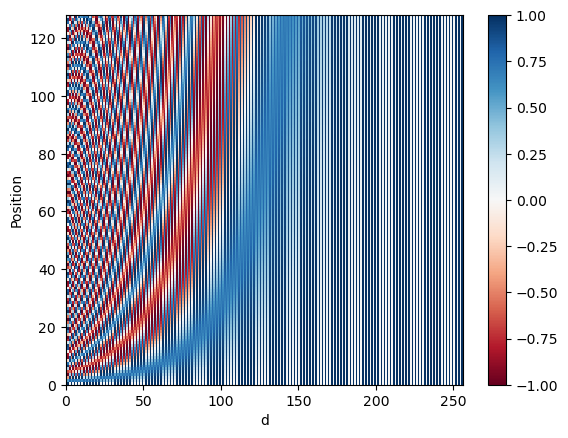

## Decoder

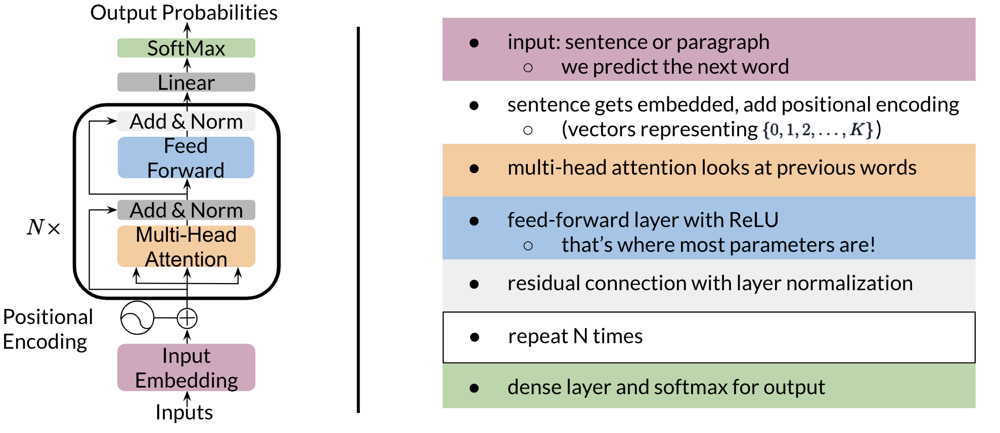

Once you get the embeddings, you add the positional encoding, which you can think of just a number that tells you information about the position of the word. Then, you do multi-head attention. There is a feedforward layer (blue) with a ReLU (and optionally some linear layers) after this, then a residual connection with layer normalization (repeat the block shown above N times), finally a linear layer with a softmax. Zooming into the decoder block that gets repeated N times, you get the following: 

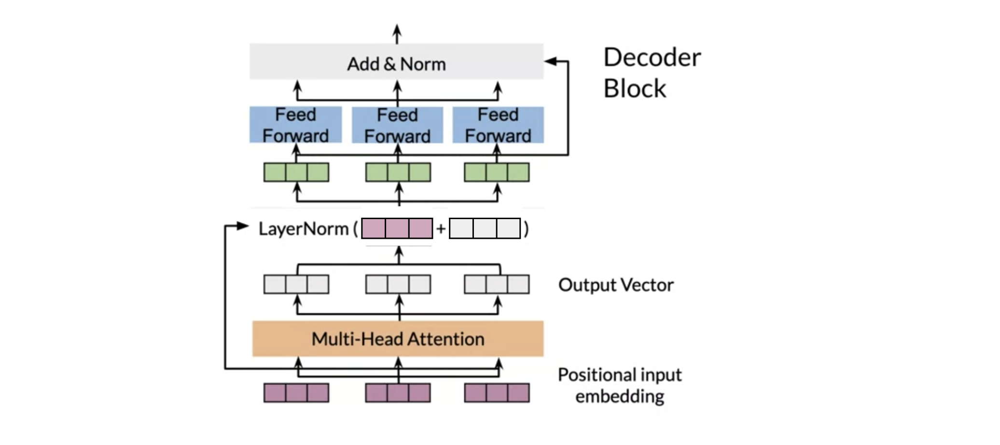

Now for the feedforward block, you can just implement the following: 

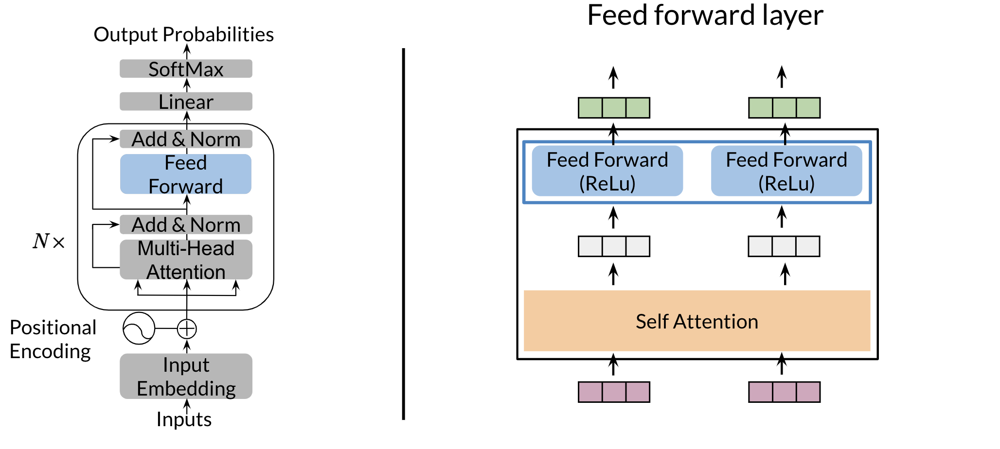

You get the input, (red vector) run it through self-attention and then a feedforward with ReLU. At the end of the decoder, you can just run a linear layer and a softmax.

## Transformer for summarization

Transformer only takes text as input and predicts the next word. For summarization, it turns out you just need to concatenate the input, in this case the article, and put the summary after it. 

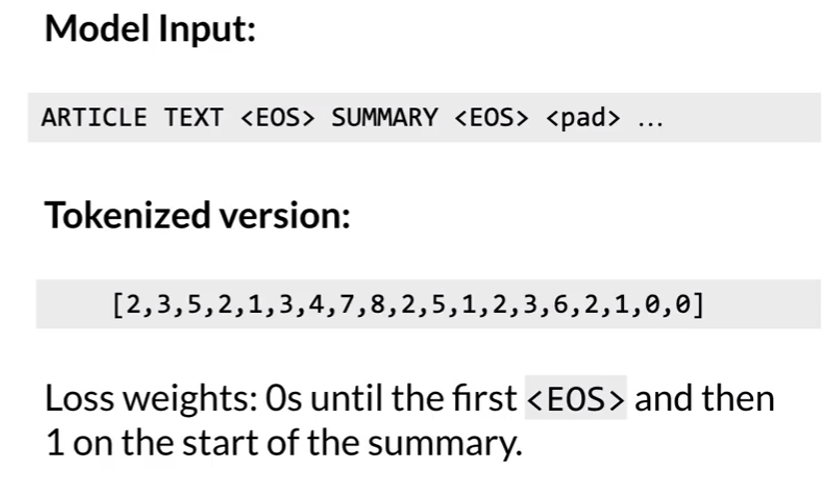

The input for the model is a long text that starts with a news article, then comes the EOS tag, the summary, and then another EOS tag. As usual, the input is tokenized as a sequence of integers. Here, zero denotes padding, and one EOS, and all other numbers for the tokens for different words.

When you're on the transformer on this input, it will predict the next word by looking at all the previous ones. But you do not want to have a huge loss in the model just because it's not able to predict the correct ones. That's why you have to use a weighted loss. Instead of averaging the loss for every word in the whole sequence, you weight the loss for the words within the article with zeros, and the ones within the summary with ones so the model only focuses on the summary. 

However, when there is little data for the summaries, it actually helps to waste the article loss with non zero numbers, say 0.2 or 0.5 or even one. That way, the model is able to learn word relationships that are common in the news. 



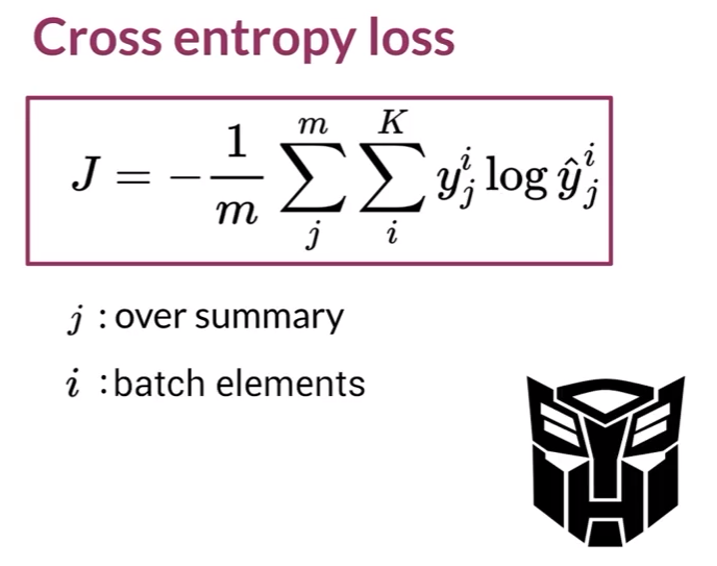

Another way to look at what I discussed in the previous slide is by looking at the cost function, which sums the losses over the words J within the summary for every example I in the batch. The cost function is a cross entropy function that ignores the words from the article to be summarized. 

Now that you know how to construct the inputs and the model, you can train your transformer summarizer. Recall again that transformers predict the next word and your input is in use article. At test or inference time, you will input the article with the EOS token to the model and ask for the next word. It is the first word of the summary. Then you will ask for the next word, and the next, and so on, until you get the EOS token. When you run your transformer model, it generates a probability distribution over all possible words. You will sample from this distribution so each time you run this process, you'll get a different summary. 

# Transformers (implementation)

* Use built-in functions to preprocess your data
* Implement DotProductAttention
* Implement Causal Attention
* Understand how attention works
* Build the transformer model
* Evaluate your model
* Summarize an article

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import time
import utils4

import textwrap
wrapper = textwrap.TextWrapper(width=70)

tf.keras.utils.set_random_seed(10)

<a name='1'></a>
## 1 - Import the Dataset
You have the dataset saved in a .json file, which you can easily open with pandas. The loading function has already been taken care of in `utils.py`.

In [ ]:
data_dir = "data/corpus"

train_data, test_data = utils4.get_train_test_data(data_dir)

# Take one example from the dataset and print it
example_summary, example_dialogue = train_data.iloc[10]
print(f"Dialogue:\n{example_dialogue}")
print(f"\nSummary:\n{example_summary}")

Dialogue:
Lucas: Hey! How was your day?
Demi: Hey there! 
Demi: It was pretty fine, actually, thank you!
Demi: I just got promoted! :D
Lucas: Whoa! Great news!
Lucas: Congratulations!
Lucas: Such a success has to be celebrated.
Demi: I agree! :D
Demi: Tonight at Death & Co.?
Lucas: Sure!
Lucas: See you there at 10pm?
Demi: Yeah! See you there! :D

Summary:
Demi got promoted. She will celebrate that with Lucas at Death & Co at 10 pm.


<a name='2'></a>
## 2 - Preprocess the data

First you will do some preprocessing of the data and split it into inputs and outputs. Here you also remove some of the characters that are specific to this dataset and add the `[EOS]` (end of sentence) token to the end, like it was discussed in the lecture videos. You will also add a `[SOS]` (start of sentence) token to the beginning of the sentences.

In [ ]:
document, summary = utils.preprocess(train_data)
document_test, summary_test = utils.preprocess(test_data)

Now perform the standard preprocessing with the tensorflow library. You will need to modify the filters, because you dont want the `[EOS]` tokens to be removed.

Then create the vocabulary by combining the data in the documents and the summaries and using `.fit_on_texts()`:

In [ ]:
# The [ and ] from default tokens cannot be removed, because they mark the SOS and EOS token.
filters = '!"#$%&()*+,-./:;<=>?@\\^_`{|}~\t\n'
oov_token = '[UNK]'

tokenizer = tf.keras.preprocessing.text.Tokenizer(filters=filters, oov_token=oov_token, lower=False)

documents_and_summary = pd.concat([document, summary], ignore_index=True)

tokenizer.fit_on_texts(documents_and_summary)

inputs = tokenizer.texts_to_sequences(document)
targets = tokenizer.texts_to_sequences(summary)

vocab_size = len(tokenizer.word_index) + 1

print(f'Size of vocabulary: {vocab_size}')

Size of vocabulary: 34250


Now you can pad the tokenized sequences for the training data.

For the purpose of this notebook you need to limit the length of the sequences, as transformers are really big models and are not meant to be trained in such small environments.

In [ ]:
# Limit the size of the input and output data for being able to run it in this environment.
encoder_maxlen = 150
decoder_maxlen = 50

# Pad the sequences.
inputs = tf.keras.preprocessing.sequence.pad_sequences(inputs, maxlen=encoder_maxlen, padding='post', truncating='post')
targets = tf.keras.preprocessing.sequence.pad_sequences(targets, maxlen=decoder_maxlen, padding='post', truncating='post')

inputs = tf.cast(inputs, dtype=tf.int32)
targets = tf.cast(targets, dtype=tf.int32)

# Create the final training dataset.
BUFFER_SIZE = 10000
BATCH_SIZE = 64

dataset = tf.data.Dataset.from_tensor_slices((inputs, targets)).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

<a name='3'></a>
## 3 - Positional Encoding

In sequence to sequence tasks, the relative order of your data is extremely important to its meaning. When you were training sequential neural networks such as RNNs, you fed your inputs into the network in order. Information about the order of your data was automatically fed into your model. However, when you train a Transformer network using multi-head attention, you feed your data into the model all at once. While this dramatically reduces training time, there is no information about the order of your data. This is where positional encoding is useful.

In [ ]:
def positional_encoding(positions, d_model):
    """
    Precomputes a matrix with all the positional encodings 
    
    Arguments:
        positions (int): Maximum number of positions to be encoded 
        d_model (int): Encoding size 
    
    Returns:
        pos_encoding (tf.Tensor): A matrix of shape (1, position, d_model) with the positional encodings
    """
    
    position = np.arange(positions)[:, np.newaxis]
    k = np.arange(d_model)[np.newaxis, :]
    i = k // 2
    
    # initialize a matrix angle_rads of all the angles 
    angle_rates = 1 / np.power(10000, (2 * i) / np.float32(d_model))
    angle_rads = position * angle_rates
  
    # apply sin to even indices in the array; 2i
    angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
    # apply cos to odd indices in the array; 2i+1
    angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
    pos_encoding = angle_rads[np.newaxis, ...]
    
    return tf.cast(pos_encoding, dtype=tf.float32)

<a name='4'></a>
## 4 - Masking

There are two types of masks that are useful when building your Transformer network: the *padding mask* and the *look-ahead mask*. Both help the softmax computation give the appropriate weights to the words in your input sentence. 

In [ ]:
def create_padding_mask(decoder_token_ids):
    """
    Creates a matrix mask for the padding cells
    
    Arguments:
        decoder_token_ids (matrix like): matrix of size (n, m)
    
    Returns:
        mask (tf.Tensor): binary tensor of size (n, 1, m)
    """    
    seq = 1 - tf.cast(tf.math.equal(decoder_token_ids, 0), tf.float32)
  
    # add extra dimensions to add the padding to the attention logits. 
    # this will allow for broadcasting later when comparing sequences
    return seq[:, tf.newaxis, :] 


def create_look_ahead_mask(sequence_length):
    """
    Returns a lower triangular matrix filled with ones
    
    Arguments:
        sequence_length (int): matrix size
    
    Returns:
        mask (tf.Tensor): binary tensor of size (sequence_length, sequence_length)
    """
    mask = tf.linalg.band_part(tf.ones((1, sequence_length, sequence_length)), -1, 0)
    return mask 

<a name='5'></a>
## 5 - Self-Attention


The use of self-attention paired with traditional convolutional networks allows for parallelization which speeds up training. You will implement **scaled dot product attention** which takes in a query, key, value, and a mask as inputs to return rich, attention-based vector representations of the words in your sequence. This type of self-attention can be mathematically expressed as:
$$
\text { Attention }(Q, K, V)=\operatorname{softmax}\left(\frac{Q K^{T}}{\sqrt{d_{k}}}+{M}\right) V\tag{4}\
$$

* $Q$ is the matrix of queries 
* $K$ is the matrix of keys
* $V$ is the matrix of values
* $M$ is the optional mask you choose to apply 
* ${d_k}$ is the dimension of the keys, which is used to scale everything down so the softmax doesn't explode

<a name='ex-1'></a>
### Exercise 1 - scaled_dot_product_attention 

Implement the function `scaled_dot_product_attention()` to create attention-based representations.


In [ ]:
def scaled_dot_product_attention(q, k, v, mask):
    """
    Calculate the attention weights.
      q, k, v must have matching leading dimensions.
      k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
      The mask has different shapes depending on its type(padding or look ahead) 
      but it must be broadcastable for addition.

    Arguments:
        q (tf.Tensor): query of shape (..., seq_len_q, depth)
        k (tf.Tensor): key of shape (..., seq_len_k, depth)
        v (tf.Tensor): value of shape (..., seq_len_v, depth_v)
        mask (tf.Tensor): mask with shape broadcastable 
              to (..., seq_len_q, seq_len_k). Defaults to None.

    Returns:
        output -- attention_weights
    """    
    # Multiply q and k transposed.
    matmul_qk = tf.matmul(q, k, transpose_b=True)

    # scale matmul_qk with the square root of dk
    dk = tf.cast(tf.shape(k)[-1], tf.float32)
    scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

    # add the mask to the scaled tensor.
    if mask is not None:  # Don't replace this None
        scaled_attention_logits += (1. - mask) * -1e9

    # softmax is normalized on the last axis (seq_len_k) so that the scores add up to 1.
    attention_weights = tf.keras.activations.softmax(scaled_attention_logits)

    # Multiply the attention weights by v
    output = tf.matmul(attention_weights, v)
    
    return output, attention_weights

In [ ]:
# Test your function!
q = np.array([[1, 1, 0, 1], [0, 1, 1, 1], [1, 0, 1, 1]]).astype(np.float32)
k = np.array([[1, 1, 0, 1], [1, 0, 1, 1 ], [1, 1, 1, 0], [0, 0, 0, 1], [0, 1, 0, 1]]).astype(np.float32)
v = np.array([[0, 0], [1, 0], [1, 0], [1, 1], [1, 1]]).astype(np.float32)
mask = np.array([[[0, 1, 0, 1, 1], [1, 0, 0, 1, 1], [1, 1, 0, 1, 1]]])

ou, atw = scaled_dot_product_attention(q, k, v, mask)
ou = np.around(ou, decimals=2)
atw = np.around(atw, decimals=2)

print(f"Output:\n {ou}")
print(f"\nAttention weigths:\n {atw}")

Output:
 [[[1.   0.62]
  [0.62 0.62]
  [0.74 0.31]]]

Attention weigths:
 [[[0.   0.38 0.   0.23 0.38]
  [0.38 0.   0.   0.23 0.38]
  [0.26 0.43 0.   0.16 0.16]]]


<a name='6'></a>
## 6 - Encoder


In [ ]:
def FullyConnected(embedding_dim, fully_connected_dim):
    """
    Returns a sequential model consisting of two dense layers. The first dense layer has
    fully_connected_dim neurons and is activated by relu. The second dense layer has
    embedding_dim and no activation.

    Arguments:
        embedding_dim (int): output dimension
        fully_connected_dim (int): dimension of the hidden layer

    Returns:
        _ (tf.keras.Model): sequential model
    """
    return tf.keras.Sequential([
        tf.keras.layers.Dense(fully_connected_dim, activation='relu'),  # (batch_size, seq_len, d_model)
        tf.keras.layers.Dense(embedding_dim)  # (batch_size, seq_len, d_model)
    ])

<a name='6-1'></a>
### 6.1 Encoder Layer

Now you can pair multi-head attention and feed forward neural network together in an encoder layer! You will also use residual connections and layer normalization to help speed up training (Figure 2a).

The encoder block (Figure 2) is is already implemented for you. Take a very close look at its implementation, as you will later have to create the decoder yourself, and a lot of the code is very similar. The encoder block performs the following steps: 
1. It takes the Q, V, K matrices and a boolean mask to a multi-head attention layer. Remember that to compute *self*-attention Q, V and K are the same. You will also perform Dropout in this multi-head attention layer during training. 
2. There is a skip connection to add your original input `x` and the output of the multi-head attention layer. 
3. After adding the skip connection, the output passes through the first normalization layer.
4. Finally, steps 1-3 are repeated but with the feed forward neural network with a dropout layer instead of the multi-head attention layer. 

<details>
  <summary><font size="2" color="darkgreen"><b>Additional Information (Click to expand)</b></font></summary>
    
* The `__init__` method creates all the layers that will be accesed by the the `call` method. Wherever you want to use a layer defined inside  the `__init__`  method you will have to use the syntax `self.[insert layer name]`. 
* You will find the documentation of [MultiHeadAttention](https://www.tensorflow.org/api_docs/python/tf/keras/layers/MultiHeadAttention) helpful. *Note that if query, key and value are the same, then this function performs self-attention.*
* The call arguments for `self.mha` are (Where B is for batch_size, T is for target sequence shapes, and S is output_shape):
 - `query`: Query Tensor of shape (B, T, dim).
 - `value`: Value Tensor of shape (B, S, dim).
 - `key`: Optional key Tensor of shape (B, S, dim). If not given, will use the same value for both key and value, which is the most common case.
 - `attention_mask`: a boolean mask of shape (B, T, S), that prevents attention to certain positions. The boolean mask specifies which query elements can attend to which key elements, 1 indicates attention and 0 indicates no attention. Broadcasting can happen for the missing batch dimensions and the head dimension.
 - `return_attention_scores`: A boolean to indicate whether the output should be attention output if True, or (attention_output, attention_scores) if False. Defaults to False.
 - `training`: Python boolean indicating whether the layer should behave in training mode (adding dropout) or in inference mode (no dropout). Defaults to either using the training mode of the parent layer/model, or False (inference) if there is no parent layer. Take a look at [tf.keras.layers.Dropout](https://www.tensorflow.org/versions/r2.4/api_docs/python/tf/keras/layers/Dropout) for more details (Additional reading in [Keras FAQ](https://keras.io/getting_started/faq/#whats-the-difference-between-the-training-argument-in-call-and-the-trainable-attribute))

In [ ]:
class EncoderLayer(tf.keras.layers.Layer):
    """
    The encoder layer is composed by a multi-head self-attention mechanism,
    followed by a simple, positionwise fully connected feed-forward network. 
    This architecture includes a residual connection around each of the two 
    sub-layers, followed by layer normalization.
    """
    def __init__(self, embedding_dim, num_heads, fully_connected_dim,
                 dropout_rate=0.1, layernorm_eps=1e-6):
        
        super(EncoderLayer, self).__init__()

        self.mha = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads,
            key_dim=embedding_dim,
            dropout=dropout_rate
        )

        self.ffn = FullyConnected(
            embedding_dim=embedding_dim,
            fully_connected_dim=fully_connected_dim
        )

        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)

        self.dropout_ffn = tf.keras.layers.Dropout(dropout_rate)
    
    def call(self, x, training, mask):
        """
        Forward pass for the Encoder Layer
        
        Arguments:
            x (tf.Tensor): Tensor of shape (batch_size, input_seq_len, fully_connected_dim)
            training (bool): Boolean, set to true to activate
                        the training mode for dropout layers
            mask (tf.Tensor): Boolean mask to ensure that the padding is not 
                    treated as part of the input
        Returns:
            encoder_layer_out (tf.Tensor): Tensor of shape (batch_size, input_seq_len, embedding_dim)
        """
        # calculate self-attention using mha(~1 line).
        # Dropout is added by Keras automatically if the dropout parameter is non-zero during training
        self_mha_output = self.mha(x, x, x, mask)  # Self attention (batch_size, input_seq_len, fully_connected_dim)
        
        # skip connection
        # apply layer normalization on sum of the input and the attention output to get the  
        # output of the multi-head attention layer
        skip_x_attention = self.layernorm1(x + self_mha_output)  # (batch_size, input_seq_len, fully_connected_dim)

        # pass the output of the multi-head attention layer through a ffn
        ffn_output = self.ffn(skip_x_attention)  # (batch_size, input_seq_len, fully_connected_dim)
        
        # apply dropout layer to ffn output during training
        # use `training=training`
        ffn_output = self.dropout_ffn(ffn_output, training=training)
        
        # apply layer normalization on sum of the output from multi-head attention (skip connection) and ffn output
        # to get the output of the encoder layer
        encoder_layer_out = self.layernorm2(skip_x_attention + ffn_output)  # (batch_size, input_seq_len, embedding_dim)
        
        return encoder_layer_out
    

<a name='6-2'></a>
### 6.2 - Full Encoder


The Encoder class is implemented for you. It performs the following steps: 
1. Pass the input through the Embedding layer.
2. Scale the embedding by multiplying it by the square root of the embedding dimension. 
3. Add the position encoding: self.pos_encoding `[:, :seq_len, :]` to the embedding.
4. Pass the encoded embedding through a dropout layer
5. Pass the output of the dropout layer through the stack of encoding layers using a for loop.

In [ ]:
class Encoder(tf.keras.layers.Layer):
    """
    The entire Encoder starts by passing the input to an embedding layer 
    and using positional encoding to then pass the output through a stack of
    encoder Layers
        
    """  
    def __init__(self, num_layers, embedding_dim, num_heads, fully_connected_dim, input_vocab_size,
               maximum_position_encoding, dropout_rate=0.1, layernorm_eps=1e-6):
        super(Encoder, self).__init__()

        self.embedding_dim = embedding_dim
        self.num_layers = num_layers

        self.embedding = tf.keras.layers.Embedding(input_vocab_size, self.embedding_dim)
        self.pos_encoding = positional_encoding(maximum_position_encoding, 
                                                self.embedding_dim)


        self.enc_layers = [EncoderLayer(embedding_dim=self.embedding_dim,
                                        num_heads=num_heads,
                                        fully_connected_dim=fully_connected_dim,
                                        dropout_rate=dropout_rate,
                                        layernorm_eps=layernorm_eps) 
                           for _ in range(self.num_layers)]

        self.dropout = tf.keras.layers.Dropout(dropout_rate)
        
    def call(self, x, training, mask):
        """
        Forward pass for the Encoder
        
        Arguments:
            x (tf.Tensor): Tensor of shape (batch_size, seq_len, embedding_dim)
            training (bool): Boolean, set to true to activate
                        the training mode for dropout layers
            mask (tf.Tensor): Boolean mask to ensure that the padding is not 
                    treated as part of the input

        Returns:
            x (tf.Tensor): Tensor of shape (batch_size, seq_len, embedding_dim)
        """
        seq_len = tf.shape(x)[1]
        
        # Pass input through the Embedding layer
        x = self.embedding(x)  # (batch_size, input_seq_len, embedding_dim)
        # Scale embedding by multiplying it by the square root of the embedding dimension
        x *= tf.math.sqrt(tf.cast(self.embedding_dim, tf.float32))
        # Add the position encoding to embedding
        x += self.pos_encoding[:, :seq_len, :]
        # Pass the encoded embedding through a dropout layer
        # use `training=training`
        x = self.dropout(x, training=training)
        # Pass the output through the stack of encoding layers 
        for i in range(self.num_layers):
            x = self.enc_layers[i](x, training, mask)

        return x  # (batch_size, input_seq_len, embedding_dim)

<a name='7'></a>
## 7 - Decoder


<a name='7-1'></a>    
### 7.1 - Decoder Layer
Again, you'll pair multi-head attention with a feed forward neural network, but this time you'll implement two multi-head attention layers. You will also use residual connections and layer normalization to help speed up training (Figure 3a).

    
1. Block 1 is a multi-head attention layer with a residual connection, and look-ahead mask. Like in the `EncoderLayer`, Dropout is defined within the multi-head attention layer.
2. Block 2 will take into account the output of the Encoder, so the multi-head attention layer will receive K and V from the encoder, and Q from the Block 1. You will then apply a normalization layer and a residual connection, just like you did before with the `EncoderLayer`.
3. Finally, Block 3 is a feed forward neural network with dropout and normalization layers and a residual connection.
 

In [ ]:
class DecoderLayer(tf.keras.layers.Layer):
    """
    The decoder layer is composed by two multi-head attention blocks, 
    one that takes the new input and uses self-attention, and the other 
    one that combines it with the output of the encoder, followed by a
    fully connected block. 
    """
    def __init__(self, embedding_dim, num_heads, fully_connected_dim, dropout_rate=0.1, layernorm_eps=1e-6):
        super(DecoderLayer, self).__init__()

        self.mha1 = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads,
            key_dim=embedding_dim,
            dropout=dropout_rate
        )

        self.mha2 = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads,
            key_dim=embedding_dim,
            dropout=dropout_rate
        )

        self.ffn = FullyConnected(
            embedding_dim=embedding_dim,
            fully_connected_dim=fully_connected_dim
        )

        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)
        self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=layernorm_eps)

        self.dropout_ffn = tf.keras.layers.Dropout(dropout_rate)
    
    def call(self, x, enc_output, training, look_ahead_mask, padding_mask):
        """
        Forward pass for the Decoder Layer
        
        Arguments:
            x (tf.Tensor): Tensor of shape (batch_size, target_seq_len, fully_connected_dim)
            enc_output (tf.Tensor): Tensor of shape(batch_size, input_seq_len, fully_connected_dim)
            training (bool): Boolean, set to true to activate
                        the training mode for dropout layers
            look_ahead_mask (tf.Tensor): Boolean mask for the target_input
            padding_mask (tf.Tensor): Boolean mask for the second multihead attention layer
        Returns:
            out3 (tf.Tensor): Tensor of shape (batch_size, target_seq_len, fully_connected_dim)
            attn_weights_block1 (tf.Tensor): Tensor of shape (batch_size, num_heads, target_seq_len, target_seq_len)
            attn_weights_block2 (tf.Tensor): Tensor of shape (batch_size, num_heads, target_seq_len, input_seq_len)
        """
        
        # enc_output.shape == (batch_size, input_seq_len, fully_connected_dim)
        
        # BLOCK 1
        # calculate self-attention and return attention scores as attn_weights_block1.
        # Dropout will be applied during training (~1 line).
        mult_attn_out1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask, return_attention_scores=True, training=training)

        # apply layer normalization (layernorm1) to the sum of the attention output and the input (~1 line)
        Q1 = self.layernorm1(x + mult_attn_out1) 

        # BLOCK 2
        # calculate self-attention using the Q from the first block and K and V from the encoder output. 
        # Dropout will be applied during training
        # Return attention scores as attn_weights_block2 (~1 line) 
        mult_attn_out2, attn_weights_block2 = self.mha2(Q1, enc_output, enc_output, padding_mask, return_attention_scores=True, training=training) 

        # apply layer normalization (layernorm2) to the sum of the attention output and the output of the first block (~1 line)
        mult_attn_out2 = self.layernorm2(Q1 + mult_attn_out2) 
                
        #BLOCK 3
        # pass the output of the second block through a ffn
        ffn_output = self.ffn(mult_attn_out2)
        
        # apply a dropout layer to the ffn output
        # use `training=training`
        ffn_output = self.dropout_ffn(ffn_output, training=training)
        
        # apply layer normalization (layernorm3) to the sum of the ffn output and the output of the second block
        out3 = self.layernorm2(ffn_output + mult_attn_out2) 

        return out3, attn_weights_block1, attn_weights_block2
    

In [ ]:
# Test your function!
key_dim = 12
n_heads = 16

decoderLayer_test = DecoderLayer(embedding_dim=key_dim, num_heads=n_heads, fully_connected_dim=32)

q = np.ones((1, 15, key_dim))
encoder_test_output = tf.convert_to_tensor(np.random.rand(1, 7, 8))
look_ahead_mask = create_look_ahead_mask(q.shape[1])

out, attn_w_b1, attn_w_b2 = decoderLayer_test(q, encoder_test_output, False, look_ahead_mask, None)

print(f"Using embedding_dim={key_dim} and num_heads={n_heads}:\n")
print(f"q has shape:{q.shape}")
print(f"Output of encoder has shape:{encoder_test_output.shape}\n")

print(f"Output of decoder layer has shape:{out.shape}")
print(f"Att Weights Block 1 has shape:{attn_w_b1.shape}")
print(f"Att Weights Block 2 has shape:{attn_w_b2.shape}")

Using embedding_dim=12 and num_heads=16:

q has shape:(1, 15, 12)
Output of encoder has shape:(1, 7, 8)

Output of decoder layer has shape:(1, 15, 12)
Att Weights Block 1 has shape:(1, 16, 15, 15)
Att Weights Block 2 has shape:(1, 16, 15, 7)


<a name='7-2'></a> 
### 7.2 - Full Decoder

<a name='ex-3'></a>     
### Exercise 3 - Decoder

Implement `Decoder()` using the `call()` method to embed your output, add positional encoding, and implement multiple decoder layers.
 
1. Pass your generated output through the Embedding layer.
2. Scale your embedding by multiplying it by the square root of your embedding dimension. Remember to cast the embedding dimension to data type `tf.float32` before computing the square root.
3. Add the position encoding: self.pos_encoding `[:, :seq_len, :]` to your embedding.
4. Pass the encoded embedding through a dropout layer, remembering to use the `training` parameter to set the model training mode. 
5. Pass the output of the dropout layer through the stack of Decoding layers using a for loop.

In [ ]:
class Decoder(tf.keras.layers.Layer):
    """
    The entire Encoder starts by passing the target input to an embedding layer 
    and using positional encoding to then pass the output through a stack of
    decoder Layers
        
    """ 
    def __init__(self, num_layers, embedding_dim, num_heads, fully_connected_dim, target_vocab_size,
               maximum_position_encoding, dropout_rate=0.1, layernorm_eps=1e-6):
        super(Decoder, self).__init__()

        self.embedding_dim = embedding_dim
        self.num_layers = num_layers

        self.embedding = tf.keras.layers.Embedding(target_vocab_size, self.embedding_dim)
        self.pos_encoding = positional_encoding(maximum_position_encoding, self.embedding_dim)

        self.dec_layers = [DecoderLayer(embedding_dim=self.embedding_dim,
                                        num_heads=num_heads,
                                        fully_connected_dim=fully_connected_dim,
                                        dropout_rate=dropout_rate,
                                        layernorm_eps=layernorm_eps) 
                           for _ in range(self.num_layers)]
        self.dropout = tf.keras.layers.Dropout(dropout_rate)
    
    def call(self, x, enc_output, training, 
           look_ahead_mask, padding_mask):
        """
        Forward  pass for the Decoder
        
        Arguments:
            x (tf.Tensor): Tensor of shape (batch_size, target_seq_len, fully_connected_dim)
            enc_output (tf.Tensor):  Tensor of shape(batch_size, input_seq_len, fully_connected_dim)
            training (bool): Boolean, set to true to activate
                        the training mode for dropout layers
            look_ahead_mask (tf.Tensor): Boolean mask for the target_input
            padding_mask (tf.Tensor): Boolean mask for the second multihead attention layer
        Returns:
            x (tf.Tensor): Tensor of shape (batch_size, target_seq_len, fully_connected_dim)
            attention_weights (dict[str: tf.Tensor]): Dictionary of tensors containing all the attention weights
                                each of shape Tensor of shape (batch_size, num_heads, target_seq_len, input_seq_len)
        """

        seq_len = tf.shape(x)[1]
        attention_weights = {}
        
        # create word embeddings 
        x = self.embedding(x)
        
        # scale embeddings by multiplying by the square root of their dimension
        x *= tf.math.sqrt(tf.cast(self.embedding_dim, tf.float32))
        
        # add positional encodings to word embedding
        x += self.pos_encoding[:, :seq_len, :]

        # apply a dropout layer to x
        # use `training=training`
        x = self.dropout(x, training=training)

        # use a for loop to pass x through a stack of decoder layers and update attention_weights (~4 lines total)
        for i in range(self.num_layers):
            # pass x and the encoder output through a stack of decoder layers and save the attention weights
            # of block 1 and 2 (~1 line)
            x, block1, block2 = self.dec_layers[i](x, enc_output, training, look_ahead_mask, padding_mask)

            #update attention_weights dictionary with the attention weights of block 1 and block 2
            attention_weights['decoder_layer{}_block1_self_att'.format(i+1)] = block1
            attention_weights['decoder_layer{}_block2_decenc_att'.format(i+1)] = block2
        
        # x.shape == (batch_size, target_seq_len, fully_connected_dim)
        return x, attention_weights

In [ ]:
# Test your function!
n_layers = 5
emb_d = 13
n_heads = 17
fully_connected_dim = 16
target_vocab_size = 300
maximum_position_encoding = 6

x = np.array([[3, 2, 1, 1], [2, 1, 1, 0], [2, 1, 1, 0]])

encoder_test_output = tf.convert_to_tensor(np.random.rand(3, 7, 9))

look_ahead_mask = create_look_ahead_mask(x.shape[1])

decoder_test = Decoder(n_layers, emb_d, n_heads, fully_connected_dim, target_vocab_size,maximum_position_encoding)
                   
outd, att_weights = decoder_test(x, encoder_test_output, False, look_ahead_mask, None)

print(f"Using num_layers={n_layers}, embedding_dim={emb_d} and num_heads={n_heads}:\n")
print(f"x has shape:{x.shape}")
print(f"Output of encoder has shape:{encoder_test_output.shape}\n")

print(f"Output of decoder has shape:{outd.shape}\n")
print("Attention weights:")
for name, tensor in att_weights.items():
    print(f"{name} has shape:{tensor.shape}")

Using num_layers=5, embedding_dim=13 and num_heads=17:

x has shape:(3, 4)
Output of encoder has shape:(3, 7, 9)

Output of decoder has shape:(3, 4, 13)

Attention weights:
decoder_layer1_block1_self_att has shape:(3, 17, 4, 4)
decoder_layer1_block2_decenc_att has shape:(3, 17, 4, 7)
decoder_layer2_block1_self_att has shape:(3, 17, 4, 4)
decoder_layer2_block2_decenc_att has shape:(3, 17, 4, 7)
decoder_layer3_block1_self_att has shape:(3, 17, 4, 4)
decoder_layer3_block2_decenc_att has shape:(3, 17, 4, 7)
decoder_layer4_block1_self_att has shape:(3, 17, 4, 4)
decoder_layer4_block2_decenc_att has shape:(3, 17, 4, 7)
decoder_layer5_block1_self_att has shape:(3, 17, 4, 4)
decoder_layer5_block2_decenc_att has shape:(3, 17, 4, 7)


<a name='8'></a> 
## 8 - Transformer

    
The flow of data through the Transformer Architecture is as follows:
* First your input passes through an Encoder, which is just repeated Encoder layers that you implemented:
    - embedding and positional encoding of your input
    - multi-head attention on your input
    - feed forward neural network to help detect features
* Then the predicted output passes through a Decoder, consisting of the decoder layers that you implemented:
    - embedding and positional encoding of the output
    - multi-head attention on your generated output
    - multi-head attention with the Q from the first multi-head attention layer and the K and V from the Encoder
    - a feed forward neural network to help detect features
* Finally, after the Nth Decoder layer, one dense layer and a softmax are applied to generate prediction for the next output in your sequence.


Implement `Transformer()` using the `call()` method
1. Pass the input through the Encoder with the appropiate mask.
2. Pass the encoder output and the target through the Decoder with the appropiate mask.
3. Apply a linear transformation and a softmax to get a prediction.

In [ ]:
class Transformer(tf.keras.Model):
    """
    Complete transformer with an Encoder and a Decoder
    """
    def __init__(self, num_layers, embedding_dim, num_heads, fully_connected_dim, input_vocab_size, 
               target_vocab_size, max_positional_encoding_input,
               max_positional_encoding_target, dropout_rate=0.1, layernorm_eps=1e-6):
        super(Transformer, self).__init__()

        self.encoder = Encoder(num_layers=num_layers,
                               embedding_dim=embedding_dim,
                               num_heads=num_heads,
                               fully_connected_dim=fully_connected_dim,
                               input_vocab_size=input_vocab_size,
                               maximum_position_encoding=max_positional_encoding_input,
                               dropout_rate=dropout_rate,
                               layernorm_eps=layernorm_eps)

        self.decoder = Decoder(num_layers=num_layers, 
                               embedding_dim=embedding_dim,
                               num_heads=num_heads,
                               fully_connected_dim=fully_connected_dim,
                               target_vocab_size=target_vocab_size, 
                               maximum_position_encoding=max_positional_encoding_target,
                               dropout_rate=dropout_rate,
                               layernorm_eps=layernorm_eps)

        self.final_layer = tf.keras.layers.Dense(target_vocab_size, activation='softmax')
    
    def call(self, input_sentence, output_sentence, training, enc_padding_mask, look_ahead_mask, dec_padding_mask):
        """
        Forward pass for the entire Transformer
        Arguments:
            input_sentence (tf.Tensor): Tensor of shape (batch_size, input_seq_len, fully_connected_dim)
                              An array of the indexes of the words in the input sentence
            output_sentence (tf.Tensor): Tensor of shape (batch_size, target_seq_len, fully_connected_dim)
                              An array of the indexes of the words in the output sentence
            training (bool): Boolean, set to true to activate
                        the training mode for dropout layers
            enc_padding_mask (tf.Tensor): Boolean mask to ensure that the padding is not 
                    treated as part of the input
            look_ahead_mask (tf.Tensor): Boolean mask for the target_input
            dec_padding_mask (tf.Tensor): Boolean mask for the second multihead attention layer
        Returns:
            final_output (tf.Tensor): The final output of the model
            attention_weights (dict[str: tf.Tensor]): Dictionary of tensors containing all the attention weights for the decoder
                                each of shape Tensor of shape (batch_size, num_heads, target_seq_len, input_seq_len)
        
        """
        # call self.encoder with the appropriate arguments to get the encoder output
        enc_output = self.encoder(input_sentence, training, enc_padding_mask)
        
        # call self.decoder with the appropriate arguments to get the decoder output
        # dec_output.shape == (batch_size, tar_seq_len, fully_connected_dim)
        dec_output, attention_weights = self.decoder(output_sentence, enc_output, training, look_ahead_mask, dec_padding_mask)
        
        # pass decoder output through a linear layer and softmax (~1 line)
        final_output = self.final_layer(dec_output)

        return final_output, attention_weights

In [ ]:
# Test your function!
n_layers = 3
emb_d = 13
n_heads = 17
fully_connected_dim = 8
input_vocab_size = 300
target_vocab_size = 350
max_positional_encoding_input = 12
max_positional_encoding_target = 12

transformer = Transformer(n_layers, 
    emb_d, 
    n_heads, 
    fully_connected_dim, 
    input_vocab_size, 
    target_vocab_size, 
    max_positional_encoding_input,
    max_positional_encoding_target)

# 0 is the padding value
sentence_a = np.array([[2, 3, 1, 3, 0, 0, 0]])
sentence_b = np.array([[1, 3, 4, 0, 0, 0, 0]])

enc_padding_mask = create_padding_mask(sentence_a)
dec_padding_mask = create_padding_mask(sentence_a)

look_ahead_mask = create_look_ahead_mask(sentence_a.shape[1])

test_summary, att_weights = transformer(
    sentence_a,
    sentence_b,
    False,
    enc_padding_mask,
    look_ahead_mask,
    dec_padding_mask
)

print(f"Using num_layers={n_layers}, target_vocab_size={target_vocab_size} and num_heads={n_heads}:\n")
print(f"sentence_a has shape:{sentence_a.shape}")
print(f"sentence_b has shape:{sentence_b.shape}")

print(f"\nOutput of transformer (summary) has shape:{test_summary.shape}\n")
print("Attention weights:")
for name, tensor in att_weights.items():
    print(f"{name} has shape:{tensor.shape}")

Using num_layers=3, target_vocab_size=350 and num_heads=17:

sentence_a has shape:(1, 7)
sentence_b has shape:(1, 7)

Output of transformer (summary) has shape:(1, 7, 350)

Attention weights:
decoder_layer1_block1_self_att has shape:(1, 17, 7, 7)
decoder_layer1_block2_decenc_att has shape:(1, 17, 7, 7)
decoder_layer2_block1_self_att has shape:(1, 17, 7, 7)
decoder_layer2_block2_decenc_att has shape:(1, 17, 7, 7)
decoder_layer3_block1_self_att has shape:(1, 17, 7, 7)
decoder_layer3_block2_decenc_att has shape:(1, 17, 7, 7)


<a name='9'></a>
## 9 - Initialize the Model
Now that you have defined the model, you can initialize and train it. First you can initialize the model with the parameters below. Note that generally these models are much larger and you are using a smaller version to fit this environment and to be able to train it in just a few minutes.

The base model described in the original Transformer paper used `num_layers=6`, `embedding_dim=512`, and `fully_connected_dim=2048`.

In [ ]:
# Define the model parameters
num_layers = 2
embedding_dim = 128
fully_connected_dim = 128
num_heads = 2
positional_encoding_length = 256

# Initialize the model
transformer = Transformer(
    num_layers, 
    embedding_dim, 
    num_heads, 
    fully_connected_dim,
    vocab_size, 
    vocab_size, 
    positional_encoding_length, 
    positional_encoding_length,
)

<a name='10'></a>
## 10 - Prepare for Training the Model

The original transformer paper uses Adam optimizer with custom learning rate scheduling, which we define in the cell below. This was empirically shown to produce faster convergence.

In [ ]:
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, d_model, warmup_steps=4000):
        super(CustomSchedule, self).__init__()
        self.d_model = tf.cast(d_model, dtype=tf.float32)
        self.warmup_steps = warmup_steps
    
    def __call__(self, step):
        step = tf.cast(step, dtype=tf.float32)
        arg1 = tf.math.rsqrt(step)
        arg2 = step * (self.warmup_steps ** -1.5)

        return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

learning_rate = CustomSchedule(embedding_dim)

optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.9, beta_2=0.98, epsilon=1e-9)

Below you can plot, how the custom learning rate looks like.

Text(0.5, 0, 'Train Step')

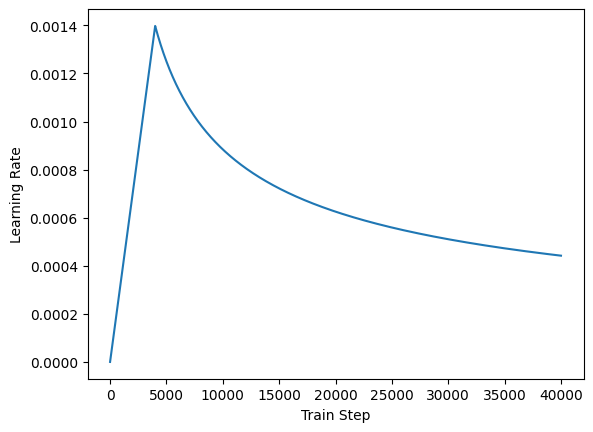

In [ ]:
plt.plot(learning_rate(tf.range(40000, dtype=tf.float32)))
plt.ylabel('Learning Rate')
plt.xlabel('Train Step')

Next, you set up the loss. Since the target sequences are padded, it is important to apply a padding mask when calculating the loss.

You will use the sparse categorical cross-entropy loss function (`tf.keras.losses.SparseCategoricalCrossentropy`) and set the parameter `from_logits` to False since the Transformer does not output raw logits since the last layer has a softmax activation:

In [ ]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False, reduction='none')

def masked_loss(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0))
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask

    return tf.reduce_sum(loss_)/tf.reduce_sum(mask)


train_loss = tf.keras.metrics.Mean(name='train_loss')

# Here you will store the losses, so you can later plot them
losses = []

Now you can define your custom training function. If you are not very advanced with tensorflow, you can understand this function as an alternative to using `model.compile()` and `model.fit()`, but with added extra flexibility.

In [ ]:
@tf.function
def train_step(model, inp, tar):
    """
    One training step for the transformer
    Arguments:
        inp (tf.Tensor): Input data to summarize
        tar (tf.Tensor): Target (summary)
    Returns:
        None
    """
    tar_inp = tar[:, :-1]
    tar_real = tar[:, 1:]

    # Create masks
    enc_padding_mask = create_padding_mask(inp)
    look_ahead_mask = create_look_ahead_mask(tf.shape(tar_inp)[1])
    dec_padding_mask = create_padding_mask(inp) # Notice that both encoder and decoder padding masks are equal

    with tf.GradientTape() as tape:
        predictions, _ = model(
            inp,
            tar_inp, 
            True, 
            enc_padding_mask, 
            look_ahead_mask, 
            dec_padding_mask
        )
        loss = masked_loss(tar_real, predictions)

    gradients = tape.gradient(loss, transformer.trainable_variables)    
    optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))

    train_loss(loss)

<a name='11'></a>
## 11 - Summarization

The last thing you will implement is inference. With this, you will be able to produce actual summaries of the documents. You will use a simple method called greedy decoding, which means you will predict one word at a time and append it to the output. You will start with an `[SOS]` token and repeat the word by word inference until the model returns you the `[EOS]` token or until you reach the maximum length of the sentence (you need to add this limit, otherwise a poorly trained model could give you infinite sentences without ever producing the `[EOS]` token.

<a name='ex-5'></a> 
### Exercise 5 - next_word
Write a helper function that predicts the next word, so you can use it to write the whole sentences. Hint: this is very similar to what happens in the train_step, but you have to set the training of the model to False.

In [ ]:
def next_word(model, encoder_input, output):
    """
    Helper function for summarization that uses the model to predict just the next word.
    Arguments:
        encoder_input (tf.Tensor): Input data to summarize
        output (tf.Tensor): (incomplete) target (summary)
    Returns:
        predicted_id (tf.Tensor): The id of the predicted word
    """
    # Create a padding mask for the input (encoder)
    enc_padding_mask = create_padding_mask(encoder_input)
    # Create a look-ahead mask for the output
    look_ahead_mask = create_look_ahead_mask(tf.shape(output)[1])
    # Create a padding mask for the input (decoder)
    dec_padding_mask = create_padding_mask(encoder_input)

    # Run the prediction of the next word with the transformer model
    predictions, attention_weights = model(
        encoder_input,
        output,
        False,
        enc_padding_mask,
        look_ahead_mask,
        dec_padding_mask
    )

    predictions = predictions[: ,-1:, :]
    predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
    
    return predicted_id

Check if your function works.

In [ ]:
# Take a random sentence as an input
input_document = tokenizer.texts_to_sequences(["a random sentence"])
input_document = tf.keras.preprocessing.sequence.pad_sequences(input_document, maxlen=encoder_maxlen, padding='post', truncating='post')
encoder_input = tf.expand_dims(input_document[0], 0)

# Take the start of sentence token as the only token in the output to predict the next word
output = tf.expand_dims([tokenizer.word_index["[SOS]"]], 0)

# predict the next word with your function
predicted_token = next_word(transformer, encoder_input, output)
print(f"Predicted token: {predicted_token}")

predicted_word = tokenizer.sequences_to_texts(predicted_token.numpy())[0]
print(f"Predicted word: {predicted_word}")

Predicted token: [[14859]]
Predicted word: masses


In [ ]:
def summarize(model, input_document):
    """
    A function for summarization using the transformer model
    Arguments:
        input_document (tf.Tensor): Input data to summarize
    Returns:
        _ (str): The summary of the input_document
    """    
    input_document = tokenizer.texts_to_sequences([input_document])
    input_document = tf.keras.preprocessing.sequence.pad_sequences(input_document, maxlen=encoder_maxlen, padding='post', truncating='post')
    encoder_input = tf.expand_dims(input_document[0], 0)
    
    output = tf.expand_dims([tokenizer.word_index["[SOS]"]], 0)
    
    for i in range(decoder_maxlen):
        predicted_id = next_word(model, encoder_input, output)
        output = tf.concat([output, predicted_id], axis=-1)
        
        if predicted_id == tokenizer.word_index["[EOS]"]:
            break

    return tokenizer.sequences_to_texts(output.numpy())[0]  # since there is just one translated document

Now you can already summarize a sentence! But beware, since the model was not yet trained at all, it will just produce nonsense.

In [ ]:
training_set_example = 0

# Check a summary of a document from the training set
print('Training set example:')
print(document[training_set_example])
print('\nHuman written summary:')
print(summary[training_set_example])
print('\nModel written summary:')
summarize(transformer, document[training_set_example])

Training set example:
[SOS] amanda: i baked  cookies. do you want some?  jerry: sure!  amanda: i'll bring you tomorrow :-) [EOS]

Human written summary:
[SOS] amanda baked cookies and will bring jerry some tomorrow. [EOS]

Model written summary:


"[SOS] masses kindergarten concept kindergarten concept bloomer wilingness sux sam kindergarten lisabeth kindergarten sawyer's sawyer's masses concept bloomer lisabeth bloomer wilingness 80000 bt hotsummer hoax hoax kieslowski wilingness 80000 dont't elis' 🐶❤️👍 cots saaaad evelynn inexperienced suji zubac forthcoming callum farmers extraordinary callum kindergarten worthy extraordinary readable 🐶❤️👍 thinkgn 🐶❤️👍 cots"

<a name='12'></a>
# 12 - Train the model

Now you can finally train the model. Below is a loop that will train your model for 20 epochs. note that it should take about 30 seconds per epoch (with the exception of the first few epochs which can take a few minutes each).

Note that after each epoch you perform the summarization on one of the sentences in the test set and print it out, so you can see how your model is improving.

In [ ]:
# Take an example from the test set, to monitor it during training
test_example = 0
true_summary = summary_test[test_example]
true_document = document_test[test_example]

# Define the number of epochs
epochs = 20

# Training loop
for epoch in range(epochs):
    
    start = time.time()
    train_loss.reset_states()
    number_of_batches=len(list(enumerate(dataset)))

    for (batch, (inp, tar)) in enumerate(dataset):
        print(f'Epoch {epoch+1}, Batch {batch+1}/{number_of_batches}', end='\r')
        train_step(transformer, inp, tar)
    
    print (f'Epoch {epoch+1}, Loss {train_loss.result():.4f}')
    losses.append(train_loss.result())
    
    print (f'Time taken for one epoch: {time.time() - start} sec')
    print('Example summarization on the test set:')
    print('  True summarization:')
    print(f'    {true_summary}')
    print('  Predicted summarization:')
    print(f'    {summarize(transformer, true_document)}\n')

Epoch 1, Loss 7.887531
Time taken for one epoch: 65.512282371521 sec
Example summarization on the test set:
  True summarization:
    [SOS] hannah needs betty's number but amanda doesn't have it. she needs to contact larry. [EOS]
  Predicted summarization:
    [SOS] [EOS]

Epoch 2, Loss 6.600931
Time taken for one epoch: 24.079346179962158 sec
Example summarization on the test set:
  True summarization:
    [SOS] hannah needs betty's number but amanda doesn't have it. she needs to contact larry. [EOS]
  Predicted summarization:
    [SOS] is going to the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the the

Epoch 3, Loss 6.032231
Time taken for one epoch: 16.608251571655273 sec
Example summarization on the test set:
  True summarization:
    [SOS] hannah needs betty's number but amanda doesn't have it. she needs to contact larry. [EOS]
  Predicted summarizat

Plot the loss funtion.

Text(0.5, 0, 'Epoch')

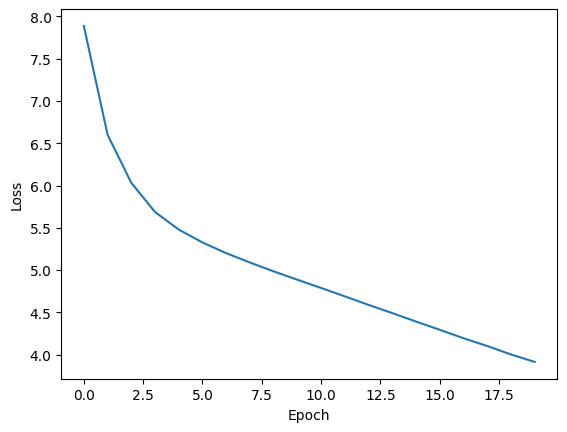

In [ ]:
plt.plot(losses)
plt.ylabel('Loss')
plt.xlabel('Epoch')

<a name='13'></a>
# 13 - Summarize some Sentences!

Below you can see an example of summarization of a sentence from the training set and a sentence from the test set. See if you notice anything interesting about them!

In [ ]:
training_set_example = 0

# Check a summary of a document from the training set
print('Training set example:')
print(document[training_set_example])
print('\nHuman written summary:')
print(summary[training_set_example])
print('\nModel written summary:')
print(summarize(transformer, document[training_set_example]))

Training set example:
[SOS] amanda: i baked  cookies. do you want some?  jerry: sure!  amanda: i'll bring you tomorrow :-) [EOS]

Human written summary:
[SOS] amanda baked cookies and will bring jerry some tomorrow. [EOS]

Model written summary:
[SOS] amanda will bring some cookies [EOS]


In [ ]:
test_set_example = 3

# Check a summary of a document from the test set
print('Test set example:')
print(document_test[test_set_example])
print('\nHuman written summary:')
print(summary_test[test_set_example])
print('\nModel written summary:')
print(summarize(transformer, document_test[test_set_example]))

Test set example:
[SOS] will: hey babe, what do you want for dinner tonight?  emma:  gah, don't even worry about it tonight  will: what do you mean? everything ok?  emma: not really, but it's ok, don't worry about cooking though, i'm not hungry  will: well what time will you be home?  emma: soon, hopefully  will: you sure? maybe you want me to pick you up?  emma: no no it's alright. i'll be home soon, i'll tell you when i get home.   will: alright, love you.   emma: love you too.  [EOS]

Human written summary:
[SOS] emma will be home soon and she will let will know. [EOS]

Model written summary:
[SOS] emma will pick up with emma at home tonight [EOS]


# Transfer Learning

There are three main advantages to transfer learning:

* Reduce training time

* Improve predictions

* Allows you to use smaller datasets

Two methods that you can use for transfer learning are the following:

![alt text](W4YQlB0zSEqGEJQdM9hKcg_4d6e519c7c0845b888958ac524eb6b47_Screen-Shot-2021-01-22-at-10.54.45-AM.png)

In feature based transfer learning, you learn word embeddings by training one model and then you use those word embeddings in a different model on a different task.

When fine tuning, you can use the exact same model and just run it on a different task. Sometimes when fine tuning, you can keep the model weights fixed and just add a new layer that you will train. Other times you can slowly unfreeze the layers one at a time. You can also use unlabelled data when pre-training, by masking words and trying to predict which word was masked.

![alt text](Qlq55HBKTBCaueRwSgwQ1A_3726fb44c6914d0bbed3d98cc096bfb5_Screen-Shot-2021-01-22-at-11.40.19-AM.png)

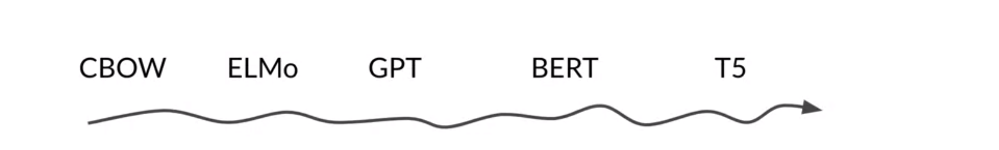

### CBOW

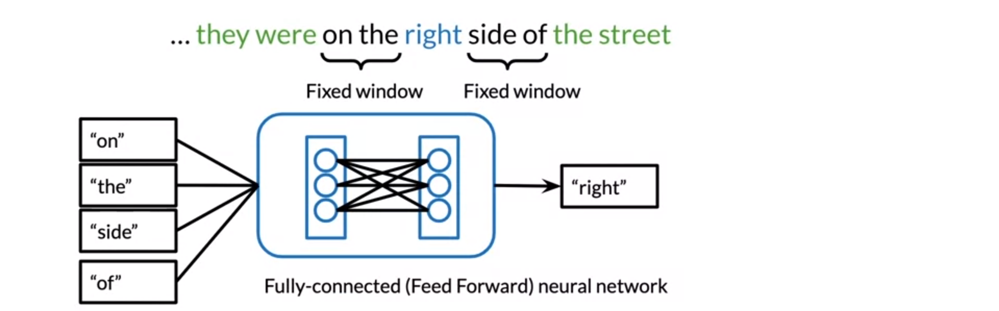

The continuous bag of words over here, you have the word right. Previously what you've been doing, you would take a fixed window, say two before and two after, or three or four, whatever as CS is for the window size. Then you'll take the corresponding words, feed them into a neural network, and predict the central word in this case, which is right. Now the issue over here is that, what if we wanted to look at not only the fixed window, but all the words before and all the words after.

### ELMo

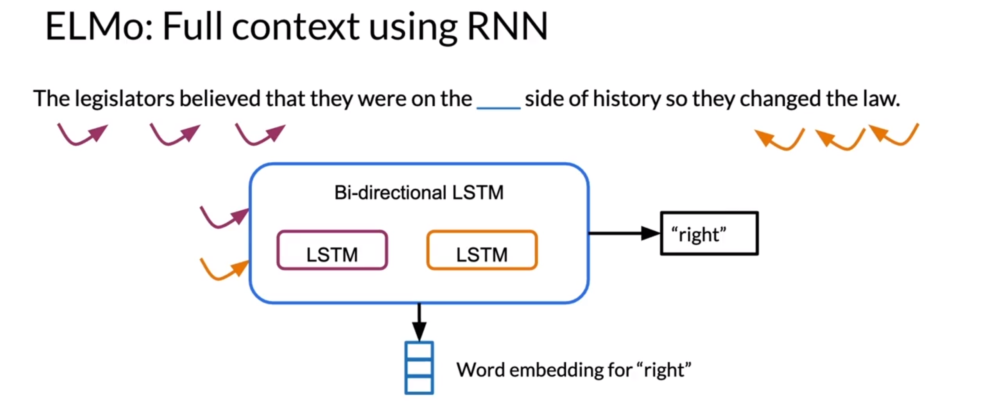

To use all of the context words, what researchers have done, they explored the following using RNN. They would use an RNN from the right and from the left. Then they would have a bi-directional LSTM, which is a version of recurrent neural network. You feed both of them in. Then you can predict the center word right. That gives you the word embedding for the word, right. 

### GPT

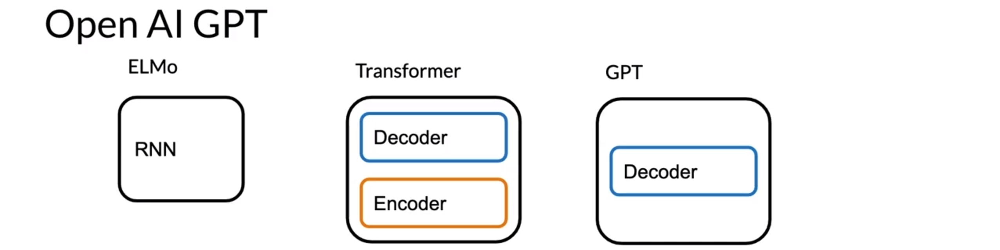

Now, open AI GPT what it did. We had transformer, the encoder decoder architecture that you're familiar with. Then we ended up having this GPT which makes use of a decoder of stacks only. In this case we only have one decoder, but you can have several decoders in the picture. ELMo made use of RNNs or LSTMs. We would use these models to predict the central word. 

### Why not use a bi-directional model?

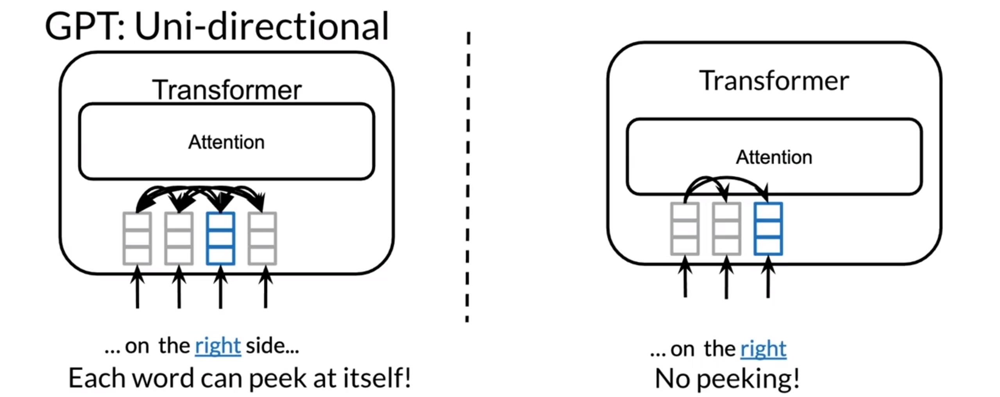

In this case, this is the transformer, and you can see that in the transformer over here, each word can peek at itself. If we were to use it for under, right, you can only look at itself. But the issue is that you cannot peek forward. Remember, you've seen this in causal attention where you don't look forward you only look at the previous ones. 

### BERT

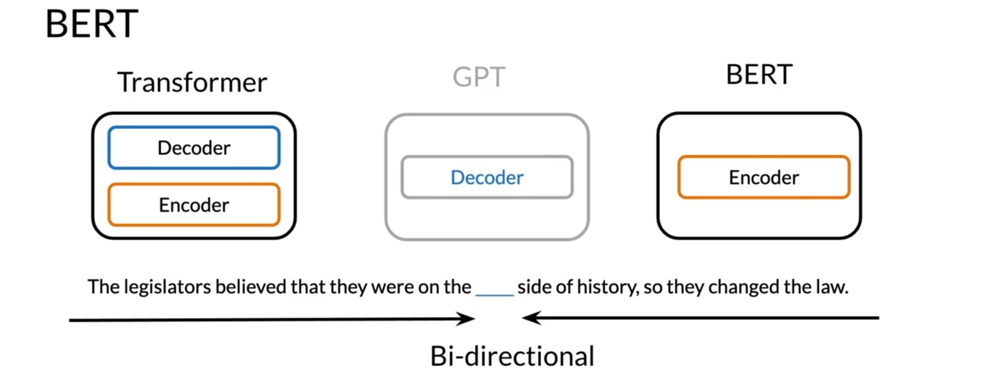

BERT came and helped us solve this problem. This is a recap. Transformers, encoder decoder, GPT makes use of decoders and BERTs makes use of encoders. Over here you have the Legislature believed that they were on the blank side of history, so they changed the law. Over here we can make use of bi-directional encoder representations from transformers and this will help us solve this issue. 

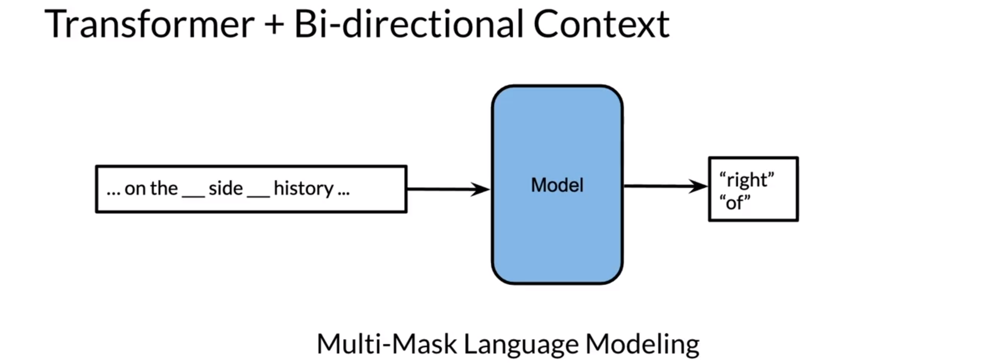

This is an example of a transformer plus bi-directional context. You feed this into your model and then you get right and of. Because of this, you're able to look at the sentence from the beginning and from the end and make use of the context to predict the corresponding words. 

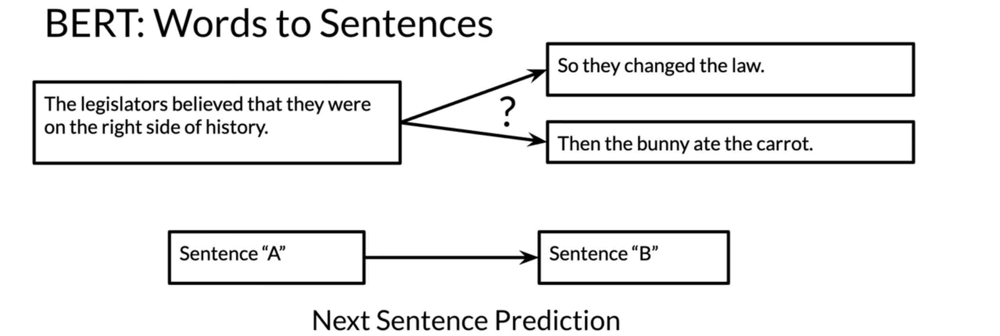

If we're to look at words to sentences, meaning instead of trying to predict just the word, we'll try to predict what the next sentence is. Given the sentence over here, the legislators believed that they were on the right side of history. Is this the next sentence or is this the next sentence? You have a sentence A and then you try to predict the next sentence B. In this case it's obviously so they changed the law. 

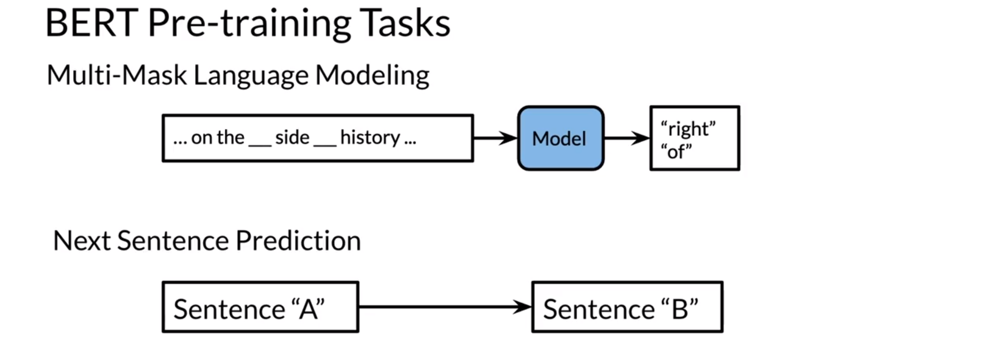

BERT pre-training tasks makes use of multi-mask language modeling. The same thing that you've seen before and it makes use of the next sentence prediction. It takes two sentences and it predicts whether it's a yes meaning sentence two follow sentence one, or sentence B follow sentence A or not. Let's look at encoder versus encoder decoder. Over here you have the transformer, which had the encoder and the decoder stack. Then you had GPT, which just had decoder stack, and then BERT, just the encoder stack.

### T5

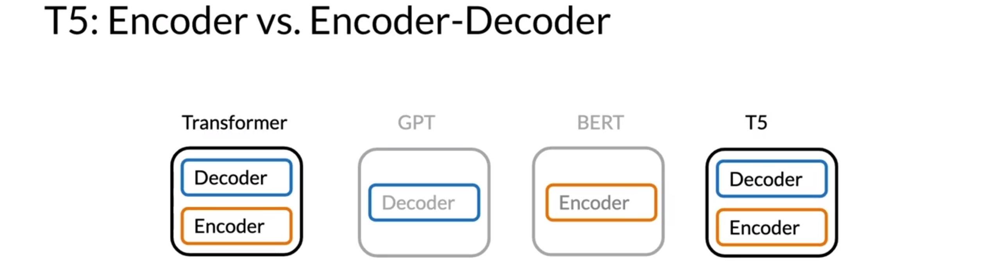

T5 tested the performance when using the encoder decoder as in the original transformer model. The researchers found that the model performed better when it contained both the encoder and the decoder stacks. 

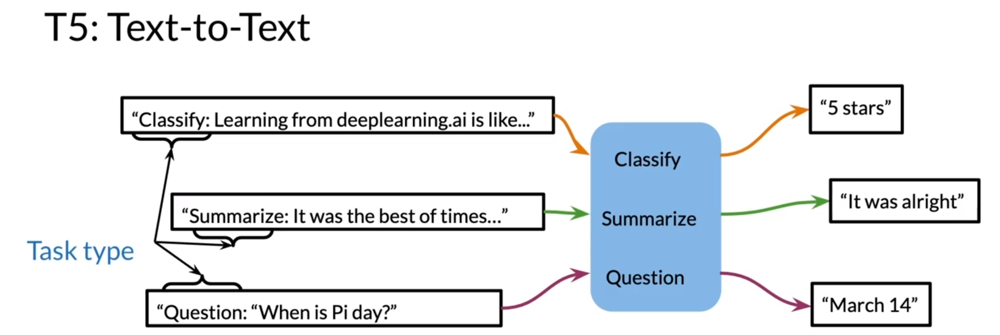

Let's look at the multi-task training strategy over here so you have studying with deeplearning.ai was. It's being fed into the model and it gives you a five star rating. Hopefully it's a five star rating. Then you have a question and then you get the answer. But the question here is, how do you make sure that the model knows which task it's performing in? Because you can feed in a review over here. How do you know that it's not going to return an answer instead? How do you know it's going to return a rating? Or if you feed in a question, how do you know it's not going to return some numerical outputs or some text version of a numerical output? Let's see how to do this. Over here is an example where, let's say you're trying to classify whether this is five stars or four stars or three stars. You append the string, classify for example. Then it classifies it and you get five stars. Let's say you want to summarize, so you add the string summarize colon. It goes into the model. It's automatically identifies that you're trying to summarize and it says that it was all right. You have a question you append question string. It knows that it's a question and it returns the answer. Now, this might not be the exact text that you'll find in the paper, but it gives you the overall sense of the idea.

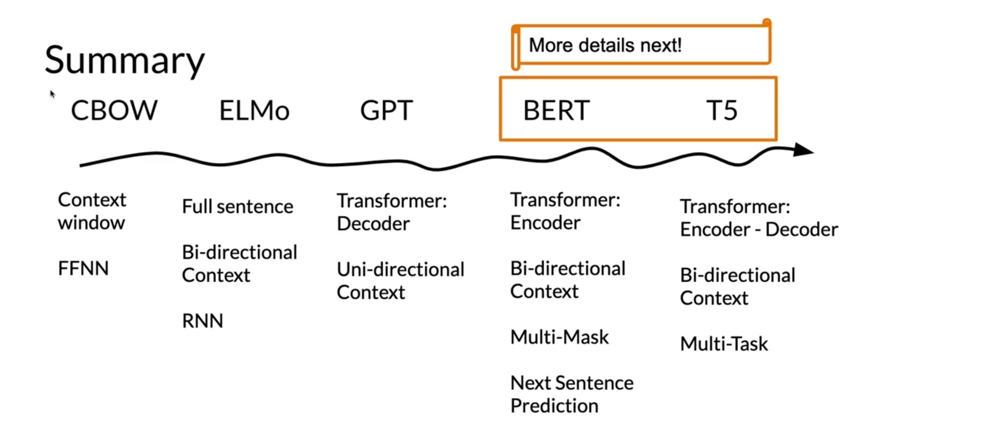

In summary, you've seen the continuous bag of words model, which makes use of a fixed context window. You've seen ELMo, which makes use of a bi-directional LSTM. You've seen GPT, which is just a decoder stack, and you can see uni-directional in context. Then you've seen BERT, which makes use of bi-directional encoder representation from the transformer, and it also makes use of multi-mask language modeling and next sentence prediction. Then you've seen the T5 which makes use of the encode decoder stack and also makes use of mask and multi-task training.

# BERT

![alt text](SxUSIdFFSh2VEiHRRbodjg_0ebf4a9715d44801b2ab1e255a7fd9d9_Screen-Shot-2021-01-22-at-12.34.46-PM.png)

There are two steps in the BERT framework: pre-training and fine-tuning. During pre-training, the model is trained on unlabeled data over different pre-training tasks.  For fine tuning, the BERT model is first initialized with the pre-trained parameters, and all of the parameters are fine-tuned using labeled data from the downstream tasks. For example, in the figure above, you get the corresponding embeddings for the input words, you run it through a few transformer blocks, and then you make the prediction at each time point T.

During pretraining:

* Choose 15% of the tokens at random: mask them 80% of the time, replace them with a random token 10% of the time, or keep as is 10% of the time.  

* There could be multiple masked spans in a sentence

* Next sentence prediction is also used when pre-training.


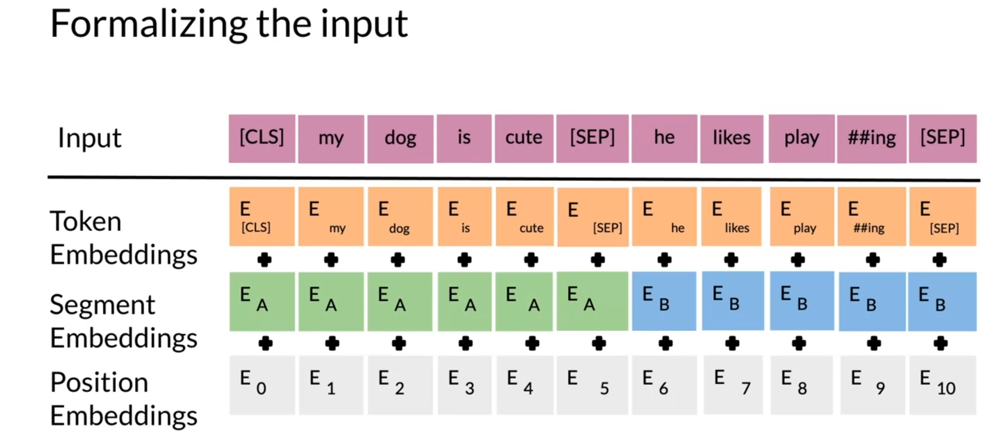

Formalizing the input, this is the BERT input representation. 
* You start with position embeddings. They allow you to indicate the position in the sentence of the word where each word is in the corresponding sentence. So you have this. 
* Then you have the segment embeddings. They allow you to indicate whether it's a sentence A or sentence B because remember in BERT you also use next sentence prediction. 
* Then you have the token embeddings or the input embeddings. You also have a CLS token, which is used to indicate the beginning of the sentence, and a SEP token, which is used to indicate the end of the sentence. 
* Then what you do, you just take the sum of the token embeddings, the segmentation embeddings, and the position embeddings, and then you get your new input.

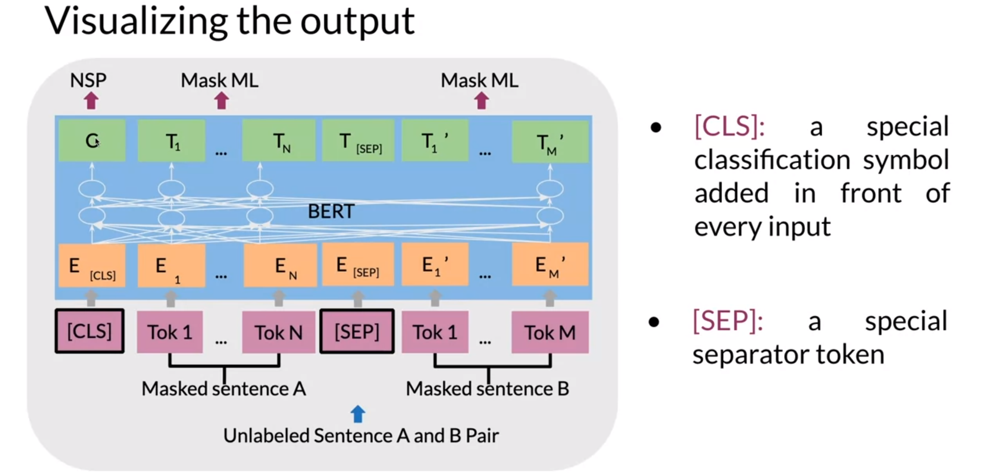

Over here you can see you have masked sentence A, you have masked sentence B, they go into tokens, and then you have the CLS token, which is a special classification symbol added in front of every input. Then you have the SEP token, which is the special separator token. You convert them into the embeddings so then you get your transformer blocks. Then you can see at the end you get your T_1 to T_N, your T_1 prime to T_M prime. Each T_I embedding will be used to predict the masked word via a simple softmax. You have this C also, embedding, which can be used for next sentence prediction. 

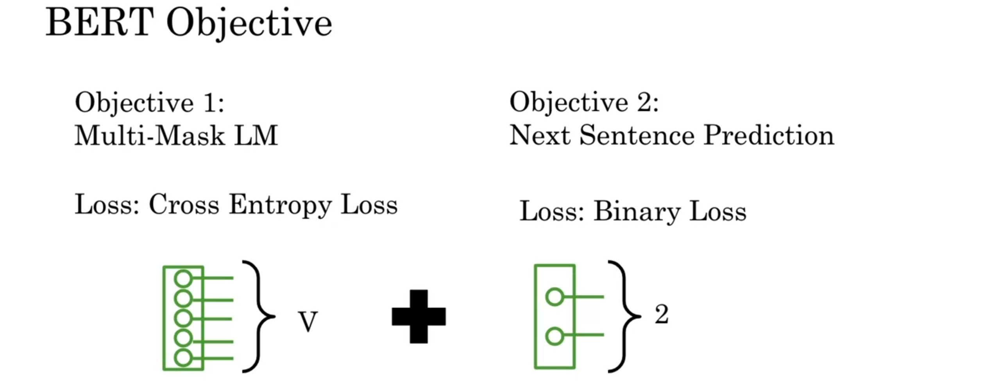

Let's look at the BERT objective now. For the Multi-Mask language model, you use a cross-entropy loss to predict the word that's being masked or the words that are being masked, and then you add this to a binary loss for the next sentence prediction so given the two sentences do they follow one another or not? In summary, you've seen the BERT objective and you've seen the model inputs and outputs.

## Fine tuning BERT

What are the advantages of Fine-tuning?

* Much less time is needed to train the fitted model

* Allows to adjust the task with a much smaller dataset

* Achieves good results with minimal task-specific adjustments for a wide variety of tasks.



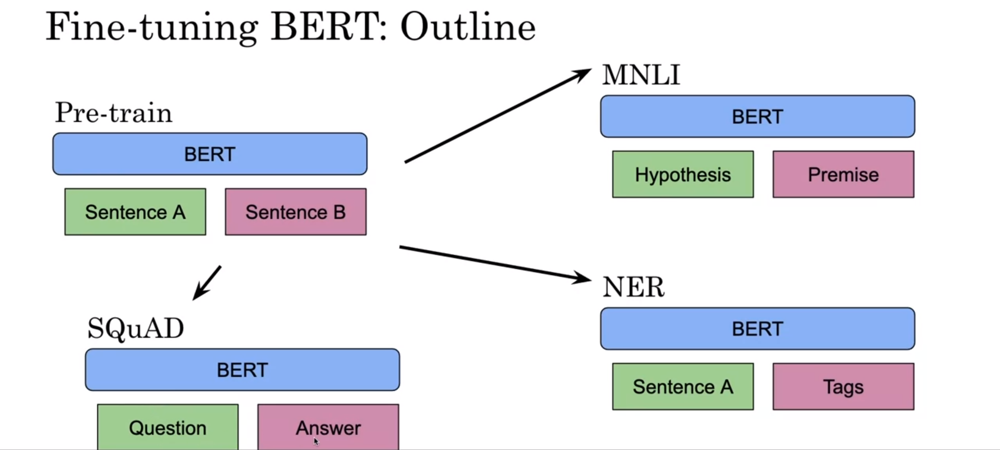

So right now you're going to see how you fine tune BERT. So during pre training remember you had sentence A and sentence B, and then you use next sentence prediction and use the mask tokens to predict the mask tokens that you mask from each sentence. So that's in pre training. Now if you want to go on to MNLI or like hypothesis premise scenario, then instead of having sentence A and sentence B, you're going to feed in the hypothesis over here, and the premise over here. For NER you going to feed in the sentence A over here, and then the corresponding tags over here. For question answering, you will have SQuAD, for example, you'll have your question over here and then your answer over here.

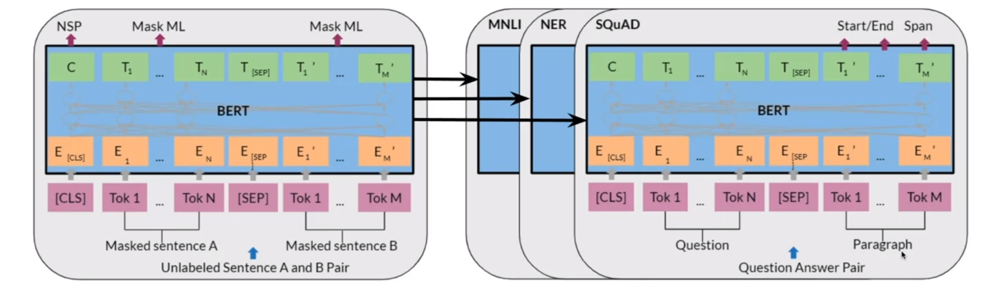

So visually what does this look like? So remember this image from the BERT paper. So this is what ends up happening. Over here you have the question, over here you'll have the paragraph and this will give you like your answer, that starts in the end for the answer. Then for NER again, you'll have the sentence and the correspondent named entities. For MNLI you'll have the hypothesis and then the premise and so forth. 

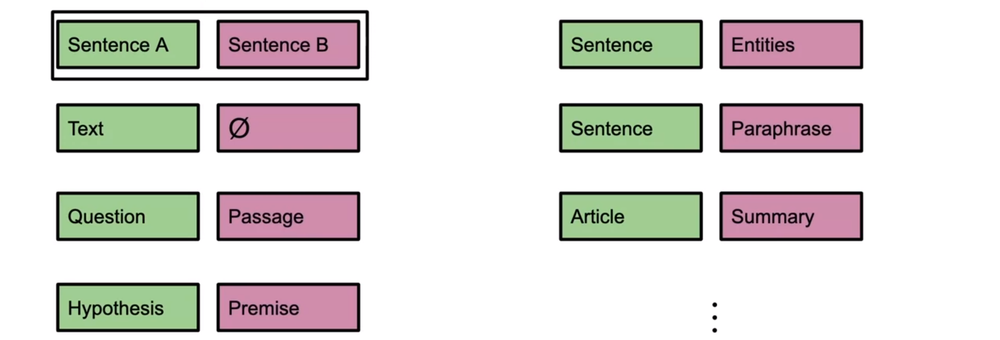

So in summary, given the place of sentence A and sentence B, you can fill it with a text in parts four sentence A, and then say like a no symbol to say that you're trying to classify the text whether it's for sentiment analysis, like happy or sad. So that's the only way to do it. Question passage for question answering. You could have hypothesis premise for MNLI. You could have sentence with the named entities for NER, you can have sentence and a paraphrase of the sentence. You could have an article in the summary and so forth. So this is just the inputs into your BERT model. Now that you know how to fine tune your model on classification tasks, question answering, summarization and many more things, we'll take it to the next level and introduce you to a new model known as the T5.

# T5

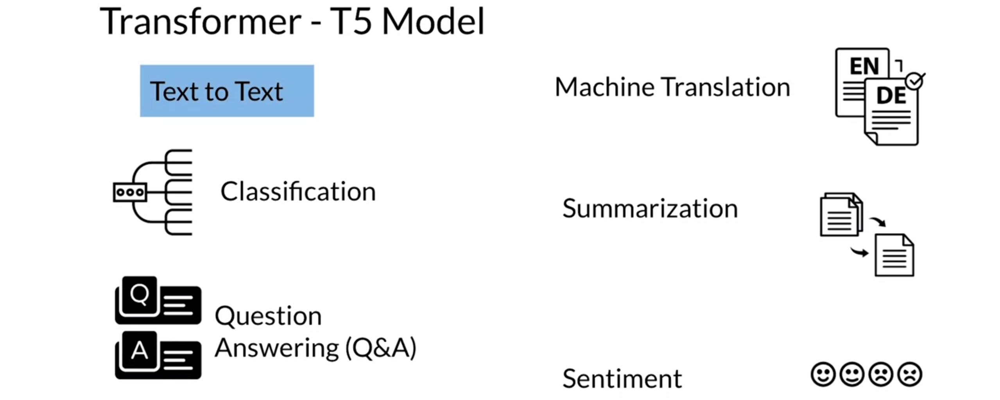

So T5 transformers known as the text to text transformer and you can use it:
* in classification, 
* for question answering to answer a question, 
* for machine translation, 
* for summarization 
* for sentiments,
* there are other applications that you can use T5 for.



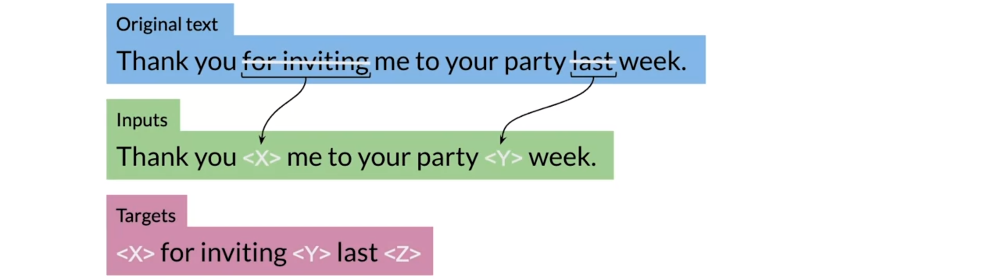

So the model architecture and the way the pre training is done first of all is you have an original text, something like this where you have thank you for inviting me to your party last week. So you mask the certain words, so for inviting me last and then you replace it with these tokens like brackets X, brackets Y. So brackets X corresponding to for inviting and brackets why corresponding to last. And your targets are going to be brackets X for inviting brackets Y last. And these tokens or these brackets like they keep going in increments order, so then it's bracket Z, then maybe brackets A brackets B and so forth. So each brackets corresponds to a certain targets.

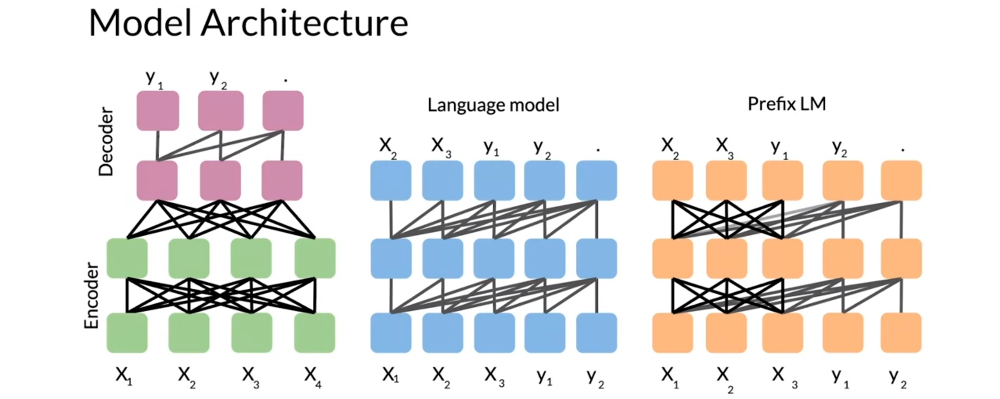

The model architecture and a different transformer architectural variants that we're going to consider for the attention party are. So we start with the basic encoder decoder representation. So you can see over here you have fully visible attention in the encoder and then causal attention in the decoder and then you have the general encoder decoder representation just as a notation. So light gray lines correspond to causal masking and dark gray lines correspond to the fully visible masking. So on the left, as I said again, it's the standard encoder decoder architecture in the middle over here what we have we have the language model which consists of a single transformer layers stack and it's being fed the concatenation of the input and the target. So it uses causal masking throughout as you can see because they're all great lines and you have X1 going inside over here, get a X2. X two goes into the model X three and so forth. Now over here to the right we have prefix language model which corresponds to allowing fully visible masking over the inputs as you can see here in the dark arrows and then causal masking in the rest. So as you can see over here it's doing causal masking. 

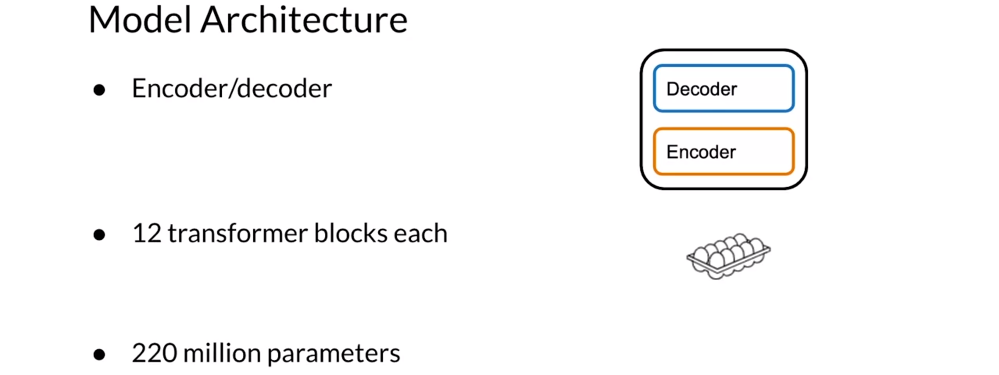

So the model architecture which uses encoder decoder stack, it has 12 transformer blocks each. So you can think of it as a dozen X and then 220 million parameters. So in summary, you've seen prefix language model attention, you've seen the model architecture for T5 and you've seen how the pre training is done similar to birds, but we just use masked language modeling here.

## Multi-Task Training Strategy

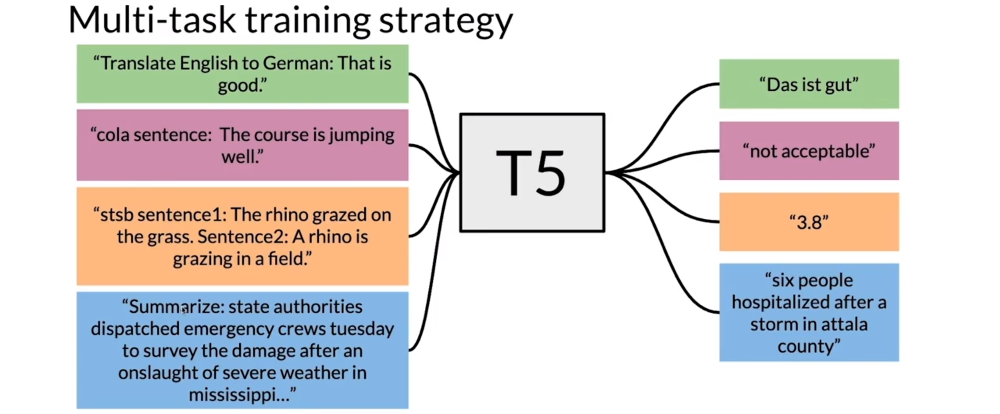

So the multitask training strategy works as follow. So if you want to translate from English to German, you append the prefix translate English to German, and it gives you the corresponding translation. For cola sentence like, the course is jumping well, and it says it's not acceptable because it's grammatically incorrect. If you have two sentences and you want to identify their similarity, you put in the stsp sentence 1, and then sentence 2 inside over here, sentence 1, sentence 2. And then you get the corresponding score. If you want to summarize, you add the summarize prefix to the article or the text you want to summarize and it gives you the summary. 

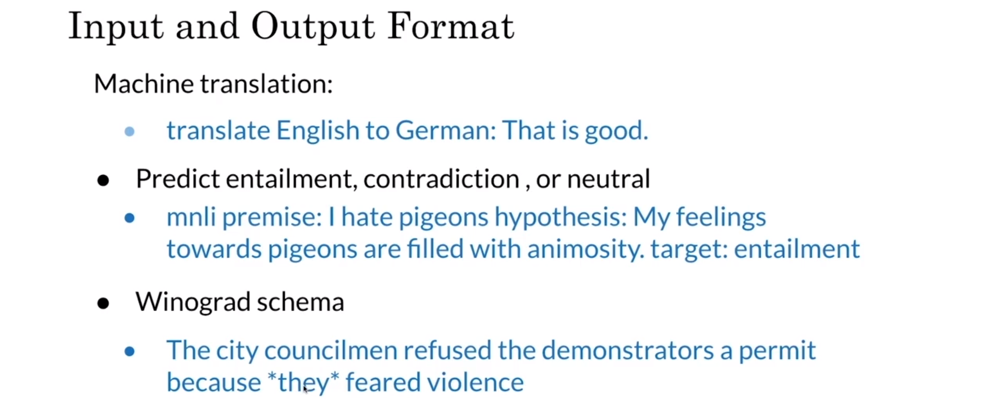

Inputs and outputs format, so for machine translation you just do translate blank to blank and you add the sentence. To predict entailments, contradiction, or whether it's neutral, you would feed in something as follows, so nnli premise, I hate pigeons, then the hypothesis, my feelings towards pigeons are filled with animosity, and the target is entailment. So basically over here, this is going to try to learn the overall structure of entailment, and by feeding in the entire thing, the model would have full visibility over the entire input, and then it would be tasked with marking a classification by outputting the word entailment. So it is easy for the model to learn to predict one of the correct class labels given the task prefix mnli, in this case. If you know the main difference between prefix LM and the BERT architecture is that the classifier is integrated to the output layer of the transformer decoder in the prefix LM. And over here you have the Winograd schema, which is another way to predict whether a pronoun, for example, over here, the city councilmen refused the demonstrators a permit because they feared violence. So you're going to feed this into your model, and then it will be tasked to predict they as the city councilmen. 

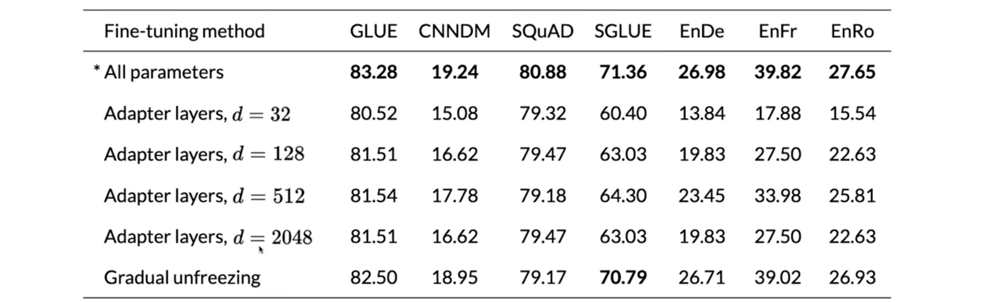

So for multi-task training strategy, this is a table found in the original paper, and we'll talk about what the GLUE benchmark is, and these other benchmarks, you can check them out. But these are the scores reported, and you can see that the T5 paper actually reaches states of the art in many tasks. 

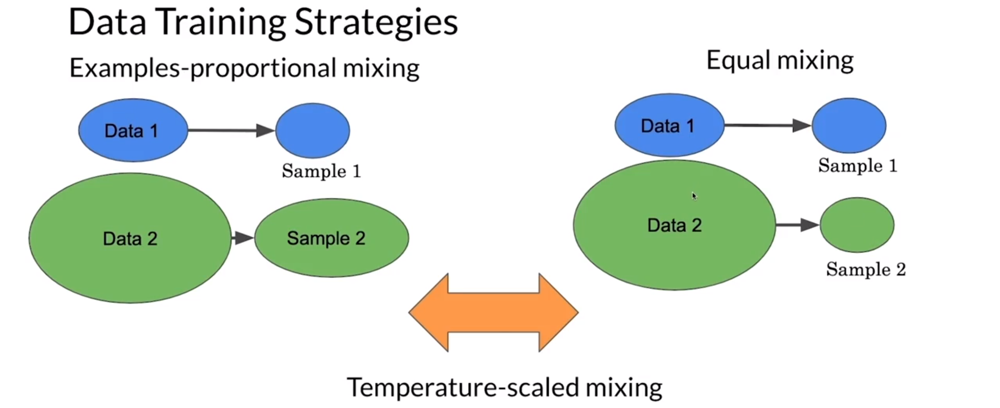

So how much data from each task you train on? So for the data training strategies, there is examples proportional mixing, and in this case, what you end up doing, you take an equal proportion, say, like 10% from each data that you have. And if the first data sets, for example, blue, you take 10% of this, then you'll get 10% over here, 10% of this is larger, and 10% is just a random number I picked, but you get the point. For the other type of data training strategy is equal mixing, so regardless of the size of each data, you take an equal sample. And then there is something in the middle called temperature-scaled mixing, where you try to play with the parameters to get something in between. 

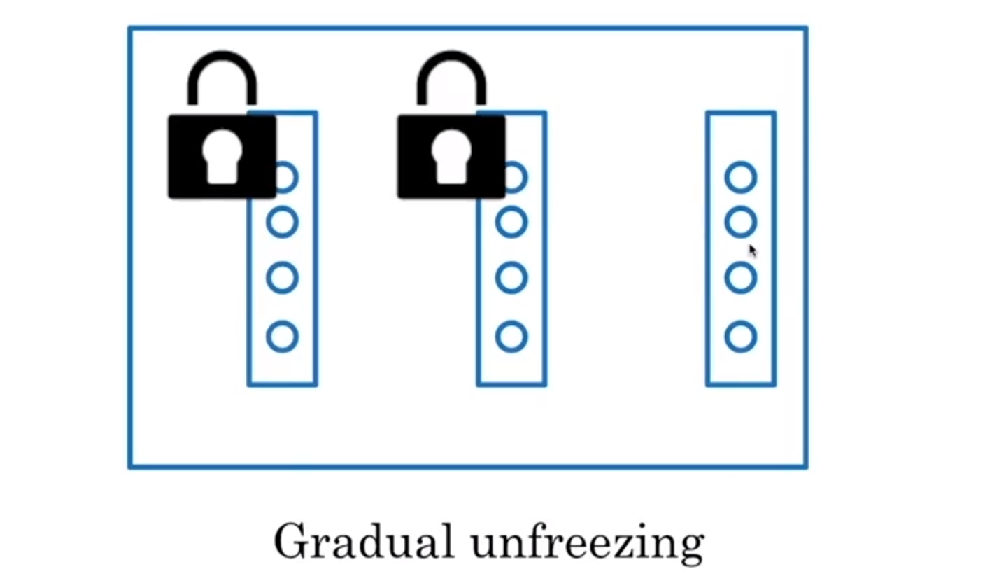

Now, we'll talk about gradual unfreezing versus adapter layers. So in **gradual unfreezing**, what ends up happening, you unfreeze one layer at a time. So you say this is your neural network, unfreezing the last one, you fine-tune using that, you keep the others fixed, then unfreezing this one, and then you unfreeze this one, so you keep unfreezing each layer. 

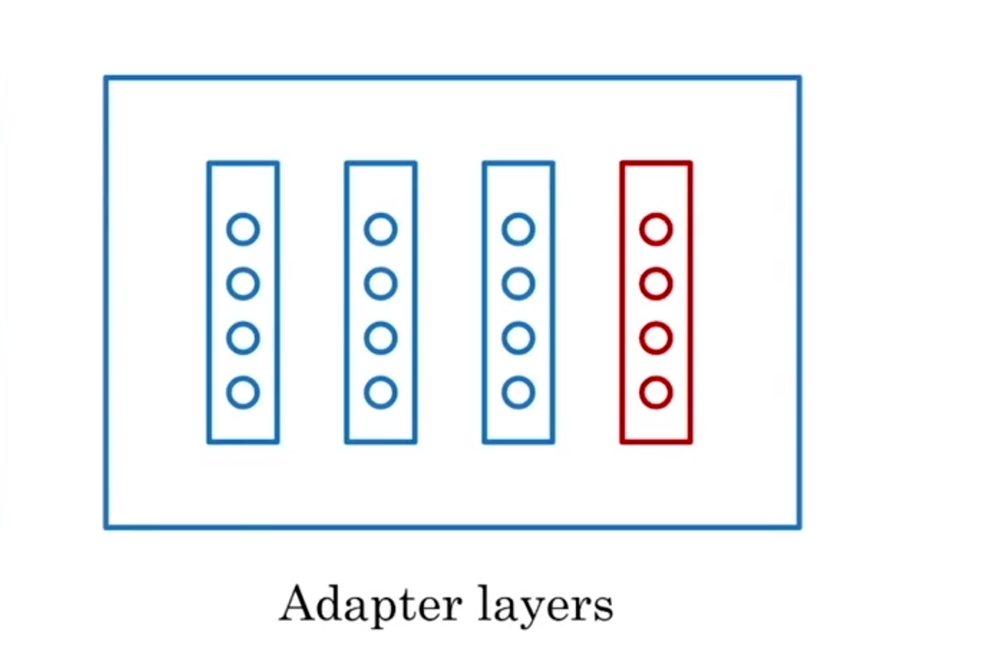

And for the **adapter layers**, you basically, add a neural network to each feed-forward in each block of the transformer. And then, these new feed-forward networks, they're designed so that the output dimension matches the input. And this allows them to be inserted without having any structural change. When fine-tuning only these new adapter layers and the layer normalization parameters are being updated. 

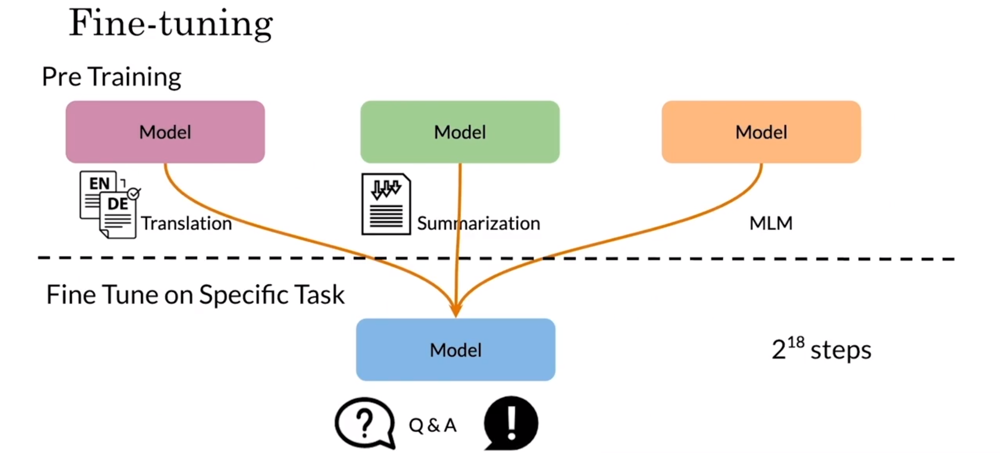

So we'll talk now a bit more about fine-tuning. The approach that's usually being used here has the goal of training a single model that can simultaneously perform many tasks at once, for example, the model, most of its parameters are shared across all of the tasks. And we might train a single model on many tasks, but when reporting performance, we can select a different checkpoint for each task. So over here, the task could be like translation, summarization, or masked language modeling. And they do the train in 2 to the power of 18 steps. 

# GLUE Benchmark

The GLUE Benchmark. This is used to train, evaluate, analyze NLP tasks.

The glue benchmark stands for General Language Understanding Evaluation. It is basically a collection that is used to train, evaluate, analyze natural language understanding systems. It has a lot of datasets and each dataset has several genres and there are different sizes and different difficulties. Some of them are, for example, used for co-reference resolution. Others are just used for simple sentiment analysis, others are used for question answering, and so forth. It is used with a leaderboard, so people can use the datasets and see how well their models perform compared to others. 

Tasks evaluated on could be:
* sentence grammatical or not, 
* if a sentence makes sense or it does not, 
* on sentiment, 
* to paraphrase some texts, 
* on similarity, 
* on question duplicates,
* whether a question is answerable or not, 
* whether it's a contradiction, 
* whether it's entailment,
* for the Winograd schema, which is basically trying to identify whether a pronoun refers to a certain noun or to another noun. 

It's used: 
* to drive research. As I said, that researchers usually use the GLUE as a benchmark. 
* it is also a model agnostic, so it doesn't matter which model you use. Just evaluate on GLUE and see how well your model performs. 
* it allows you to make use of transfer learning because you have access to several datasets and you can learn certain things from different datasets that will help you evaluate on a completely new datasets within GLUE. 

# SentencePiece and BPE

In order to process text in neural network models it is first required to **encode** text as numbers with ids, since the tensor operations act on numbers. Finally, if the output of the network is to be words, it is required to **decode** the predicted tokens ids back to text.

To encode text, the first decision that has to be made is to what level of granularity are we going to consider the text? Because ultimately, from these **tokens**, features are going to be created about them. Many different experiments have been carried out using *words*, *morphological units*, *phonemic units* or *characters* as tokens. For example, 

- Tokens are tricky. (raw text)
- Tokens are tricky . ([words](https://arxiv.org/pdf/1301.3781))
- Token s _ are _ trick _ y . ([morphemes](https://arxiv.org/pdf/1907.02423.pdf))
- t oʊ k ə n z _ ɑː _ ˈt r ɪ k i. ([phonemes](https://www.aclweb.org/anthology/W18-5812.pdf), for STT)
- T o k e n s _ a r e _ t r i c k y . ([character](https://www.aclweb.org/anthology/C18-1139/))

But how to identify these units, such as words, is largely determined by the language they come from. For example, in many European languages a space is used to separate words, while in some Asian languages there are no spaces between words. Compare English and Mandarin.

- Tokens are tricky. (original sentence)
- 标记很棘手 (Mandarin)
- Biāojì hěn jíshǒu (pinyin)
- 标记 很 棘手 (Mandarin with spaces)


So, the ability to **tokenize**, i.e. split text into meaningful fundamental units, is not always straight-forward.

Also, there are practical issues of how large our *vocabulary* of words, `vocab_size`, should be, considering memory limitations vs. coverage. A compromise may be need to be made between: 
* the finest-grained models employing characters which can be memory intensive and 
* more computationally efficient *subword* units such as [n-grams](https://arxiv.org/pdf/1712.09405) or larger units.

In [SentencePiece](https://www.aclweb.org/anthology/D18-2012.pdf) unicode characters are grouped together using either a [unigram language model](https://www.aclweb.org/anthology/P18-1007.pdf) (used in this week's assignment) or [BPE](https://arxiv.org/pdf/1508.07909.pdf), **byte-pair encoding**. We will discuss BPE, since BERT and many of its variants use a modified version of BPE and its pseudocode is easy to implement and understand... hopefully!

## SentencePiece Preprocessing

### NFKC Normalization

Unsurprisingly, even using unicode to initially tokenize text can be ambiguous, e.g., 

In [ ]:
eaccent = '\u00E9'
e_accent = '\u0065\u0301'
print(f'{eaccent} = {e_accent} : {eaccent == e_accent}') # -> False

SentencePiece uses the Unicode standard normalization form, [NFKC](https://en.wikipedia.org/wiki/Unicode_equivalence), so this isn't an issue. Looking at the example from above but with normalization:

In [ ]:
from unicodedata import normalize

norm_eaccent = normalize('NFKC', '\u00E9')
norm_e_accent = normalize('NFKC', '\u0065\u0301')
print(f'{norm_eaccent} = {norm_e_accent} : {norm_eaccent == norm_e_accent}')  # -> True

Normalization has actually changed the unicode code point (unicode unique id) for one of these two characters.

In [ ]:
def get_hex_encoding(s):
    return ' '.join(hex(ord(c)) for c in s)

def print_string_and_encoding(s):
    print(f'{s} : {get_hex_encoding(s)}') 

In [ ]:
for s in [eaccent, e_accent, norm_eaccent, norm_e_accent]:
    print_string_and_encoding(s)

This normalization has other side effects which may be considered useful such as converting curly quotes &ldquo; to " their ASCII equivalent. (<sup>*</sup>Although we *now* lose directionality of the quote...)

### Lossless Tokenization

SentencePiece also ensures that when you tokenize your data and detokenize your data the original position of white space is preserved. However, tabs and newlines are converted to spaces.

To ensure this **lossless tokenization**, SentencePiece replaces white space with _ (U+2581). So that a simple join of the tokens by replacing underscores with spaces can restore the white space, even if there are consecutive symbols. But remember first to normalize and then replace spaces with _ (U+2581).

In [ ]:
s = 'Tokenization is hard.'
sn = normalize('NFKC', s)
sn_ = sn.replace(' ', '\u2581')

In [ ]:
print(get_hex_encoding(s))
print(get_hex_encoding(sn))
print(get_hex_encoding(sn_))

## BPE Algorithm

After discussing the preprocessing that SentencePiece performs, you will get the data, preprocess it, and apply the BPE algorithm. You will see how this reproduces the tokenization produced by training SentencePiece on the example dataset.

### Preparing our Data
First, you get the Squad data and process it as above.

In [ ]:
import ast

def convert_json_examples_to_text(filepath):
    example_jsons = list(map(ast.literal_eval, open(filepath))) # Read in the json from the example file
    texts = [example_json['text'].decode('utf-8') for example_json in example_jsons] # Decode the byte sequences
    text = '\n\n'.join(texts)       # Separate different articles by two newlines
    text = normalize('NFKC', text)  # Normalize the text

    with open('example.txt', 'w') as fw:
        fw.write(text)
    
    return text

In [ ]:
text = convert_json_examples_to_text('./data/data.txt')
print(text[:900])

In the algorithm the `vocab` variable is actually a frequency dictionary of the words. Those words have been prepended with an *underscore* to indicate that they are the beginning of a word. Finally, the characters have been delimited by spaces so that the BPE algorithm can group the most common characters together in the dictionary in a greedy fashion. You will see how that is done shortly.

In [ ]:
from collections import Counter

vocab = Counter(['\u2581' + word for word in text.split()])
vocab = {' '.join([l for l in word]): freq for word, freq in vocab.items()}

In [ ]:
def show_vocab(vocab, end='\n', limit=20):
    """Show word frequencys in vocab up to the limit number of words"""
    shown = 0
    for word, freq in vocab.items():
        print(f'{word}: {freq}', end=end)
        shown +=1
        if shown > limit:
            break

In [ ]:
show_vocab(vocab)

You check the size of the vocabulary (frequency dictionary) because this is the one hyperparameter that BPE depends on crucially on how far it breaks up a word into SentencePieces. It turns out that for your trained model on the small dataset that 60% of 455 merges of the most frequent characters need to be done to reproduce the upperlimit of a 32K `vocab_size` over the entire corpus of examples.

In [ ]:
print(f'Total number of unique words: {len(vocab)}')
print(f'Number of merges required to reproduce SentencePiece training on the whole corpus: {int(0.60*len(vocab))}')

### BPE Algorithm
Directly from the BPE paper you have the following algorithm. 

In [ ]:
import re, collections

def get_stats(vocab):
    pairs = collections.defaultdict(int)
    for word, freq in vocab.items():
        symbols = word.split()
        for i in range(len(symbols) - 1):
            pairs[symbols[i], symbols[i+1]] += freq
    return pairs

def merge_vocab(pair, v_in):
    v_out = {}
    bigram = re.escape(' '.join(pair))
    p = re.compile(r'(?<!\S)' + bigram + r'(?!\S)')
    for word in v_in:
        w_out = p.sub(''.join(pair), word)
        v_out[w_out] = v_in[word]
    return v_out

def get_sentence_piece_vocab(vocab, frac_merges=0.60):
    sp_vocab = vocab.copy()
    num_merges = int(len(sp_vocab)*frac_merges)
    
    for i in range(num_merges):
        pairs = get_stats(sp_vocab)
        best = max(pairs, key=pairs.get)
        sp_vocab = merge_vocab(best, sp_vocab)

    return sp_vocab

To understand what's going on first take a look at the third function `get_sentence_piece_vocab`. It takes in the current `vocab` word-frequency dictionary and the fraction, `frac_merges`, of the total `vocab_size` to merge characters in the words of the dictionary, `num_merges` times. Then for each *merge* operation it `get_stats` on how many of each pair of character sequences there are. It gets the most frequent *pair* of symbols as the `best` pair. Then it merges that pair of symbols (removes the space between them) in each word in the `vocab` that contains this `best` (= `pair`). Consequently, `merge_vocab` creates a new `vocab`, `v_out`. This process is repeated `num_merges` times and the result is the set of SentencePieces (keys of the final `sp_vocab`).

In a little more detail you can see in `get_stats` you initially create a list of bigram (two character sequence) frequencies from the vocabulary. Later, this may include trigrams, quadgrams, etc. Note that the key of the `pairs` frequency dictionary is actually a 2-tuple, which is just shorthand notation for a pair.

In `merge_vocab` you take in an individual `pair` (of character sequences, note this is the most frequency `best` pair) and the current `vocab` as `v_in`. You create a new `vocab`, `v_out`, from the old by joining together the characters in the pair (removing the space), if they are present in a word of the dictionary.

[Warning](https://regex101.com/): the expression `(?<!\S)` means that either a whitespace character follows before the `bigram` or there is nothing before the bigram (it is the beginning of the word), similarly for `(?!\S)` for preceding whitespace or the end of the word. 

In [ ]:
sp_vocab = get_sentence_piece_vocab(vocab)
show_vocab(sp_vocab) 

## Train SentencePiece BPE Tokenizer on Example Data
### Explore SentencePiece Model
First, explore the SentencePiece model provided with this week's assignment. Remember you can always use Python's built in `help` command to see the documentation for any object or method.

In [ ]:
import sentencepiece as spm
sp = spm.SentencePieceProcessor(model_file='./data/sentencepiece.model')

Try it out on the first sentence of the example text.

In [ ]:
s0 = 'Beginners BBQ Class Taking Place in Missoula!'

# encode: text => id
print(sp.encode_as_pieces(s0))
print(sp.encode_as_ids(s0))

# decode: id => text
print(sp.decode_pieces(sp.encode_as_pieces(s0)))
print(sp.decode_ids([12847, 277]))

Notice how SentencePiece breaks the words into seemingly odd parts, but you have seen something similar with BPE. But how close was the model trained on the whole corpus of examples with a `vocab_size` of 32,000 instead of 455? Here you can also test what happens to white space, like '\n'. 

But first note that SentencePiece encodes the SentencePieces, the tokens, and has reserved some of the ids as can be seen in this week's assignment.

In [ ]:
uid = 15068
spiece = "\u2581BBQ"
unknown = "__MUST_BE_UNKNOWN__"

# id <=> piece conversion
print(f'SentencePiece for ID {uid}: {sp.id_to_piece(uid)}')
print(f'ID for Sentence Piece {spiece}: {sp.piece_to_id(spiece)}')

# returns 0 for unknown tokens (we can change the id for UNK)
print(f'ID for unknown text {unknown}: {sp.piece_to_id(unknown)}')

In [ ]:
print(f'Beginning of sentence id: {sp.bos_id()}')
print(f'Pad id: {sp.pad_id()}')
print(f'End of sentence id: {sp.eos_id()}')
print(f'Unknown id: {sp.unk_id()}')
print(f'Vocab size: {sp.vocab_size()}')

You can also check what are the ids for the first part and last part of the vocabulary.

In [ ]:
print('\nId\tSentP\tControl?')
print('------------------------')
# <unk>, <s>, </s> are defined by default. Their ids are (0, 1, 2)
# <s> and </s> are defined as 'control' symbol.
for uid in range(10):
    print(uid, sp.id_to_piece(uid), sp.is_control(uid), sep='\t')
    
# for uid in range(sp.vocab_size()-10,sp.vocab_size()):
#     print(uid, sp.id_to_piece(uid), sp.is_control(uid), sep='\t')

### Train SentencePiece BPE model with our example.txt

Finally, train your own BPE model directly from the SentencePiece library and compare it to the results of the implemention of the algorithm from the BPE paper itself.

In [ ]:
spm.SentencePieceTrainer.train('--input=example.txt --model_prefix=example_bpe --vocab_size=450 --model_type=bpe')
sp_bpe = spm.SentencePieceProcessor()
sp_bpe.load('example_bpe.model')

print('*** BPE ***')
print(sp_bpe.encode_as_pieces(s0))

In [ ]:
show_vocab(sp_vocab, end = ', ')

The implementation of BPE's code from the paper matches up pretty well with the library itself! The differences are probably accounted for by the `vocab_size`. There is also another technical difference in that in the SentencePiece implementation of BPE a priority queue is used to more efficiently keep track of the *best pairs*. Actually, there is a priority queue in the Python standard library called `heapq` if you would like to give that a try below! 

## Implementation BPE using a priority queue below

In [ ]:
from heapq import heappush, heappop

def heapsort(iterable):
    h = []
    for value in iterable:
        heappush(h, value)
    return [heappop(h) for i in range(len(h))]

a = [1,4,3,1,3,2,1,4,2]
heapsort(a)

For a more extensive example consider looking at the [SentencePiece repo](https://github.com/google/sentencepiece/blob/master/python/sentencepiece_python_module_example.ipynb). 

# Hugging Face

## Base model

### Pipelines

Before fine-tuning a model, you will look at the pipelines from Hugging Face to use pre-trained transformer models for specific tasks. The `transformers` library provides pipelines for popular tasks like sentiment analysis, summarization, and text generation. A pipeline consists of a tokenizer, a model, and the model configuration. All these are packaged together into an easy-to-use object. Hugging Face makes life easier.

Pipelines are intended to be used without fine-tuning and will often be immediately helpful in your projects. For example, `transformers` provides a pipeline for [question answering](https://huggingface.co/docs/transformers/main_classes/pipelines#transformers.QuestionAnsweringPipeline) that you can directly use to answer your questions if you give some context. Let's see how to do just that.

You will import `pipeline` from `transformers` for creating pipelines.

In [ ]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from transformers import pipeline

Now, you will create the pipeline for question-answering, which uses the [DistilBert](https://hf.co/distilbert-base-cased-distilled-squad) model for extractive question answering (i.e., answering questions with the exact wording provided in the context).

In [ ]:
# The task "question-answering" will return a QuestionAnsweringPipeline object
question_answerer = pipeline(task="question-answering", model="distilbert-base-cased-distilled-squad")

Notice that this environment already has the model stored in the directory `distilbert-base-cased-distilled-squad`. However if you were to run that exact code on your local computer, Huggingface will download the model for you, which is a great feature!


After running the last cell, you have a pipeline for performing question answering given a context string. The pipeline `question_answerer` you just created needs you to pass the question and context as strings. It returns an answer to the question from the context you provided. For example, here are the first few paragraphs from the [Wikipedia entry for tea](https://en.wikipedia.org/wiki/Tea) that you will use as the context.




In [ ]:
context = """
Tea is an aromatic beverage prepared by pouring hot or boiling water over cured or fresh leaves of Camellia sinensis,
an evergreen shrub native to China and East Asia. After water, it is the most widely consumed drink in the world.
There are many different types of tea; some, like Chinese greens and Darjeeling, have a cooling, slightly bitter,
and astringent flavour, while others have vastly different profiles that include sweet, nutty, floral, or grassy
notes. Tea has a stimulating effect in humans primarily due to its caffeine content.

The tea plant originated in the region encompassing today's Southwest China, Tibet, north Myanmar and Northeast India,
where it was used as a medicinal drink by various ethnic groups. An early credible record of tea drinking dates to
the 3rd century AD, in a medical text written by Hua Tuo. It was popularised as a recreational drink during the
Chinese Tang dynasty, and tea drinking spread to other East Asian countries. Portuguese priests and merchants
introduced it to Europe during the 16th century. During the 17th century, drinking tea became fashionable among the
English, who started to plant tea on a large scale in India.

The term herbal tea refers to drinks not made from Camellia sinensis: infusions of fruit, leaves, or other plant
parts, such as steeps of rosehip, chamomile, or rooibos. These may be called tisanes or herbal infusions to prevent
confusion with 'tea' made from the tea plant.
"""

Now, you can ask your model anything related to that passage. For instance, "Where is tea native to?".

In [ ]:
result = question_answerer(question="Where is tea native to?", context=context)

print(result['answer'])

You can also pass multiple questions to your pipeline within a list so that you can ask:

*   "Where is tea native to?"
*   "When was tea discovered?"
*   "What is the species name for tea?"

at the same time, and your `question-answerer` will return all the answers.

In [ ]:
questions = ["Where is tea native to?",
             "When was tea discovered?",
             "What is the species name for tea?"]

results = question_answerer(question=questions, context=context)

for q, r in zip(questions, results):
    print(f"{q} \n>> {r['answer']}")

Although the models used in the Hugging Face pipelines generally give outstanding results, sometimes you will have particular examples where they don't perform so well. 

## Fine-tuning a model

### Fine-tuning a BERT model

Here, you'll fine-tune a pre-trained DistilBERT model on the TyDi QA dataset.

To fine-tune your model, you will leverage three components provided by Hugging Face:

* Datasets: Library that contains some datasets and different metrics to evaluate the performance of your models.
* Tokenizer: Object in charge of preprocessing your text to be given as input for the transformer models.
* Transformers: Library with the pre-trained model checkpoints and the trainer object.



### Datasets

To get the dataset to fine-tune your model, you will use [🤗 Datasets](https://huggingface.co/docs/datasets/), a lightweight and extensible library to share and access datasets and evaluation metrics for NLP easily. You can download Hugging Face datasets directly using the `load_dataset` function from the `datasets` library. 

Hugging Face `datasets` allows to load data in several formats, such as CSV, JSON, text files and even parquet. You can see more about the supported formats in the [documentation](https://huggingface.co/docs/datasets/loading)

A common approach is to use `load_dataset` and get the full dataset but **for this lab you will use a filtered version containing only the English examples**, which is already saved in this environment. Since this filtered dataset is saved using the Apache Arrow format, you can read it by using the `load_from_disk` function.


In [ ]:
#The path where the dataset is stored
path = './tydiqa_data/'

#Load Dataset
tydiqa_data = load_from_disk(path)

tydiqa_data

<a id='datasets_type'></a>
You can check below that the type of the loaded dataset is a `datasets.arrow_dataset.Dataset`. This object type corresponds to an Apache Arrow Table that allows creating a hash table that contains the position in memory where data is stored instead of loading the complete dataset into memory. But you don't have to worry too much about that. It is just an efficient way to work with lots of data.

In [ ]:
# Checking the object type for one of the elements in the dataset
type(tydiqa_data['train'])

You can also check the structure of the dataset:

In [ ]:
tydiqa_data['train']

You can see that each example is like a dictionary object. This dataset consists of questions, contexts, and indices that point to the start and end position of the answer inside the context. You can access the index using the `annotations` key, which is a kind of dictionary.

In [ ]:
idx = 600

# start index
start_index = tydiqa_data['train'][idx]['annotations']['minimal_answers_start_byte'][0]

# end index
end_index = tydiqa_data['train'][idx]['annotations']['minimal_answers_end_byte'][0]

print(f"Question: {tydiqa_data['train'][idx]['question_text']}")
print(f"\nContext (truncated): {tydiqa_data['train'][idx]['document_plaintext'][0:512]} ...")
print(f"\nAnswer: {tydiqa_data['train'][idx]['document_plaintext'][start_index:end_index]}")

The question answering model predicts a start and endpoint in the context to extract as the answer. That's why this NLP task is known as extractive question answering.

To train your model, you need to pass start and endpoints as labels. So, you need to implement a function that extracts the start and end positions from the dataset.

The dataset contains unanswerable questions. For these, the start and end indices for the answer are equal to `-1`.

In [ ]:
tydiqa_data['train'][0]['annotations']

Now, you have to flatten the dataset to work with an object with a table structure instead of a dictionary structure. This step facilitates the pre-processing steps.

In [ ]:
# Flattening the datasets
flattened_train_data = tydiqa_data['train'].flatten()
flattened_test_data =  tydiqa_data['validation'].flatten()

Also, to make the training more straightforward and faster, we will extract a subset of the train and test datasets. For that purpose, we will use the Hugging Face Dataset object's method called `select()`. This method allows you to take some data points by their index. Here, you will select the first 3000 rows but you can play with the number of data points, however, consider that this will increase the training time.

In [ ]:
# Selecting a subset of the train dataset
flattened_train_data = flattened_train_data.select(range(3000))

# Selecting a subset of the test dataset
flattened_test_data = flattened_test_data.select(range(1000))

### Tokenizers

Now, you will use the [tokenizer](https://huggingface.co/transformers/main_classes/tokenizer.html) object from Hugging Face. You can load a tokenizer using different methods. Here, you will retrieve it from the pipeline object you created in the previous Hugging Face lab. With this tokenizer, you can ensure that the tokens you get for the dataset will match the tokens used in the original DistilBERT implementation.

When loading a tokenizer with any method, you must pass the model checkpoint that you want to fine-tune. Here, you are using the`'distilbert-base-cased-distilled-squad'` checkpoint.


In [ ]:
# Import the AutoTokenizer from the transformers library
tokenizer = AutoTokenizer.from_pretrained("distilbert-base-cased-distilled-squad")

# Define max length of sequences in the tokenizer
tokenizer.model_max_length = 512

Given the characteristics of the dataset and the question-answering task, you will need to add some steps to pre-process the data after the tokenization:

1. When there is no answer to a question given a context, you will use the `CLS` token, a unique token used to represent the start of the sequence.

2.  Tokenizers can split a given string into substrings, resulting in a subtoken for each substring, creating misalignment between the list of dataset tags and the labels generated by the tokenizer. Therefore, you will need to align the start and end indices with the tokens associated with the target answer word.

3. Finally, a tokenizer can truncate a very long sequence. So, if the start/end position of an answer is `None`, you will assume that it was truncated and assign the maximum length of the tokenizer to those positions.

Those three steps are done within the `process_samples` function defined below.

In [ ]:
# Processing samples using the 3 steps described above
def process_samples(sample):
    tokenized_data = tokenizer(sample['document_plaintext'], sample['question_text'], truncation="only_first", padding="max_length")

    input_ids = tokenized_data["input_ids"]

    # We will label impossible answers with the index of the CLS token.
    cls_index = input_ids.index(tokenizer.cls_token_id)

    # If no answers are given, set the cls_index as answer.
    if sample["annotations.minimal_answers_start_byte"][0] == -1:
        start_position = cls_index
        end_position = cls_index
    else:
        # Start/end character index of the answer in the text.
        gold_text = sample["document_plaintext"][sample['annotations.minimal_answers_start_byte'][0]:sample['annotations.minimal_answers_end_byte'][0]]
        start_char = sample["annotations.minimal_answers_start_byte"][0]
        end_char = sample['annotations.minimal_answers_end_byte'][0] #start_char + len(gold_text)

        # sometimes answers are off by a character or two – fix this
        if sample['document_plaintext'][start_char-1:end_char-1] == gold_text:
            start_char = start_char - 1
            end_char = end_char - 1     # When the gold label is off by one character
        elif sample['document_plaintext'][start_char-2:end_char-2] == gold_text:
            start_char = start_char - 2
            end_char = end_char - 2     # When the gold label is off by two characters

        start_token = tokenized_data.char_to_token(start_char)
        end_token = tokenized_data.char_to_token(end_char - 1)

        # if start position is None, the answer passage has been truncated
        if start_token is None:
            start_token = tokenizer.model_max_length
        if end_token is None:
            end_token = tokenizer.model_max_length

        start_position = start_token
        end_position = end_token

    return {'input_ids': tokenized_data['input_ids'],
          'attention_mask': tokenized_data['attention_mask'],
          'start_positions': start_position,
          'end_positions': end_position}


To apply the `process_samples` function defined above to the whole  dataset, you can use the `map` method as follows:

In [ ]:
# Tokenizing and processing the flattened dataset
processed_train_data = flattened_train_data.map(process_samples)
processed_test_data = flattened_test_data.map(process_samples)

### Transformers

The last component of Hugging Face that is useful for fine-tuning a transformer corresponds to the pre-trained models you can access in multiple ways.

For this lab, you will use the same model from the question-answering pipeline that you loaded in the previous lab.

In [ ]:
# Import the AutoModelForQuestionAnswering for the pre-trained model. You will only fine tune the head of the model
model = AutoModelForQuestionAnswering.from_pretrained("distilbert-base-cased-distilled-squad")

Now, you can take the necessary columns from the datasets to train/test and return them as Pytorch Tensors.

In [ ]:
columns_to_return = ['input_ids','attention_mask', 'start_positions', 'end_positions']

processed_train_data.set_format(type='pt', columns=columns_to_return)
processed_test_data.set_format(type='pt', columns=columns_to_return)

Here, we give you the F1 score as a metric to evaluate your model's performance. We will use this metric for simplicity, although it is based on the start and end values predicted by the model. If you want to dig deeper on other metrics that can be used for a question and answering task, you can also check [this colab notebook resource](https://colab.research.google.com/github/huggingface/notebooks/blob/master/examples/question_answering.ipynb) from the Hugging Face team.

In [ ]:
def compute_f1_metrics(pred):
    start_labels = pred.label_ids[0]
    start_preds = pred.predictions[0].argmax(-1)
    end_labels = pred.label_ids[1]
    end_preds = pred.predictions[1].argmax(-1)

    f1_start = f1_score(start_labels, start_preds, average='macro')
    f1_end = f1_score(end_labels, end_preds, average='macro')

    return {
        'f1_start': f1_start,
        'f1_end': f1_end,
    }

Now, you will use the Hugging Face [Trainer](https://huggingface.co/transformers/main_classes/trainer.html) to fine-tune your model.

In [ ]:
# Training hyperparameters
training_args = TrainingArguments(
    output_dir='model_results',     # output directory
    overwrite_output_dir=True,
    num_train_epochs=3,              # total number of training epochs
    per_device_train_batch_size=8,   # batch size per device during training
    per_device_eval_batch_size=8,    # batch size for evaluation
    warmup_steps=20,                 # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_steps=50
)

# Trainer object
trainer = Trainer(
    model=model,                        # the instantiated 🤗 Transformers model to be trained
    args=training_args,                 # training arguments, defined above
    train_dataset=processed_train_data, # training dataset
    eval_dataset=processed_test_data,   # evaluation dataset
    compute_metrics=compute_f1_metrics
)

# Training loop
trainer.train()

And, in the next cell, you can evaluate the fine-tuned model's performance on the test set.

In [ ]:
trainer.evaluate(processed_test_data)

### Using your Fine-Tuned Model

After training and evaluating your fine-tuned model, you can check its results for the same questions from the previous lab.

For that, you will tell Pytorch to use your GPU or your CPU to run the model. Additionally, you will need to tokenize your input context and questions. Finally, you need to post-process the output results to transform them from tokens to human-readable strings using the `tokenizer`.

In [ ]:
text = r"""
The Golden Age of Comic Books describes an era of American comic books from the
late 1930s to circa 1950. During this time, modern comic books were first published
and rapidly increased in popularity. The superhero archetype was created and many
well-known characters were introduced, including Superman, Batman, Captain Marvel
(later known as SHAZAM!), Captain America, and Wonder Woman.
Between 1939 and 1941 Detective Comics and its sister company, All-American Publications,
introduced popular superheroes such as Batman and Robin, Wonder Woman, the Flash,
Green Lantern, Doctor Fate, the Atom, Hawkman, Green Arrow and Aquaman.[7] Timely Comics,
the 1940s predecessor of Marvel Comics, had million-selling titles featuring the Human Torch,
the Sub-Mariner, and Captain America.[8]
As comic books grew in popularity, publishers began launching titles that expanded
into a variety of genres. Dell Comics' non-superhero characters (particularly the
licensed Walt Disney animated-character comics) outsold the superhero comics of the day.[12]
The publisher featured licensed movie and literary characters such as Mickey Mouse, Donald Duck,
Roy Rogers and Tarzan.[13] It was during this era that noted Donald Duck writer-artist
Carl Barks rose to prominence.[14] Additionally, MLJ's introduction of Archie Andrews
in Pep Comics #22 (December 1941) gave rise to teen humor comics,[15] with the Archie
Andrews character remaining in print well into the 21st century.[16]
At the same time in Canada, American comic books were prohibited importation under
the War Exchange Conservation Act[17] which restricted the importation of non-essential
goods. As a result, a domestic publishing industry flourished during the duration
of the war which were collectively informally called the Canadian Whites.
The educational comic book Dagwood Splits the Atom used characters from the comic
strip Blondie.[18] According to historian Michael A. Amundson, appealing comic-book
characters helped ease young readers' fear of nuclear war and neutralize anxiety
about the questions posed by atomic power.[19] It was during this period that long-running
humor comics debuted, including EC's Mad and Carl Barks' Uncle Scrooge in Dell's Four
Color Comics (both in 1952).[20][21]
"""

questions = ["What superheroes were introduced between 1939 and 1941 by Detective Comics and its sister company?",
             "What comic book characters were created between 1939 and 1941?",
             "What well-known characters were created between 1939 and 1941?",
             "What well-known superheroes were introduced between 1939 and 1941 by Detective Comics?"]

for question in questions:
    inputs = tokenizer.encode_plus(question, text, return_tensors="pt")

    input_ids = inputs["input_ids"].tolist()[0]
    inputs.to("cuda")

    text_tokens = tokenizer.convert_ids_to_tokens(input_ids)
    answer_model = model(**inputs)
    
    start_logits = answer_model['start_logits'].cpu().detach().numpy()

    answer_start = np.argmax(start_logits)  
    
    end_logits = answer_model['end_logits'].cpu().detach().numpy()
    
    # Get the most likely beginning of answer with the argmax of the score
    answer_end = np.argmax(end_logits) + 1  # Get the most likely end of answer with the argmax of the score

    answer = tokenizer.convert_tokens_to_string(tokenizer.convert_ids_to_tokens(input_ids[answer_start:answer_end]))

    print(f"Question: {question}")
    print(f"Answer: {answer}\n")


By fine-tuning the model for only 3 epochs you can already see an improvement!

You can compare those results with those obtained using the base model (without fine-tuning), as you did in the previous lab. As a reminder, here are those results:

```
What popular superheroes were introduced between 1939 and 1941?
>> teen humor comics
What superheroes were introduced between 1939 and 1941 by Detective Comics and its sister company?
>> Archie Andrews
What comic book characters were created between 1939 and 1941?
>> Archie
Andrews
What well-known characters were created between 1939 and 1941?
>> Archie
Andrews
What well-known superheroes were introduced between 1939 and 1941 by Detective Comics?
>> Archie Andrews
```

# Transformers (implementation)

In [ ]:
# TBD